In [1]:
import numpy as np
from numpy import inf
import math
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from matplotlib.colors import Colormap
import scipy
from scipy import io
import glob
import SAplotter
from SAplotter import *
from filedata import *
from astropy.convolution import Gaussian2DKernel
from astropy.convolution import convolve
from plotEO import plotEO
import aplpy

In [39]:
data = collector('new_source_arrays/*.sav')

In [4]:
#to plot an individual EO, gotta separate the files
data1 = collector('new_source_arrays/1130784064_source_array.sav')
data2 = collector('new_source_arrays/1130788624_source_array.sav')

In [199]:
sep = separator(data2)
#sep1 = separator(data1)
#sep2 = separator(data2)

In [200]:
obj = 28764

for i in range(len(sep['extsources'][1])):
    if sep['extsources'][2][i]['id'] == obj:
        print 'ra = {}'.format(sep['extsources'][2][i]['ra'])
        print 'dec = {}'.format(sep['extsources'][2][i]['dec'])

IndexError: list index out of range

In [45]:
#this separates the data into lists, where each list contains one file of data
#it decides which objects are in both fields by looking at ra/dec values
#this currently only compares 2 files from the folder new_source_arrays

match0ID = []
match1ID = []
match2ID = []
ra0 = []
dec0 = []
ra1 = []
dec1 = []
ra2 = []
dec2 = []
match0 = []
match1 = []
match2 = []

for i in range(len(sep['extsources'][1])):
    for j in range(len(sep['extsources'][2])):
        if (abs( sep['extsources'][1][i]['ra'] - sep['extsources'][2][j]['ra'] ) < 0.01)\
            and (abs( sep['extsources'][1][i]['dec'] - sep['extsources'][2][j]['dec'] ) < 0.01):
            #print sep['extsources'][1][i]['ra'], sep['extsources'][1][i]['dec']
            #print sep['extsources'][2][j]['ra'], sep['extsources'][2][j]['dec']
            
            ra1.append(sep['extsources'][1][i]['ra'])
            ra2.append(sep['extsources'][2][j]['ra'])
            dec1.append(sep['extsources'][1][i]['dec'])
            dec2.append(sep['extsources'][2][j]['dec'])
            
            match1.append(sep['extsources'][1][i])
            match1ID.append(sep['extsources'][1][i]['id'])
            match2.append(sep['extsources'][2][j])
            match2ID.append(sep['extsources'][2][j]['id'])
            '''
    for k in range(len(sep['extsources'][0])):
        if (abs( sep['extsources'][1][i]['ra'] - sep['extsources'][0][k]['ra'] ) < 0.01)\
            and (abs( sep['extsources'][1][i]['dec'] - sep['extsources'][0][k]['dec'] ) < 0.01):
            #print sep['extsources'][1][i]['ra'], sep['extsources'][1][i]['dec']
            #print sep['extsources'][2][j]['ra'], sep['extsources'][2][j]['dec']
            
            ra0.append(sep['extsources'][0][k]['ra'])
            dec0.append(sep['extsources'][0][k]['dec'])
            ra1.append(sep['extsources'][1][i]['ra'])
            dec1.append(sep['extsources'][1][i]['dec'])

            match0.append(sep['extsources'][0][k])
            match0ID.append(sep['extsources'][0][k]['id'])
            match1.append(sep['extsources'][1][i])
            match1ID.append(sep['extsources'][1][i]['id'])
            '''

In [35]:
match1[0]['id']

27236

In [42]:
match1_I = []

for i in range(len(match1ID)):
    print 'i = {}'.format(i)
    print 'ID = {}'.format(match1ID[i])
    #for j in range(len(match1ID[i]['extend'])):
     #   match1_I.append(match1[i]['extend'][j]['flux'][0][0])

i = 0
ID = 27037


In [43]:
for i in range(len(match2ID)):
    print 'i = {}'.format(i)
    print 'ID = {}'.format(match2ID[i])

i = 0
ID = 28458


In [ ]:
#this is garbage
'''
for i in range(len(match1)):
    for j in range(len(match1[i]['extend'])):
        ra1[i].append(match1[i]['extend'][j]['ra'])
        dec1[i].append(match1[i]['extend'][j]['dec'])
for i in range(len(match2)):
    for j in range(len(match2[i]['extend'])):
        ra2[i].append(match2[i]['extend'][j]['ra'])
        dec2[i].append(match2[i]['extend'][j]['dec'])
'''

ra1 = {'source':[ \
        for i in range(len(filenames))],'children':filenames}

In [14]:
print match1[10]['ra']
print match2[10]['ra']
print '\n'
print match1[10]['dec']
print match2[10]['dec']

84.0301
84.028


-40.1655
-40.1599


In [18]:
r1 = set(ra1)
r2 = set(ra2)
d1 = set(dec1)
d2 = set(dec2)

r1 & r2

set()

In [25]:
matches = match1 + match2
print len(matches)

94


In [1]:
#this function is meant to find when objects appears across multiple files, and plot them side by side

#def getup(data,filenum1,filenum2,n_bins):\

from matplotlib.colors import LogNorm
from numpy import inf

#separates data from a folder of multiple files into point and ext. sources (we only want extended)
separated = separator(data)

#separates objects that apppear in both files into 2 lists, one list per file, where the pairs
#share the index number in each list
for i in range(len(sep['extsources'][filenum1])):
    for j in range(len(sep['extsources'][filenum2])):
        if (abs( sep['extsources'][filenum1][i]['ra'] - sep['extsources'][filenum2][j]['ra'] ) < 0.01)\
            and (abs( sep['extsources'][filenum1][i]['dec'] - sep['extsources'][filenum2][j]['dec'] ) < 0.01):
            #print sep['extsources'][1][i]['ra'], sep['extsources'][1][i]['dec']
            #print sep['extsources'][2][j]['ra'], sep['extsources'][2][j]['dec']
            '''
            ra1.append(sep['extsources'][1][i]['ra'])
            ra2.append(sep['extsources'][2][j]['ra'])
            dec1.append(sep['extsources'][1][i]['dec'])
            dec2.append(sep['extsources'][2][j]['dec'])
            '''
            match1.append(sep['extsources'][filenum1][i])
            match2.append(sep['extsources'][filenum2][j])
            matches.append(sep['extsources'][filenum1][i])
            matches.append(sep['extsources'][filenum2][j])

#a for loop is necessary here so that it will make these component lists for each extended
#object as it is being plotted, rather than listing them all at once and trying to
#find each object in there.
for i in range(len(match1)):
    #part of original function which i am gutting
    #looks like this takes the ra's of each 
    '''
    indexed_EO_sources_RA = [[[separated['extsources'][i][j]['EXTEND']['RA'][k] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['RA']))] \
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]

    indexed_EO_sources_DEC = [[[separated['extsources'][i][j]['EXTEND']['DEC'][k] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['DEC']))] \
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]

    indexed_EO_sources_I = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['I'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ]
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]

    indexed_EO_sources_XX = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['XX'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ]
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]

    indexed_EO_sources_YY = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['YY'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ]
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]
    '''
    #i am currently adjusting the bit of code above that is commented out
    #this makes lists of the ra, dec, and I values of the components of a
    #single extended object for plotting purposes

    match1_ra = [match1[i]['extend'][j]['ra'] \
        for j in range(len(match1[i]['extend']))] 

    match1_dec = [match1[i]['extend'][j]['dec'] \
        for j in range(len(match1[i]['extend']))]

    match1_I = [match1[i]['extend'][j]['flux']['i'][0] \
        for j in range(len(match1[i]['extend']))]

    match2_ra = [match2[i]['extend'][j]['ra'] \
        for j in range(len(match2[i]['extend']))]

    match2_dec = [match2[i]['extend'][j]['dec'] \
        for j in range(len(match2[i]['extend']))]

    match2_I = [match2[i]['extend'][j]['flux']['i'][0] \
        for j in range(len(match2[i]['extend']))]

    matches_ra = [matches[i]['extend'][j]['ra'] \
        for j in range(len(match2[i]['extend']))]

    matches_dec = [match2[i]['extend'][j]['dec'] \
        for j in range(len(match2[i]['extend']))]

    #print indexed_EO_sources_RA
'''
for i in range(len(separated['extsources'])):
    for j in range(len(separated['extsources'][i])):
        if(sum(indexed_EO_sources_I[i][j]) > sumI):
            ra_zoom = [min(indexed_EO_sources_RA[i][j]),max(indexed_EO_sources_RA[i][j])]
            dec_zoom = [min(indexed_EO_sources_DEC[i][j]),max(indexed_EO_sources_DEC[i][j])]

            ra_total = np.array(indexed_EO_sources_RA[i][j])
            dec_total = np.array(indexed_EO_sources_DEC[i][j])
            flux_total = np.array(indexed_EO_sources_I[i][j])
'''
#my mods of above commented-out code
for i in range(len(match1)):
    for j in range(len(match1[i])):
        ra_zoom1 = [min(match1_ra[i]),max(match1_ra[i])]
        dec_zoom1 = [min(match1_dec[i]),max(match1_dec[i])]

        ra_total1 = np.array(match1_ra[i])
        dec_total1 = np.array(match1_dec[i])
        flux_total1 = np.array(match1_I[i])


NameError: name 'separator' is not defined

In [ ]:
for i in

elem = 10
ra = match2[elem]['ra']
dec = match2[elem]['dec']
plt.scatter(x,y,c=))
plt.title('Intensity')
plt.xlabel('ra')
plt.ylabel('dec')
plt.colorbar()
#plt.show()

In [ ]:
    '''
    #
    if (ra_zoom[1]-ra_zoom[0]) > (dec_zoom[1]-dec_zoom[0]):
        zoom = ra_zoom
    else:
        zoom = dec_zoom

    #Find the size of the bins using the largest dimension and the num of bins
    n_bins = (zoom[1]-zoom[0])/binsize
    print n_bins

    #
    '''
    (pixels, ra_pixel_centers, dec_pixel_centers) = \
    pixelate(ra_zoom1,dec_zoom1,n_bins,ra_total1,dec_total1,flux_total1)
    '''
    (pixels2, ra_pixel_centers2, dec_pixel_centers2) = \
    pixelate(ra_zoom,dec_zoom,n_bins,ra_total2,dec_total2,flux_total2)
    '''
    pixels[pixels == 0] = 1e-2
    logpixels = np.log10(pixels)                
    #cmap = matplotlib.cm.get_cmap('afmhot')
    cmap = matplotlib.cm.get_cmap('hot')

    #trying out some gaussian convolution
    kernel = Gaussian2DKernel(stddev=1)
    #scipy_conv = scipy_convolve(pixels, kernel, mode='same', method='direct')
    #astropy_conv = convolve(pixels, kernel)
    smoothed_data = convolve(pixels, kernel)
    #dont mind me

    plt.figure(figsize=(18,8))
    plt.subplot(121)
    plt.imshow(np.transpose(smoothed_data),\
        origin = "lower", \
        interpolation = "none",\
        #vmin=0.001,\
        #vmax=2,\
        norm = LogNorm(vmin=.01,vmax=max(flux_total)),\
        cmap = cmap,\
        extent = [ra_pixel_centers[0], ra_pixel_centers[len(ra_pixel_centers)-1], \
        dec_pixel_centers[0], dec_pixel_centers[len(dec_pixel_centers)-1]])

    plt.title('ObsID: {} at Frequency {}'.format(separated['extsources'][i][j]['ID'], separated['extsources'][i][j]['FREQ']), fontsize = 20)
    plt.xlabel('RA', fontsize = 14)
    plt.ylabel('DEC', fontsize = 14)
    plt.tick_params(size = 8, labelsize = 12)
    plt.minorticks_on()
    plt.tick_params('both', length=12, width=1.8, which='major')
    plt.tick_params('both',length=5, width=1.4, which='minor')

#lets gettttt...

#fig = plt.gcf()
#ax = fig.gca()
#circ = plt.Circle((50.7,-36.9),radius=0.0833333, color='g',fill=False)
#ax.add_artist(circ)
'''
legend = ax.legend(loc='upper right', shadow=True)
frame = legend.get_frame()
frame.set_facecolor('0.90')

red_patch = mpatches.Patch(color='red', label='The red data')
plt.legend(loc='best',handles=[red_patch])

#a legend!!
'''
plt.annotate("ID: {}\nComponents: {}\nTotal Flux: {}\nMean RA: {}\nMean Dec: {}".format \
    (separated['extsources'][i][j]['ID'], len(indexed_EO_sources_I[i][j]), np.sum(indexed_EO_sources_I[i][j]), \
    np.mean(match1_RA[i]), np.mean(match1_DEC[i])),\
    xy=(1.5, .5), xytext=(0, 0),\
    xycoords=('axes fraction', 'figure fraction'),\
    textcoords='offset points',\
    size=14, ha='center', va='bottom')

plt.colorbar(label='Janskies')
# plt.savefig('pixelatedEO'+'{}'.format(separated['extsources'][i][j]['ID'])+'.png')
return plt.show()


In [ ]:
#round 2 lets go!

def getonup(data,sumI,n_bins):
    from matplotlib.colors import LogNorm
    from numpy import inf
    
    separated = separator(data)
    
    for i in range(len(separated['extsources'][1])):
        for j in range(len(separated['extsources'][2])):
            if (abs( sep['extsources'][1][i]['ra'] - sep['extsources'][2][j]['ra'] ) < 0.01)\
            and (abs( sep['extsources'][1][i]['dec'] - sep['extsources'][2][j]['dec'] ) < 0.01):
                match1.append(sep['extsources'][1][i])
                match2.append(sep['extsources'][2][j])
    
    indexed_EO_sources_RA = [[[separated['extsources'][i][j]['EXTEND']['RA'][k] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['RA']))] \
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]

    indexed_EO_sources_DEC = [[[separated['extsources'][i][j]['EXTEND']['DEC'][k] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['DEC']))] \
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]

    indexed_EO_sources_I = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['I'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ]
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]
   
    indexed_EO_sources_XX = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['XX'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ]
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]
    
    indexed_EO_sources_YY = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['YY'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ]
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]
    
    #print indexed_EO_sources_RA
    
    for i in range(len(separated['extsources'][1])):
        for j in range(len(separated['extsources'][2])):
            if (abs( sep['extsources'][1][i]['ra'] - sep['extsources'][2][j]['ra'] ) < 0.01)\
            and (abs( sep['extsources'][1][i]['dec'] - sep['extsources'][2][j]['dec'] ) < 0.01):
                ra_zoom = [min(indexed_EO_sources_RA[i][j]),max(indexed_EO_sources_RA[i][j])]
                dec_zoom = [min(indexed_EO_sources_DEC[i][j]),max(indexed_EO_sources_DEC[i][j])]
                
                ra_total = np.array(indexed_EO_sources_RA[i][j])
                dec_total = np.array(indexed_EO_sources_DEC[i][j])
                flux_total = np.array(indexed_EO_sources_I[i][j])
                
                
                '''
                #
                if (ra_zoom[1]-ra_zoom[0]) > (dec_zoom[1]-dec_zoom[0]):
                    zoom = ra_zoom
                else:
                    zoom = dec_zoom
                
                #Find the size of the bins using the largest dimension and the num of bins
                n_bins = (zoom[1]-zoom[0])/binsize
                print n_bins
                
                #
                '''
                (pixels, ra_pixel_centers, dec_pixel_centers) = \
                pixelate(ra_zoom,dec_zoom,n_bins,ra_total,dec_total,flux_total)
                
                pixels[pixels == 0] = 1e-2
                logpixels = np.log10(pixels)                
                #cmap = matplotlib.cm.get_cmap('afmhot')
                cmap = matplotlib.cm.get_cmap('hot')
                
                #trying out some gaussian convolution
                kernel = Gaussian2DKernel(stddev=1)
                #scipy_conv = scipy_convolve(pixels, kernel, mode='same', method='direct')
                #astropy_conv = convolve(pixels, kernel)
                smoothed_data = convolve(pixels, kernel)
                #dont mind me
                
                plt.figure(figsize=(9,8))
                plt.imshow(np.transpose(smoothed_data),\
                    origin = "lower", \
                    interpolation = "none",\
                    #vmin=0.001,\
                    #vmax=2,\
                    norm = LogNorm(vmin=.01,vmax=max(flux_total)),\
                    cmap = cmap,\
                    extent = [ra_pixel_centers[0], ra_pixel_centers[len(ra_pixel_centers)-1], \
                    dec_pixel_centers[0], dec_pixel_centers[len(dec_pixel_centers)-1]])

                plt.title('ObsID: {} at Frequency {}'.format(separated['extsources'][i][j]['ID'], separated['extsources'][i][j]['FREQ']), fontsize = 20)
                plt.xlabel('RA', fontsize = 14)
                plt.ylabel('DEC', fontsize = 14)
                plt.tick_params(size = 8, labelsize = 12)
                plt.minorticks_on()
                plt.tick_params('both', length=12, width=1.8, which='major')
                plt.tick_params('both',length=5, width=1.4, which='minor')
                
                #lets gettttt...
                
                #fig = plt.gcf()
                #ax = fig.gca()
                #circ = plt.Circle((50.7,-36.9),radius=0.0833333, color='g',fill=False)
                #ax.add_artist(circ)
                '''
                legend = ax.legend(loc='upper right', shadow=True)
                frame = legend.get_frame()
                frame.set_facecolor('0.90')
                
                red_patch = mpatches.Patch(color='red', label='The red data')
                plt.legend(loc='best',handles=[red_patch])
                
                #a legend!!
                '''
                plt.annotate("ID: {}\nComponents: {}\nTotal Flux: {}\nMean RA: {}\nMean Dec: {}\nelem: {}".format \
                    (separated['extsources'][i][j]['ID'], len(indexed_EO_sources_I[i][j]), np.sum(indexed_EO_sources_I[i][j]), \
                    np.mean(indexed_EO_sources_RA[i][j]), np.mean(indexed_EO_sources_DEC[i][j])),j,\
                    xy=(1.5, .5), xytext=(0, 0),\
                    xycoords=('axes fraction', 'figure fraction'),\
                    textcoords='offset points',\
                    size=14, ha='center', va='bottom')
                
                plt.colorbar(label='Janskies')
                # plt.savefig('pixelatedEO'+'{}'.format(separated['extsources'][i][j]['ID'])+'.png')
    return plt.show()


match 0
203


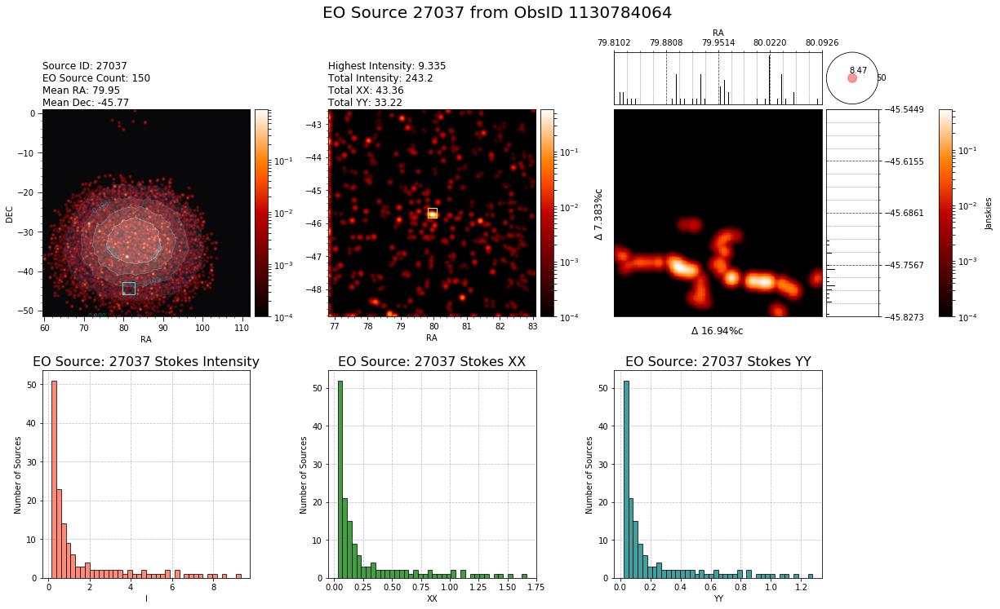

None
229


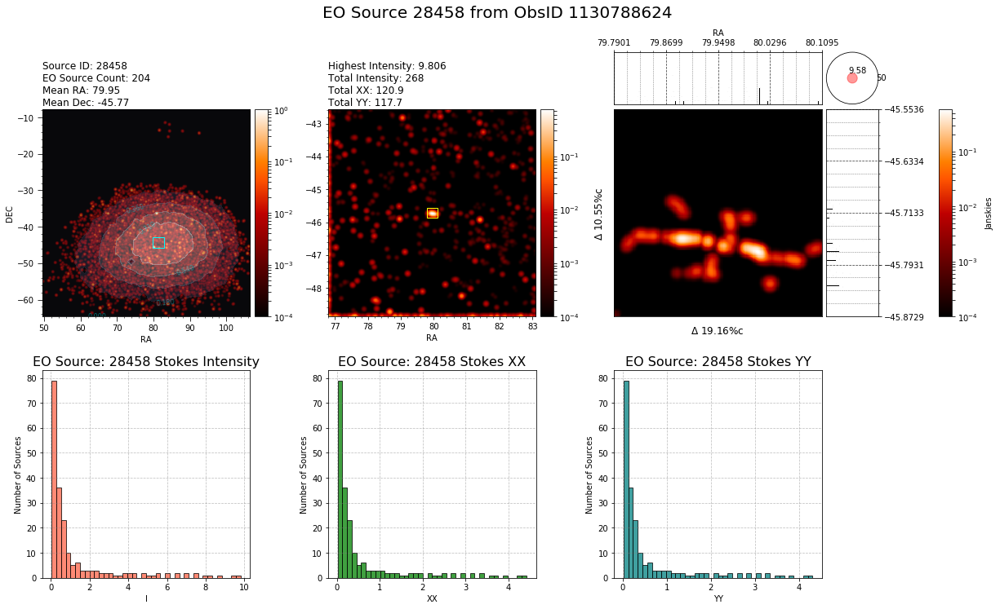

None
match 1
132


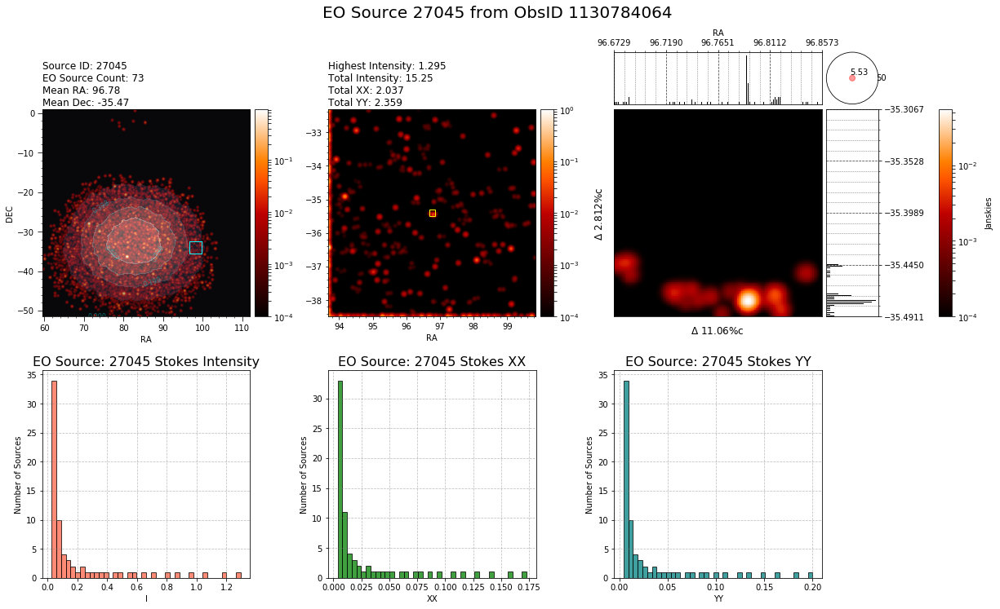

None
97


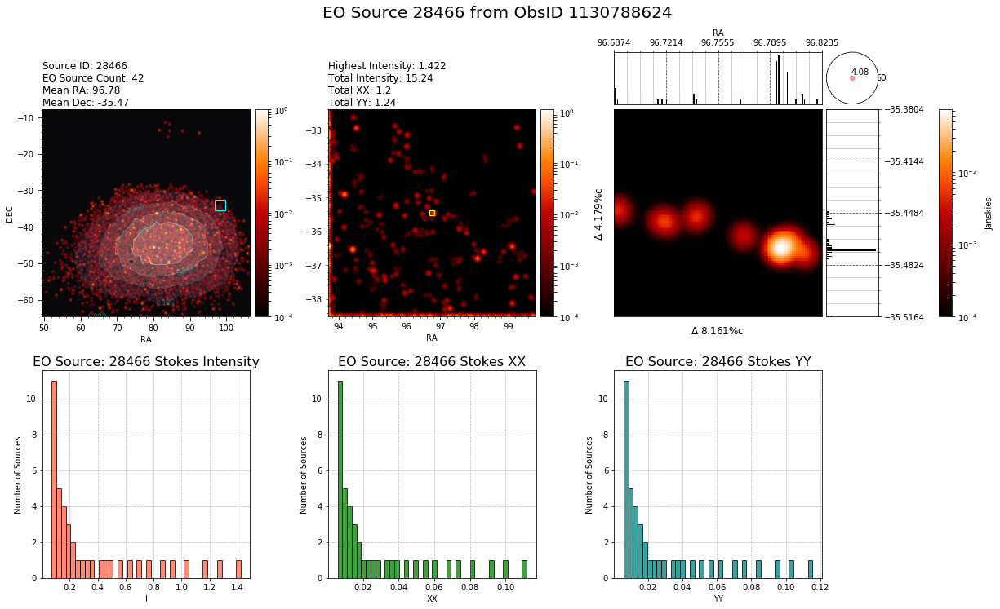

None
match 2
161


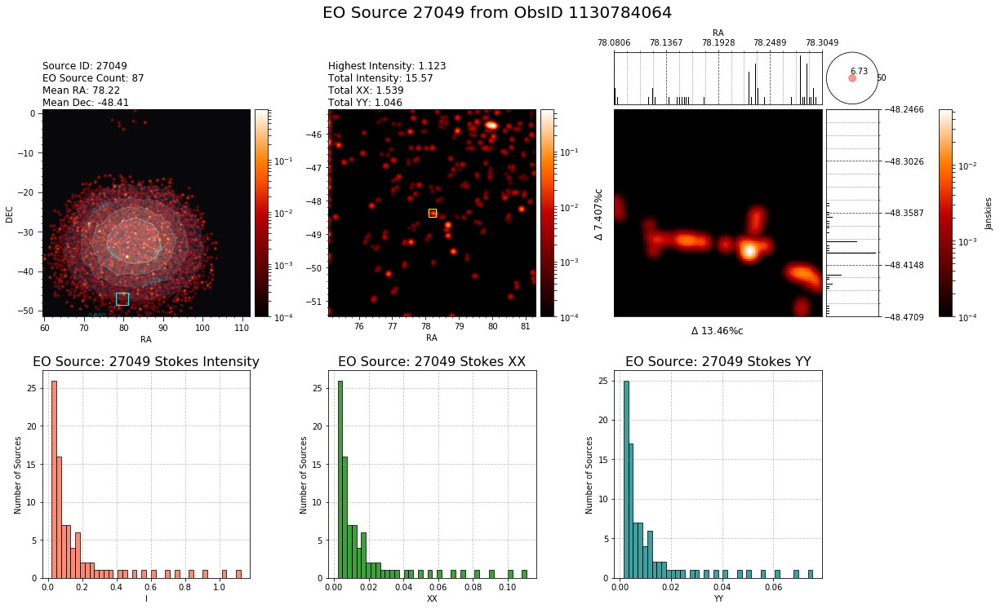

None
136


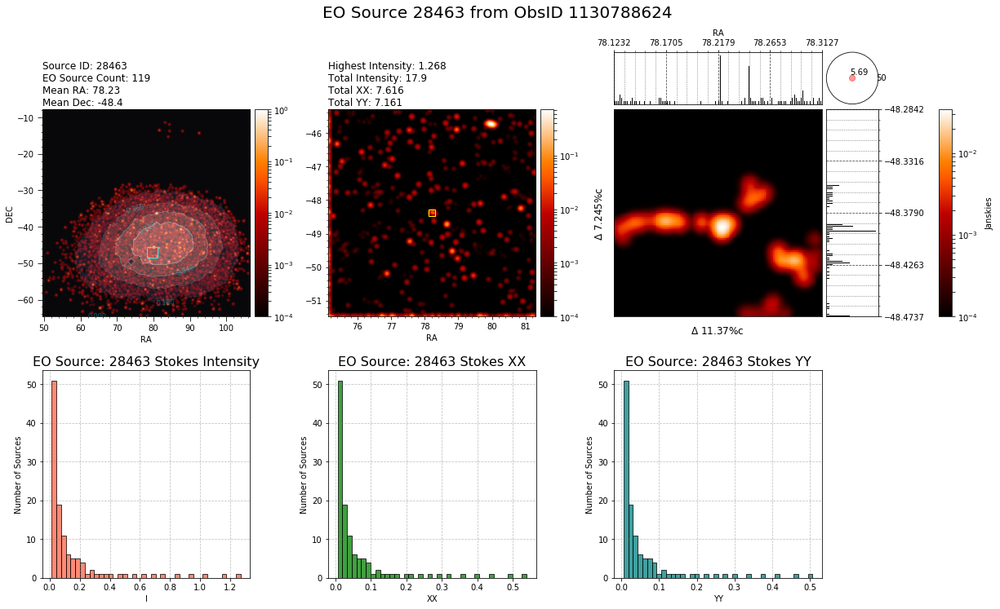

None
match 3
86


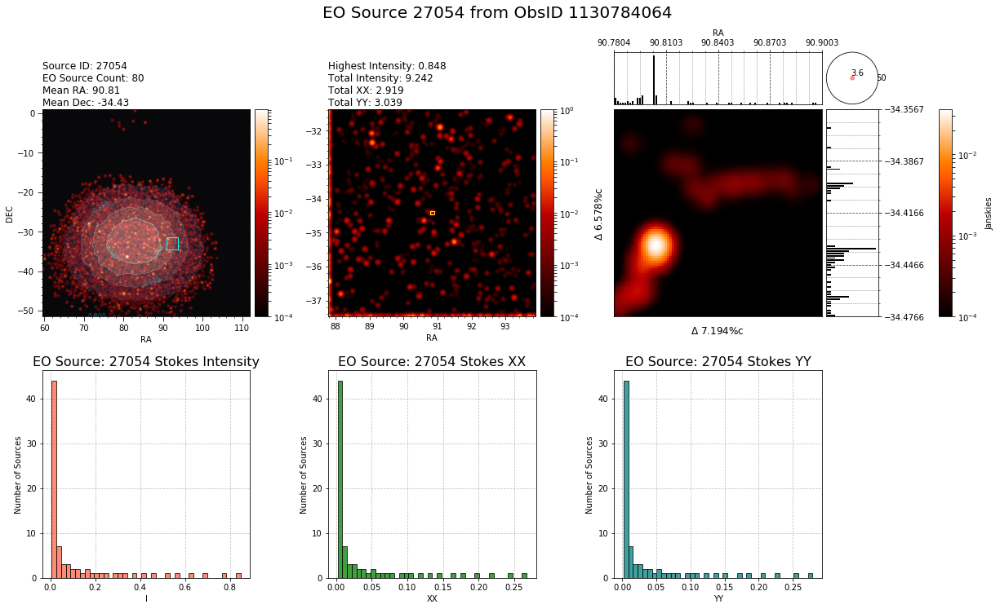

None
57


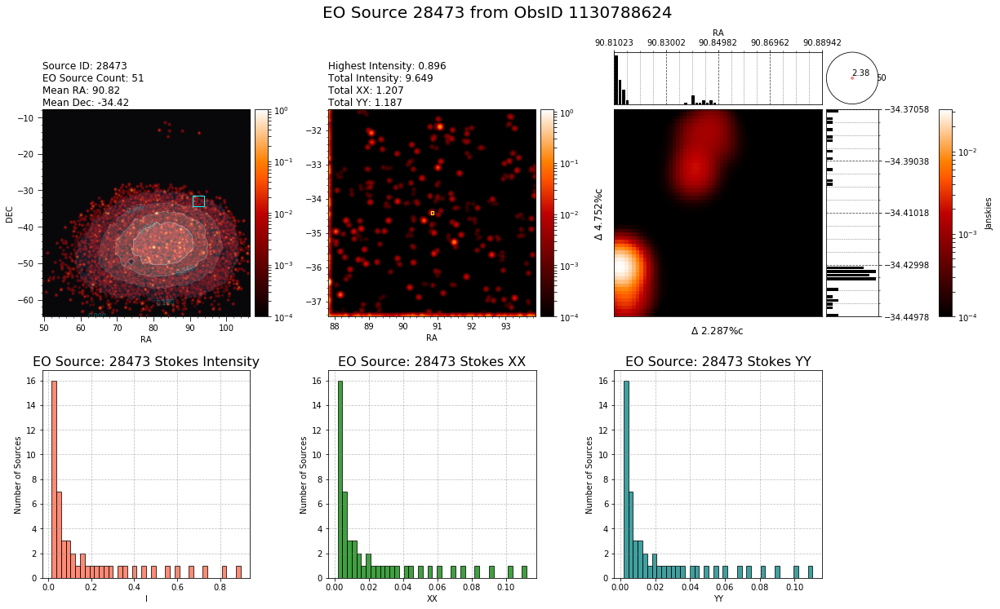

None
match 4
121


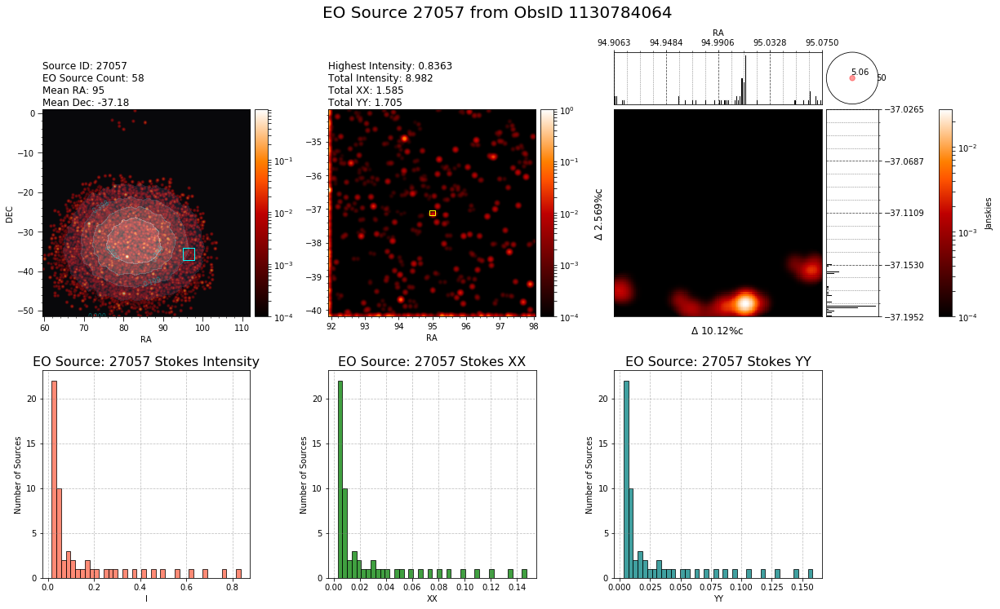

None
122


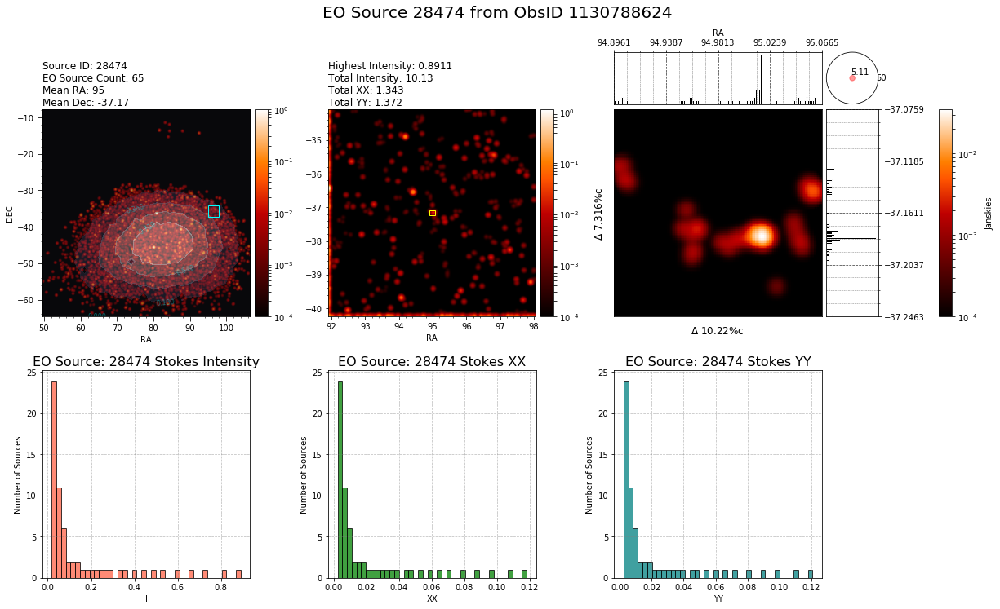

None
match 5
338


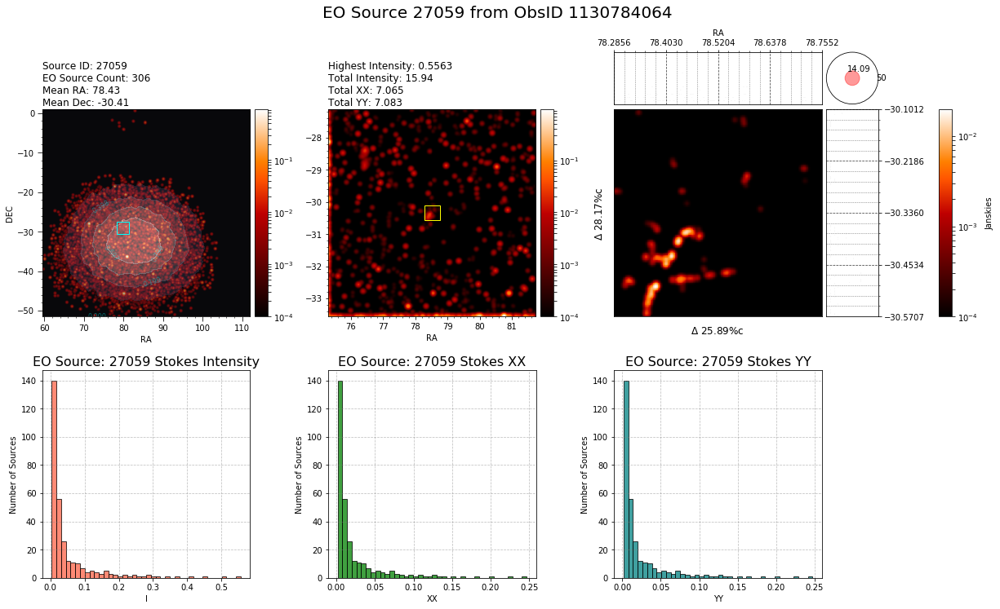

None
176


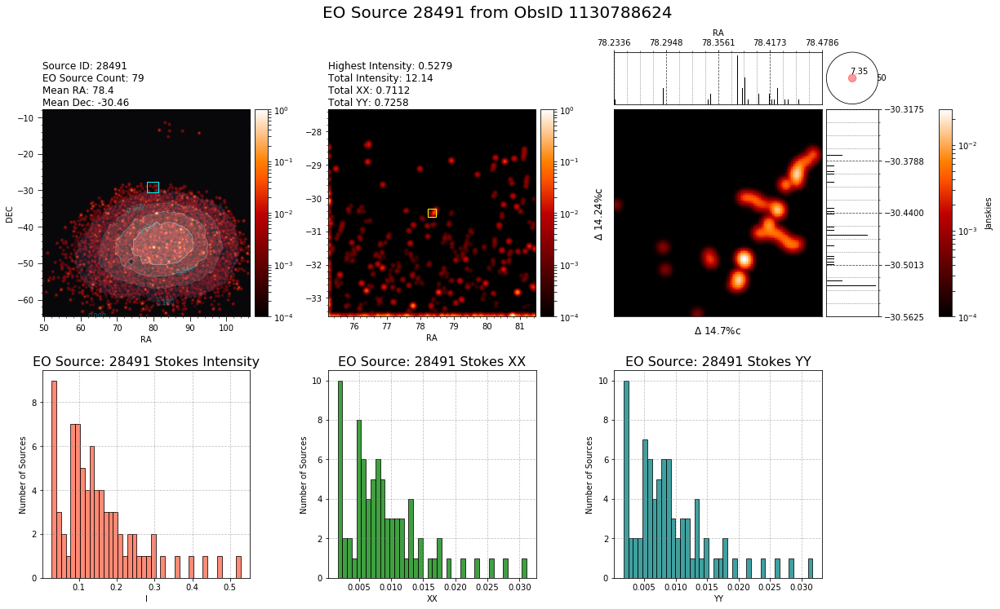

None
match 6
94


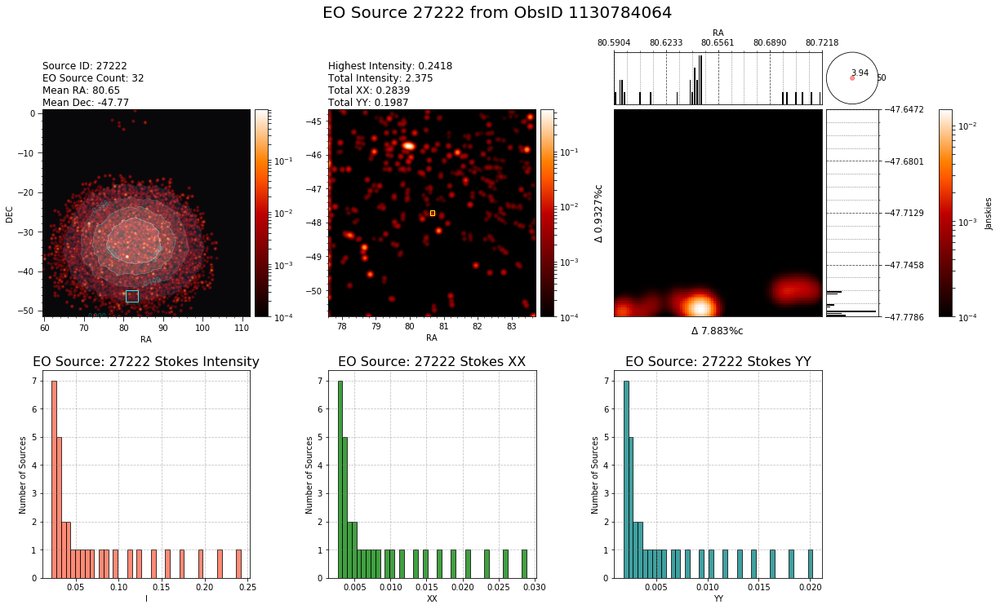

None
98


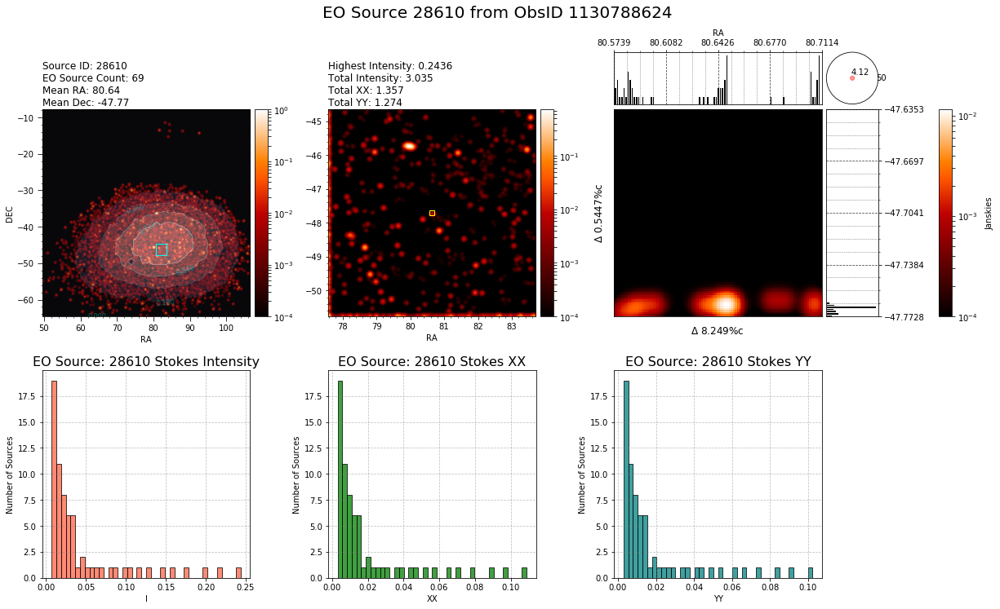

None
match 7
80


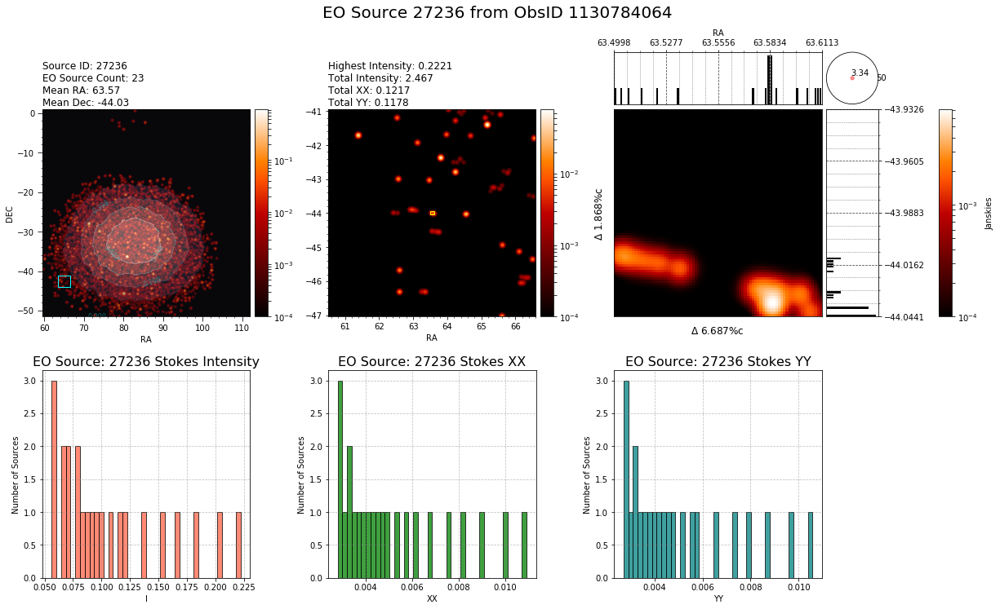

None
118


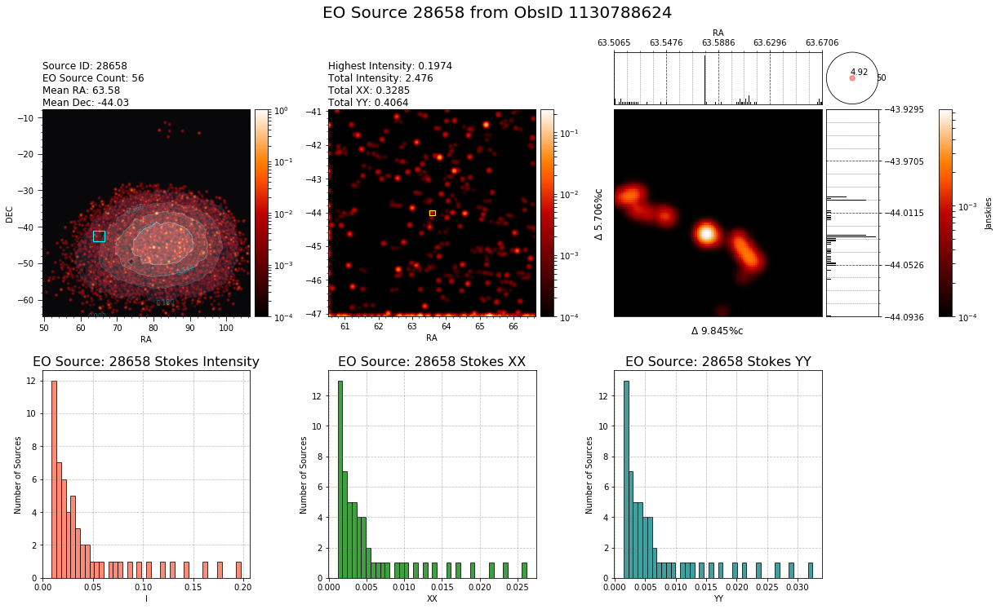

None
match 8
372


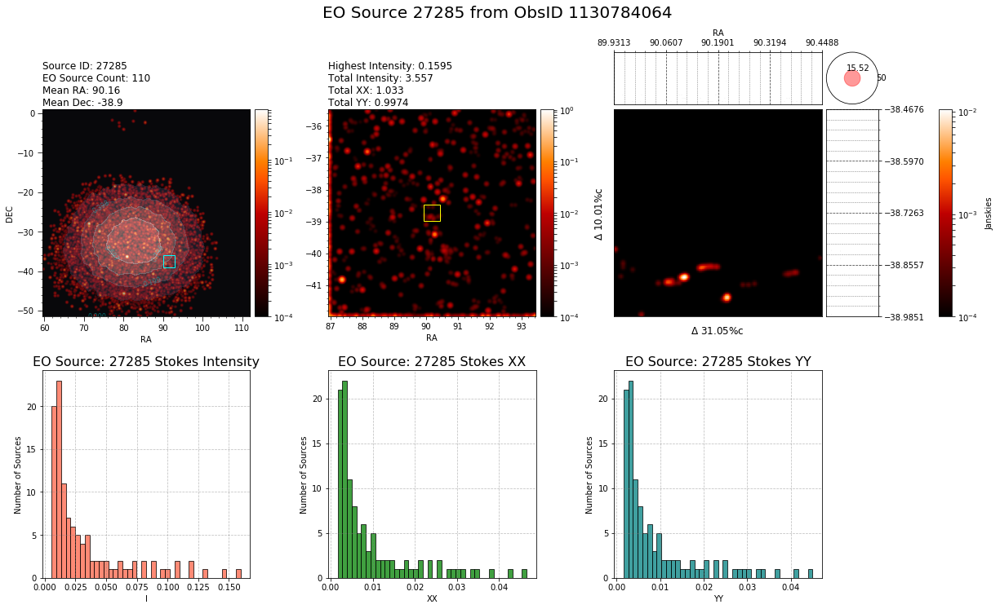

None
112


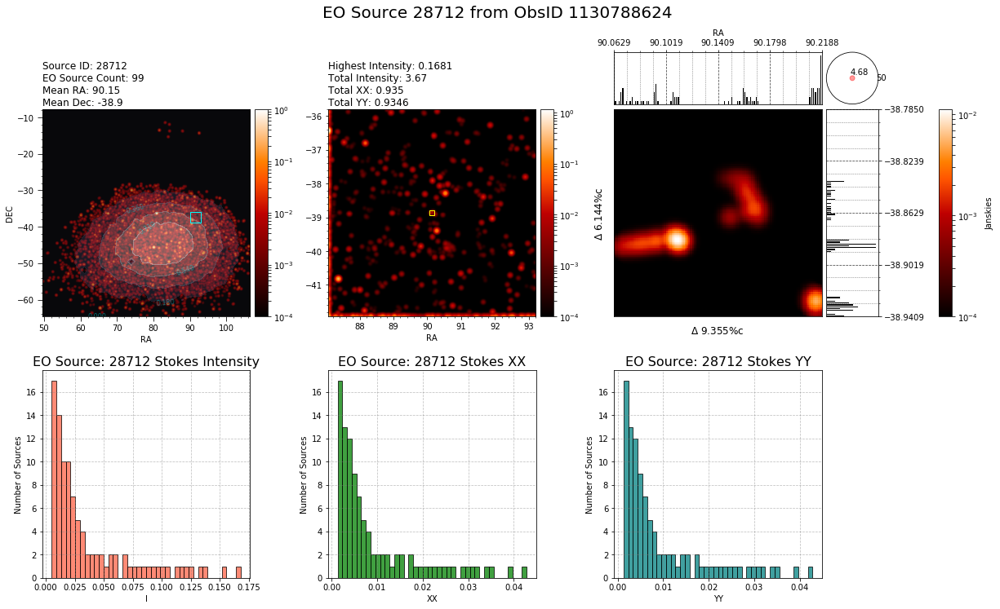

None
match 9
91


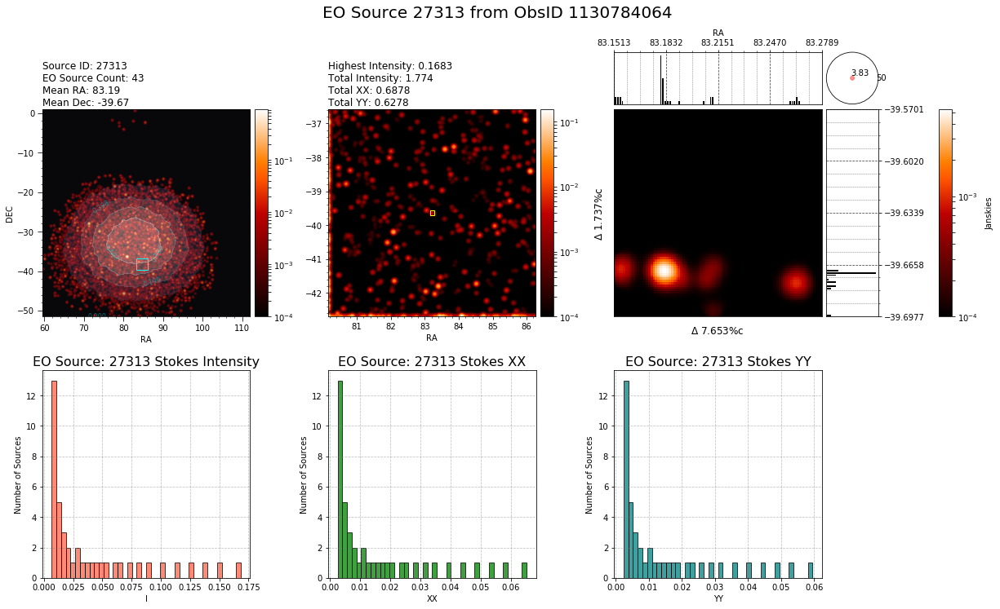

None
86


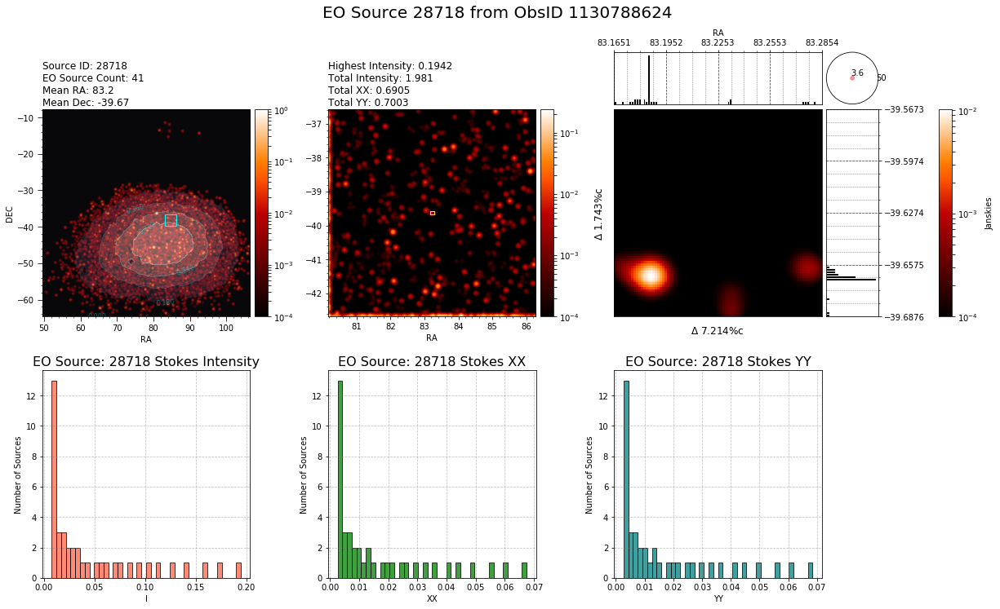

None
match 10
73


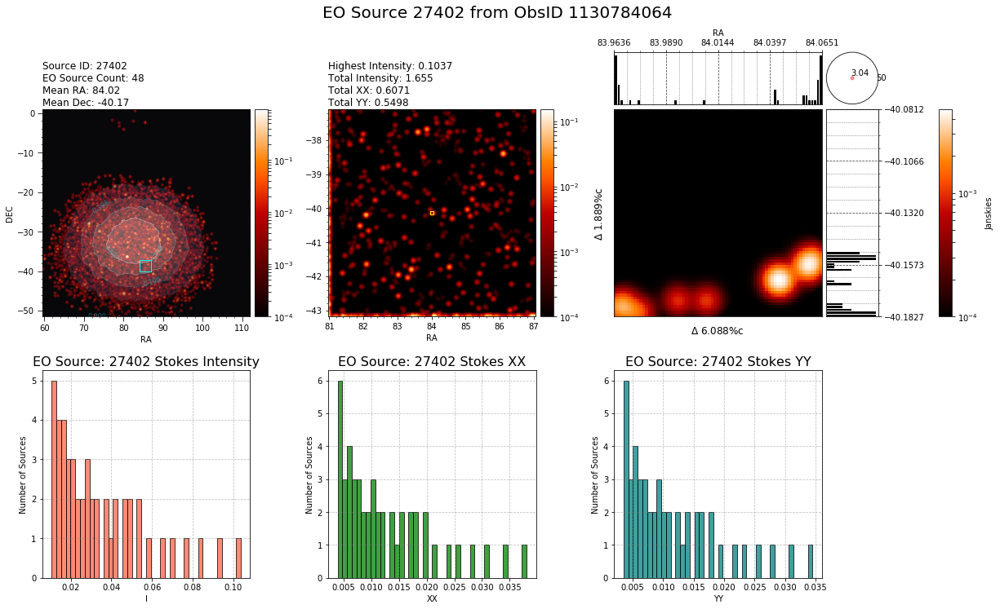

None
116


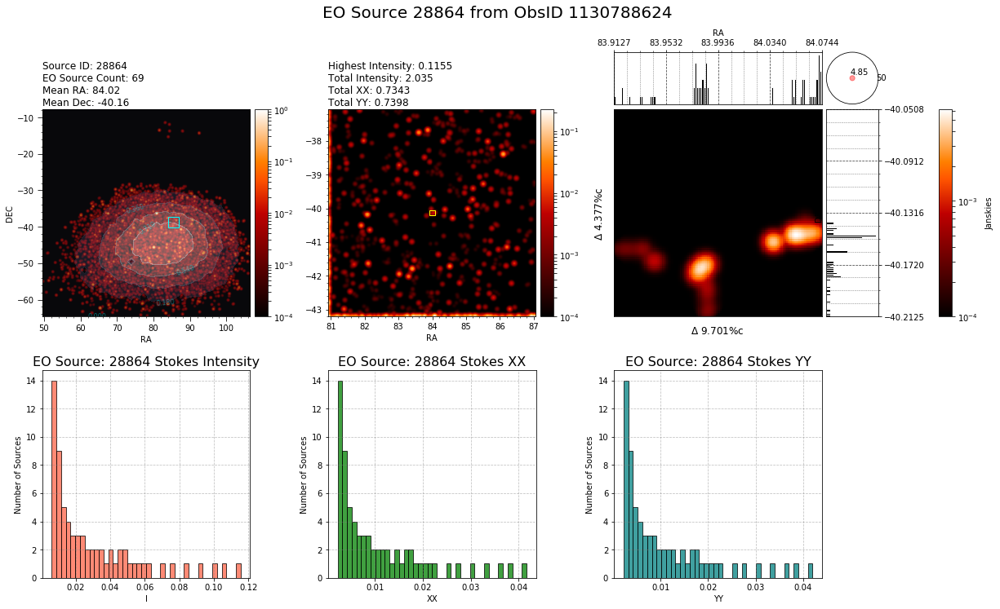

None
match 11
34


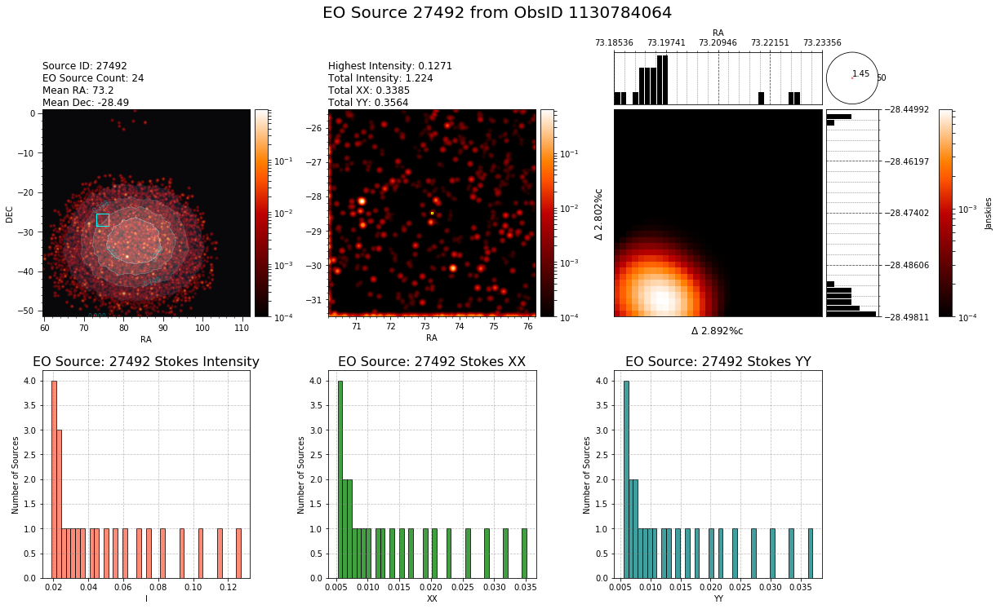

None
None
match 12
77


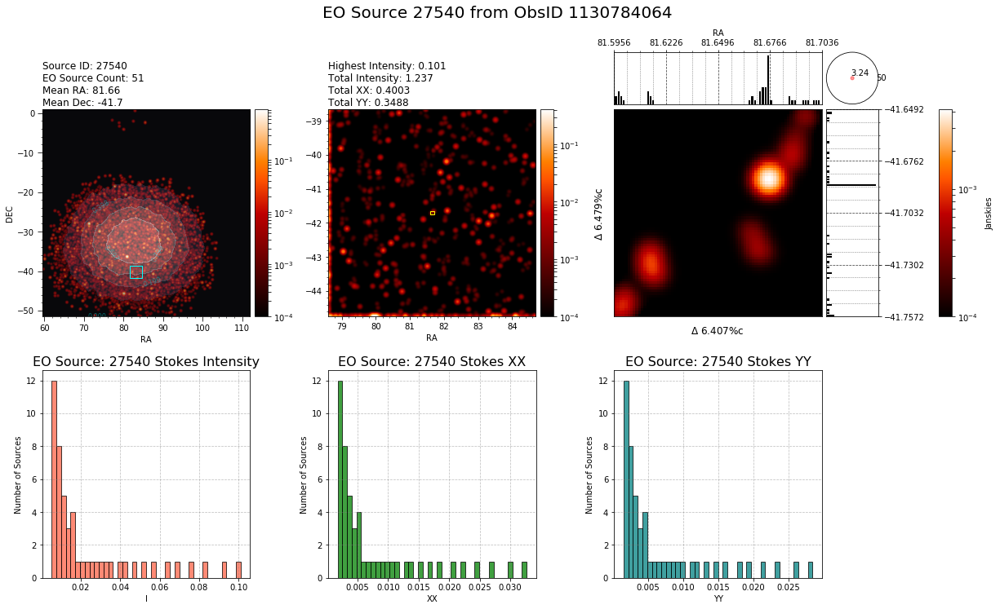

None
131


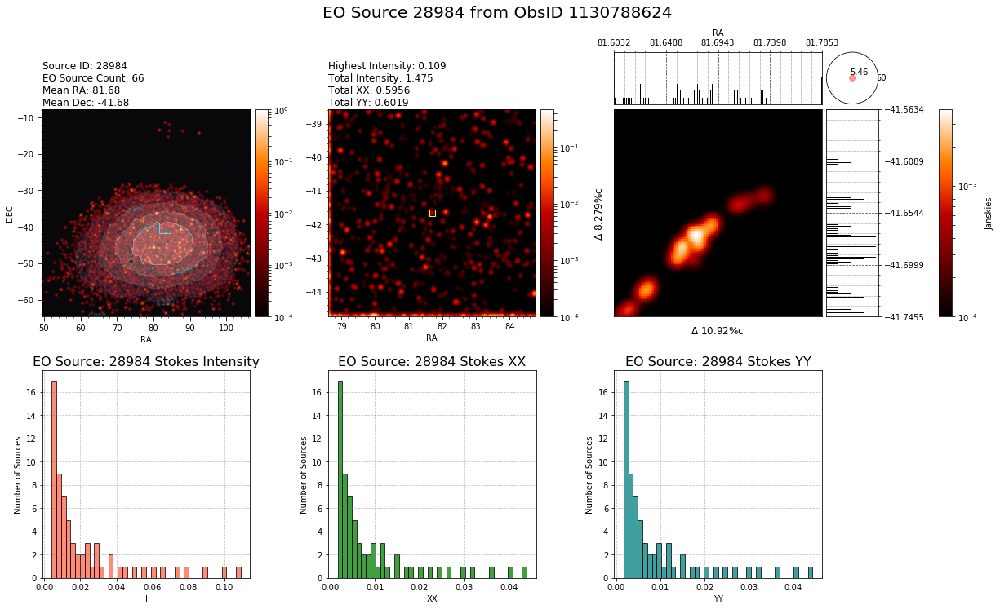

None
match 13
74


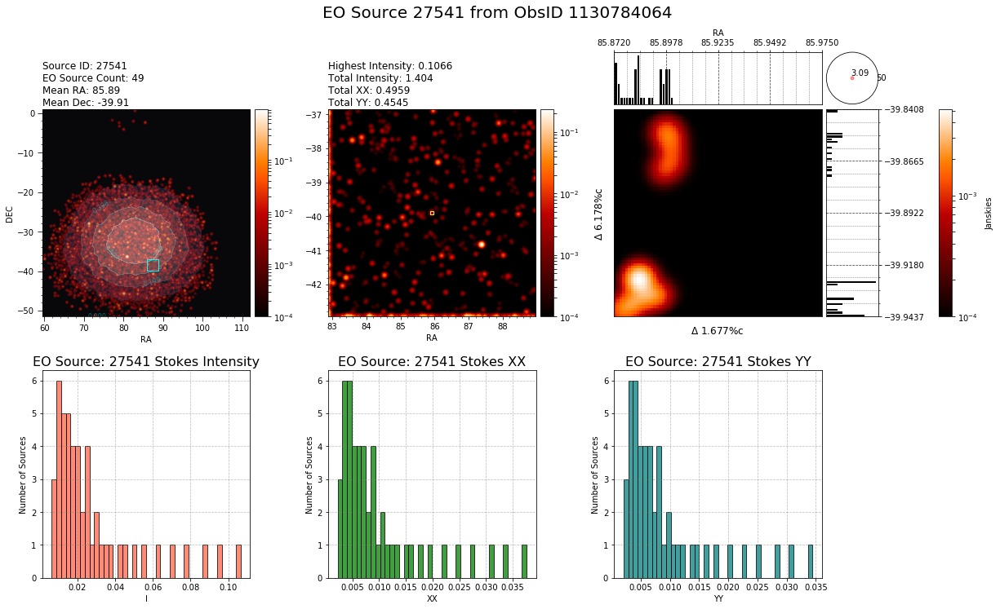

None
76


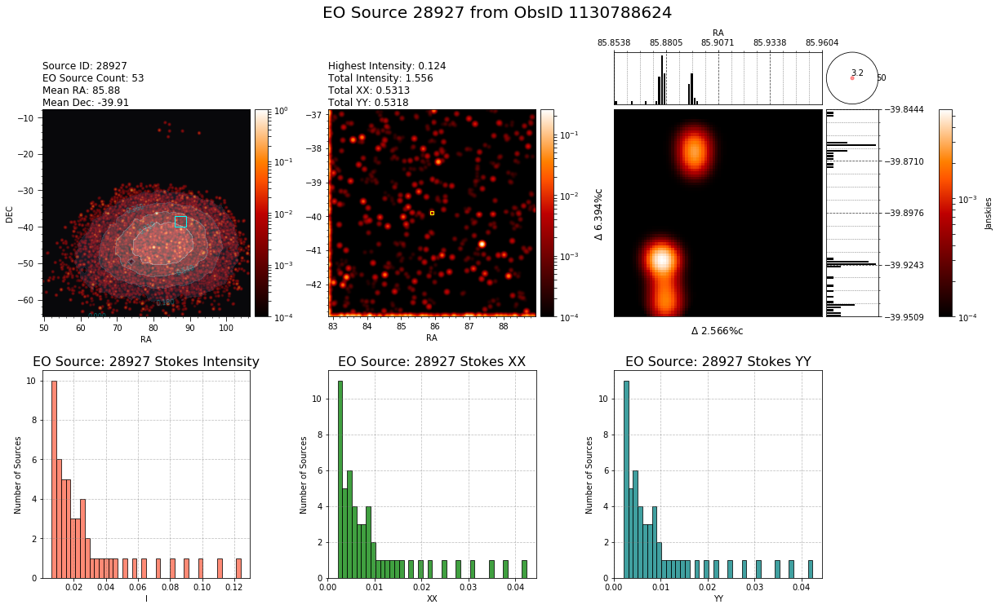

None
match 14
90


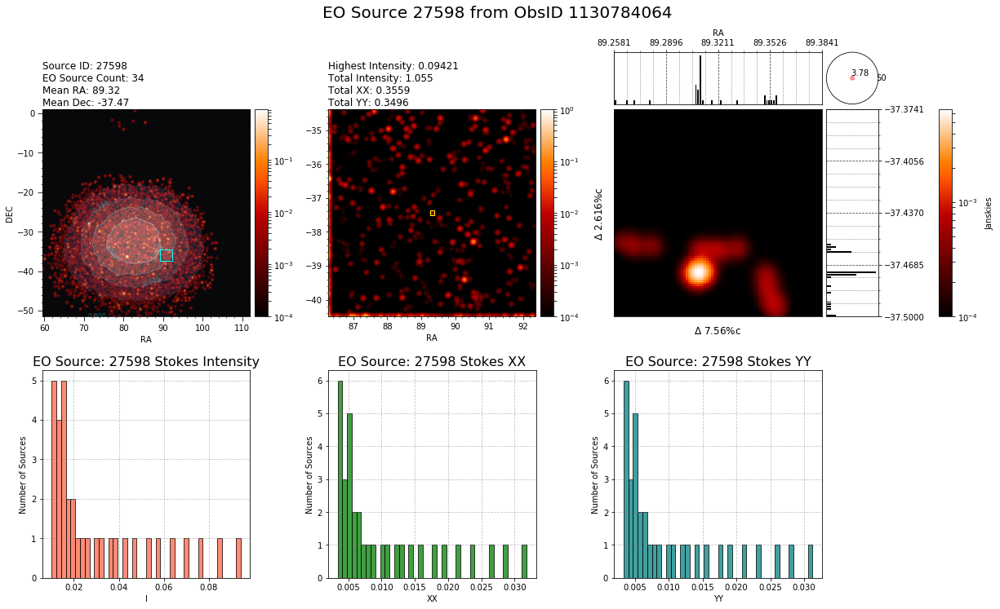

None
48


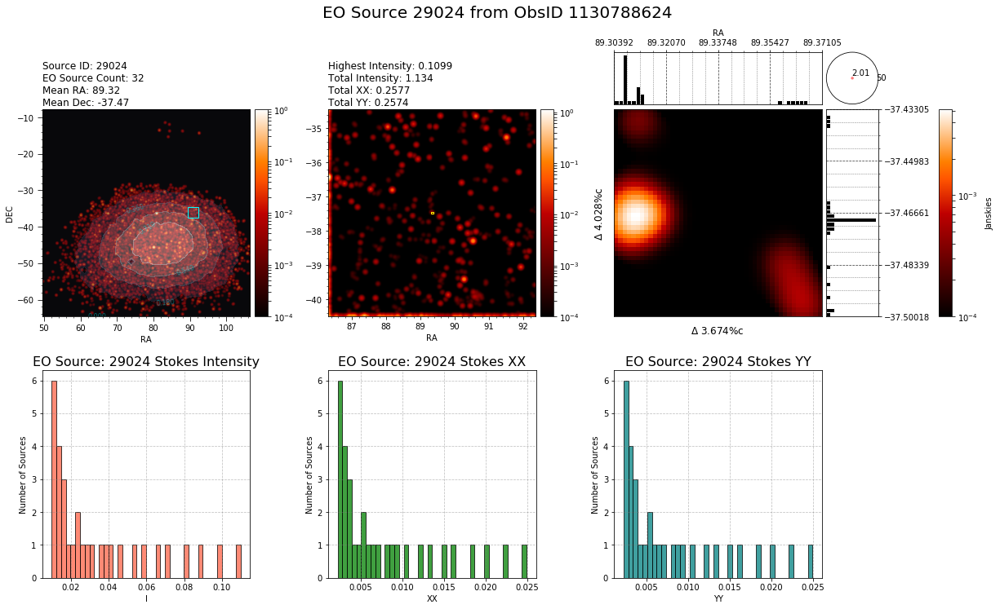

None
match 15
56


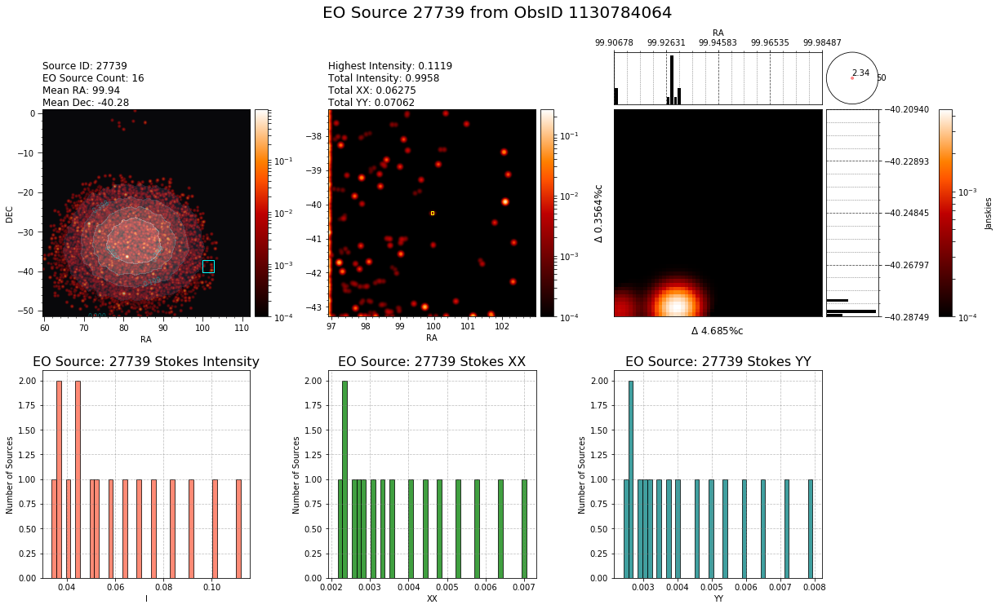

None
67


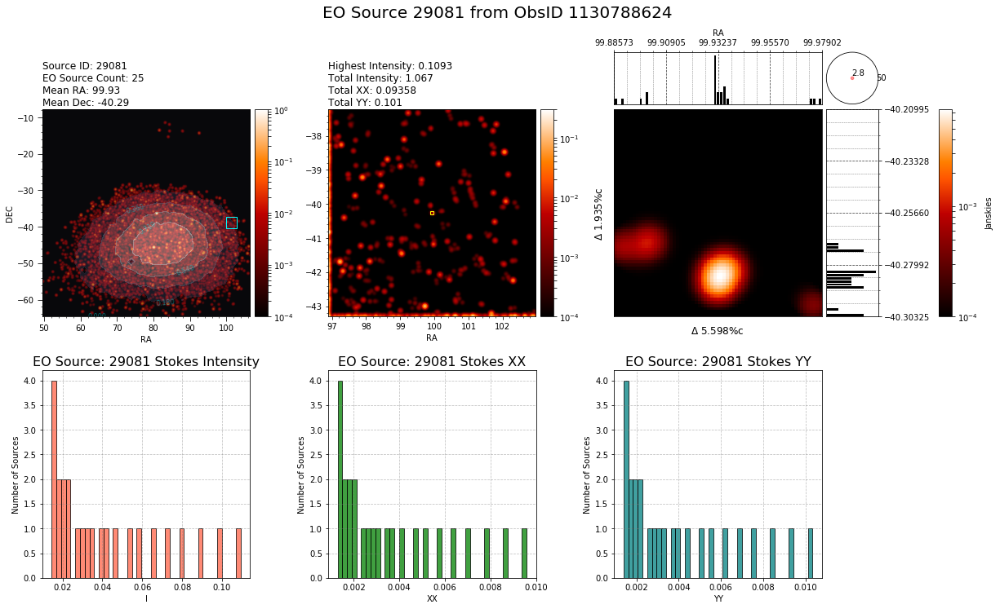

None
match 16
76


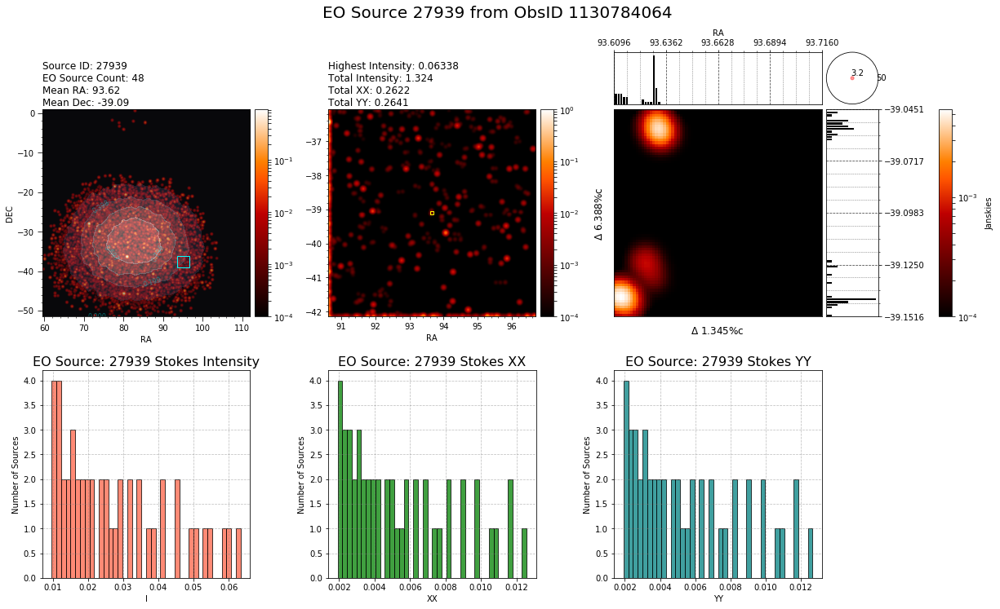

None
71


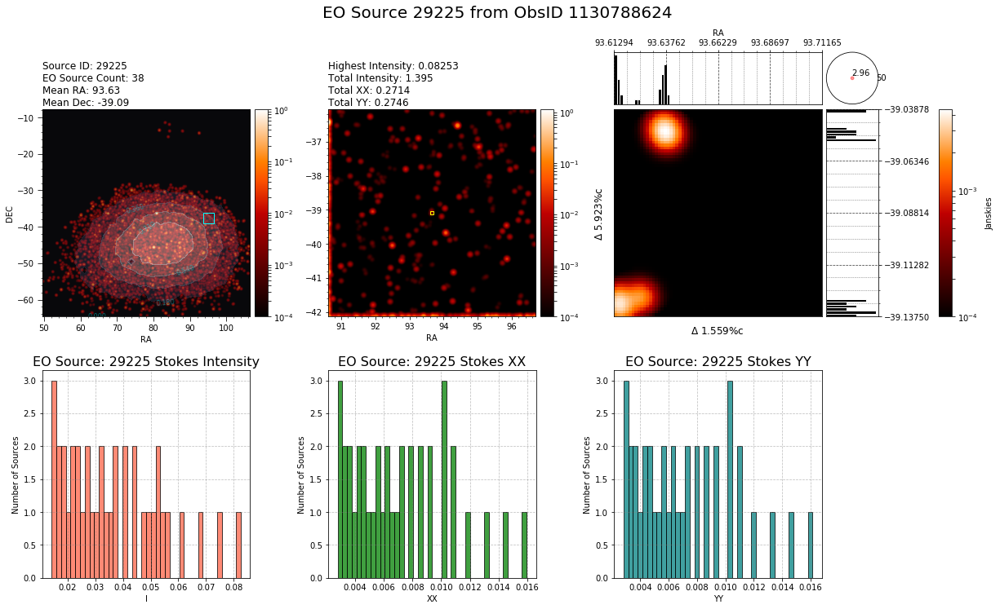

None
match 17
74


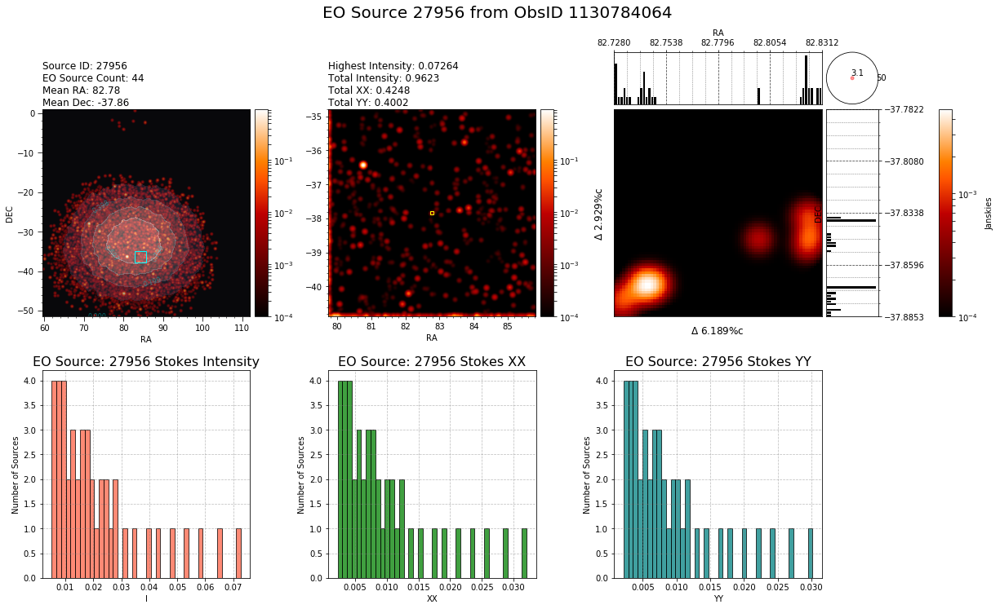

None
75


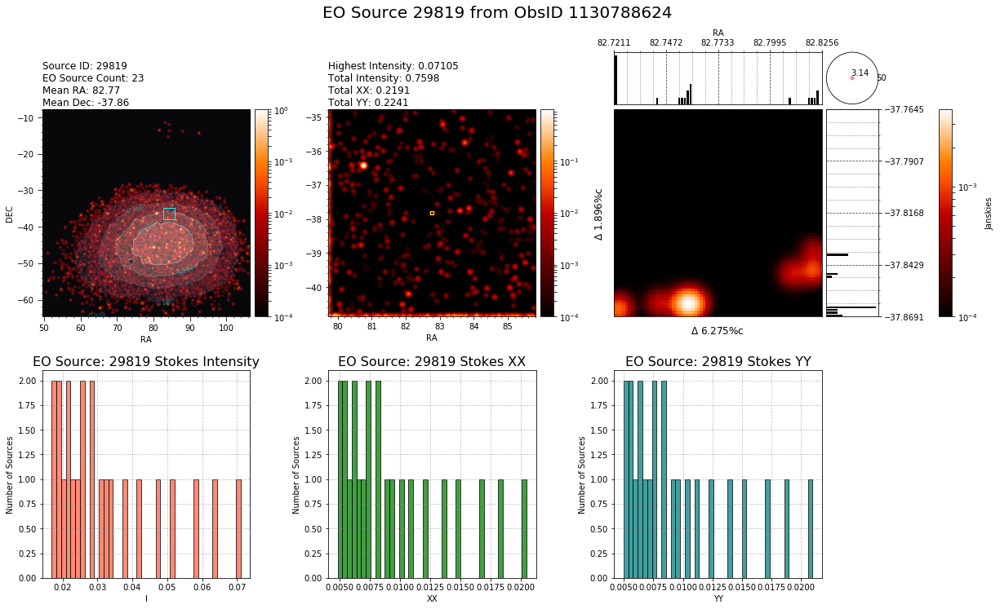

None
match 18
70


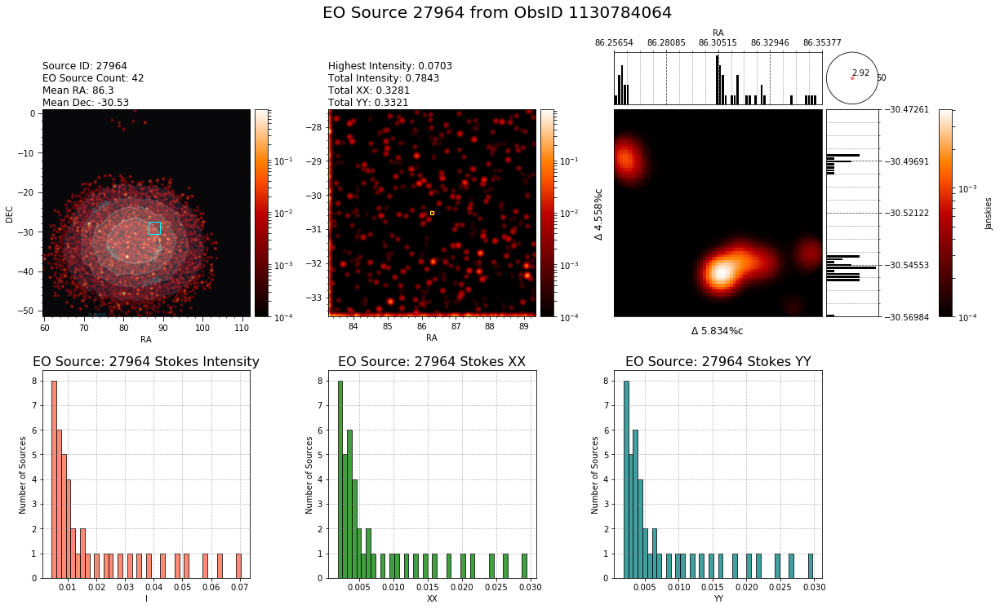

None
67


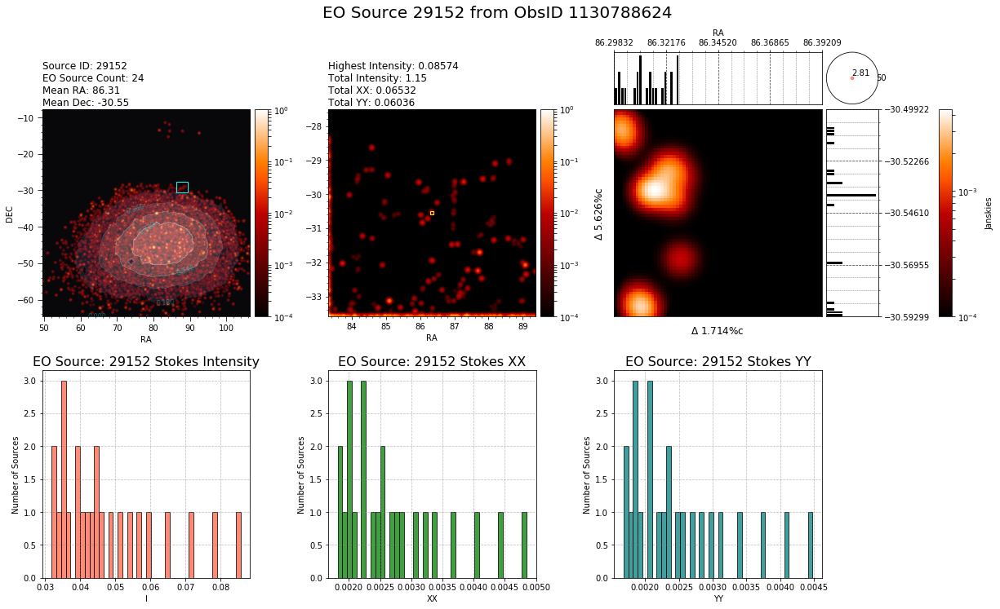

None
match 19
45


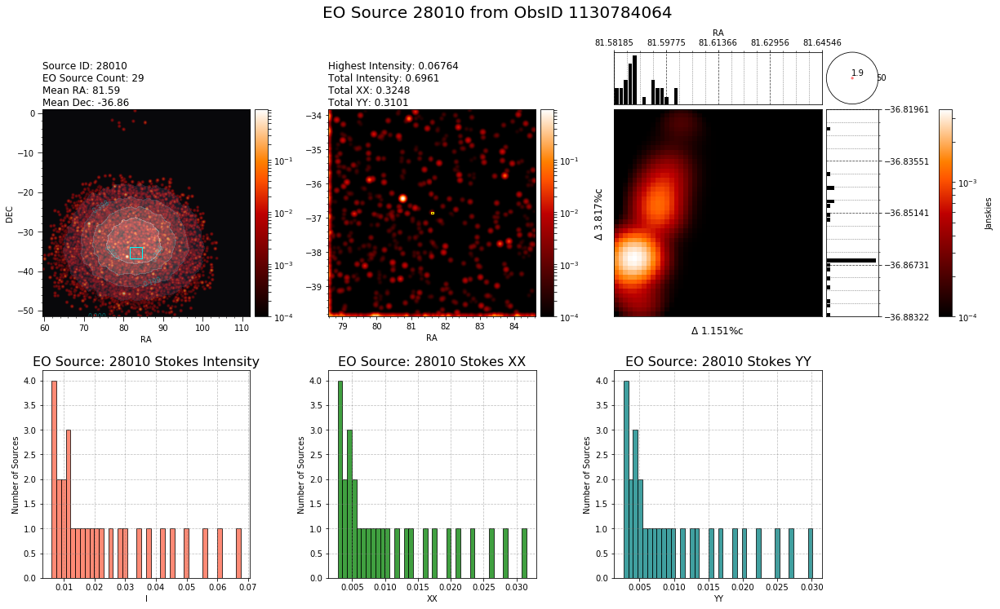

None
92


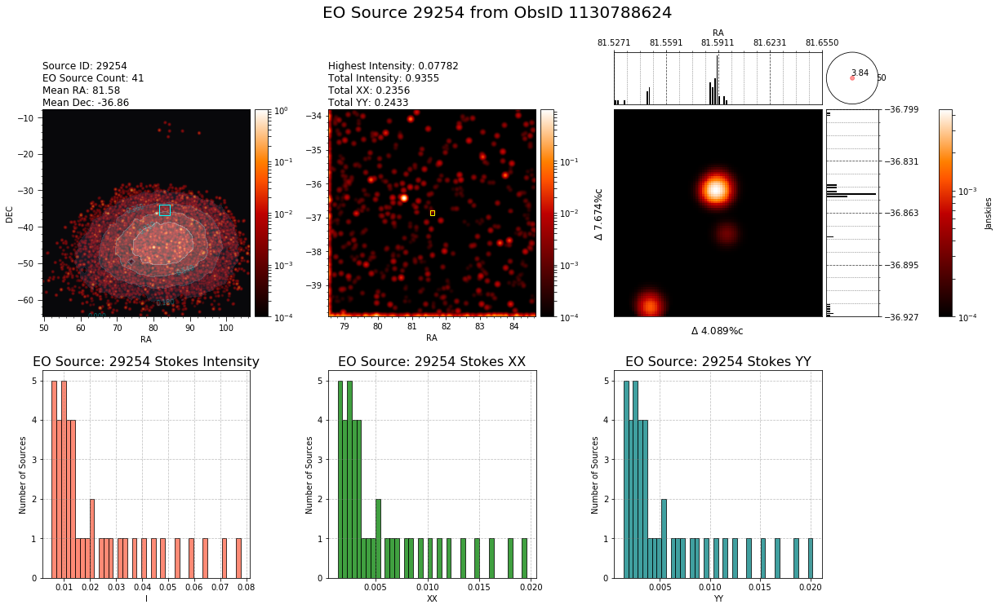

None
match 20
124


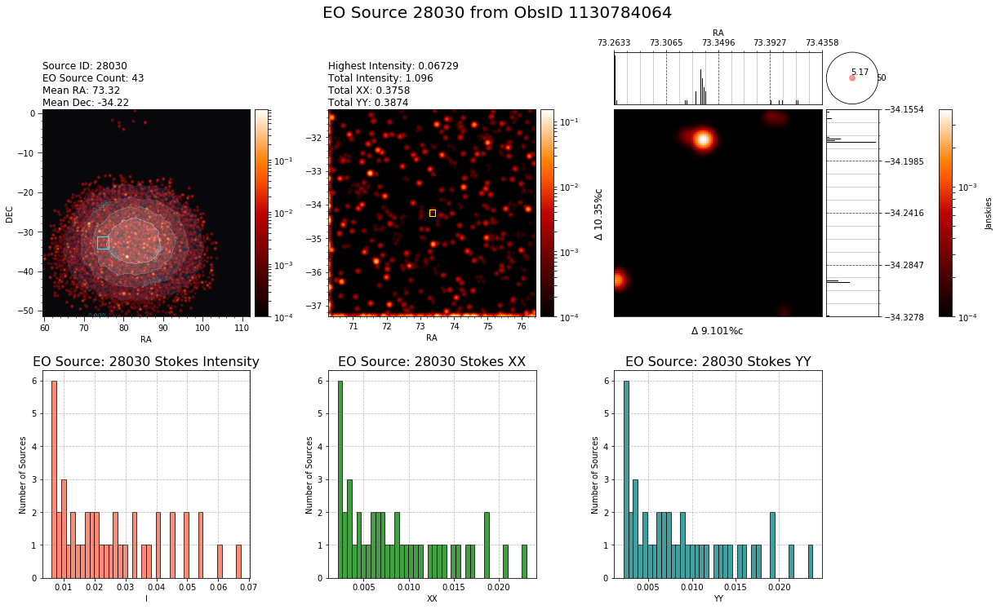

None
156


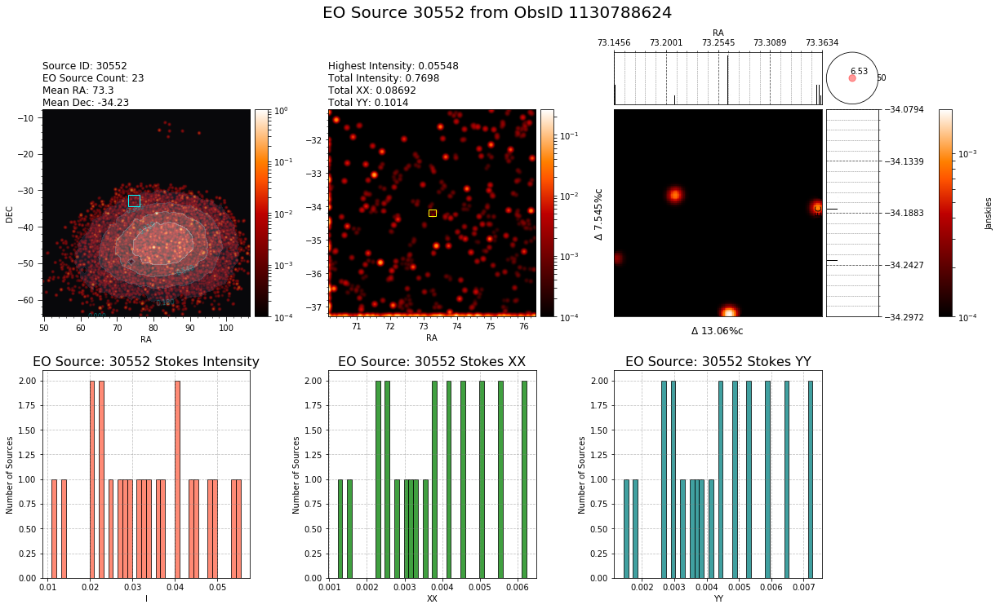

None
match 21
68


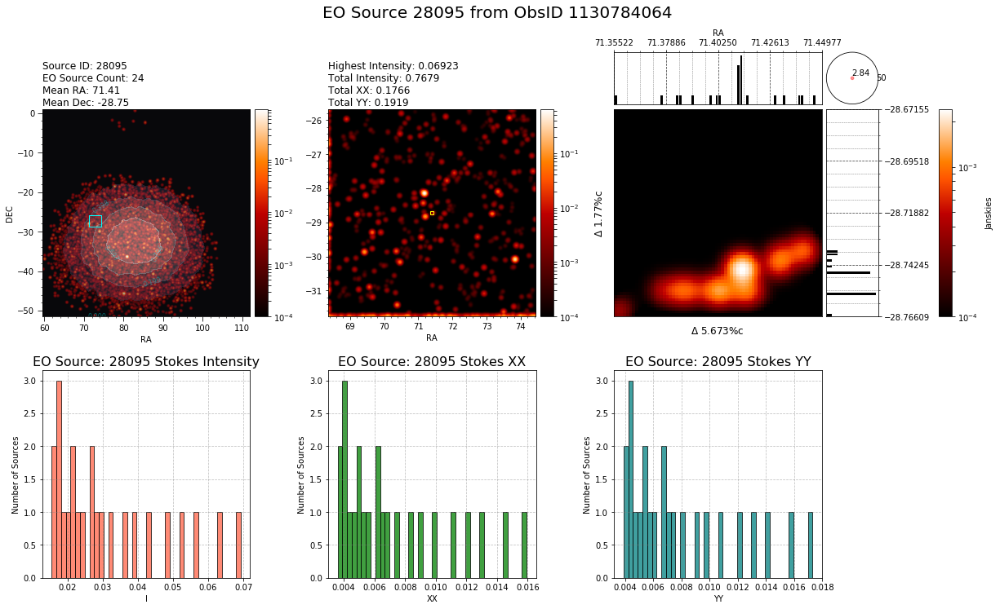

None
None
match 22
None
99


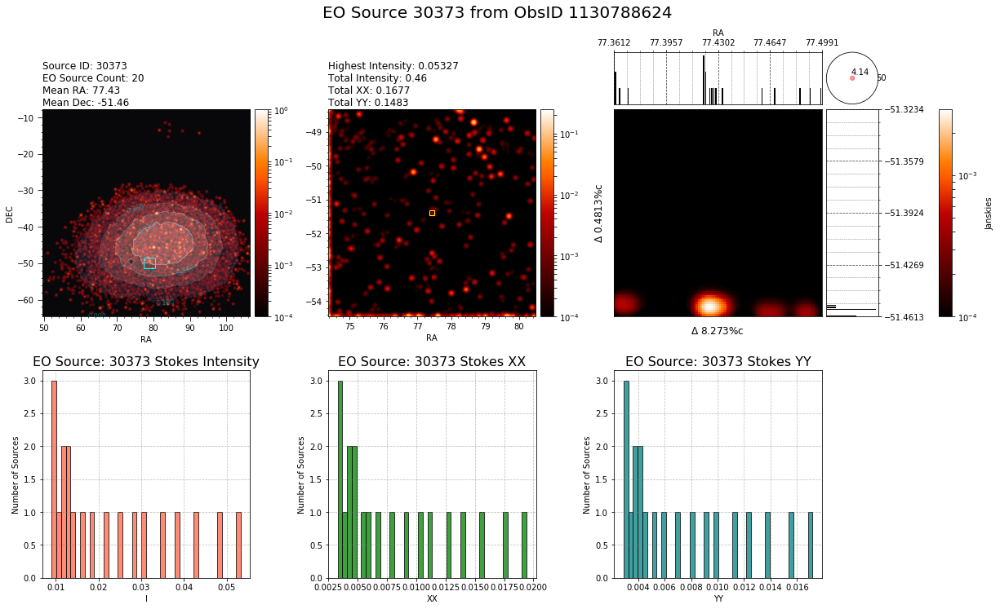

None
match 23
77


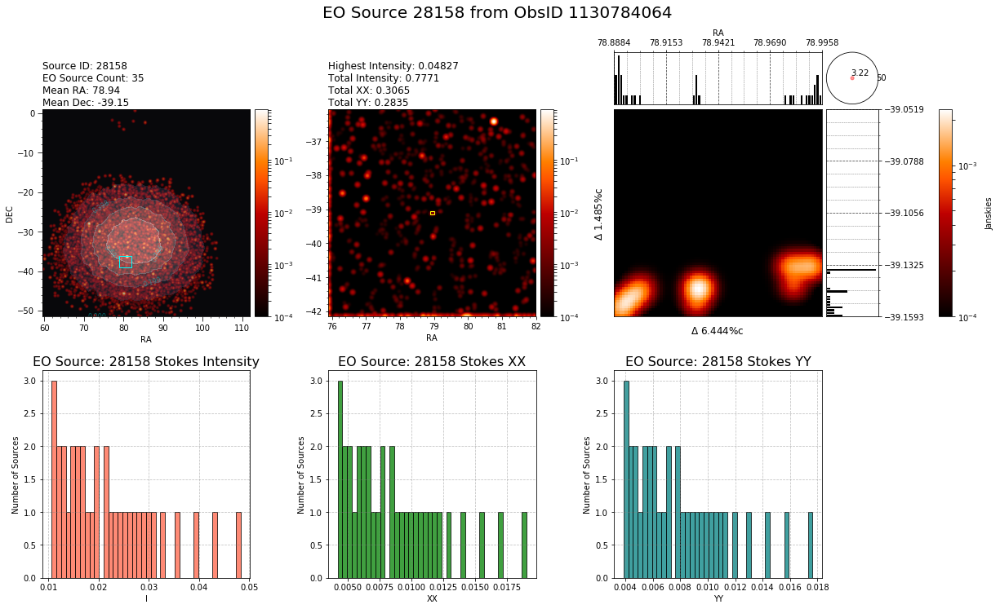

None
91


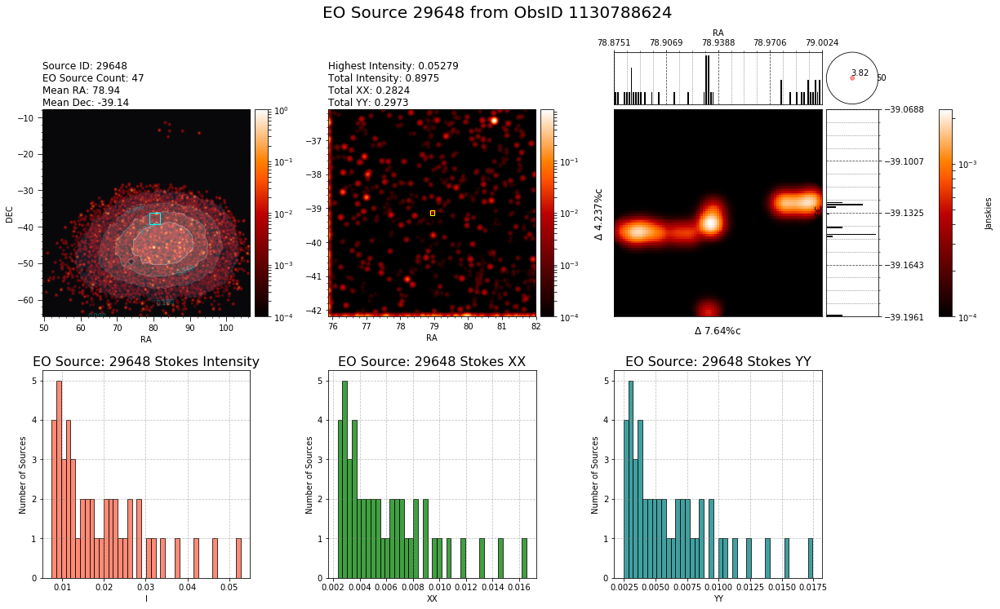

None
match 24
61


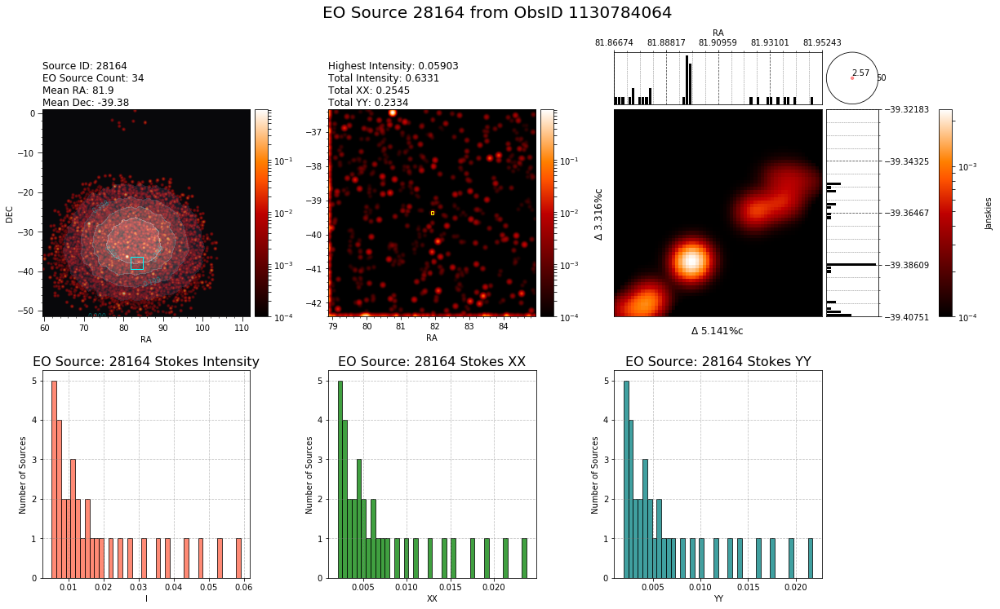

None
83


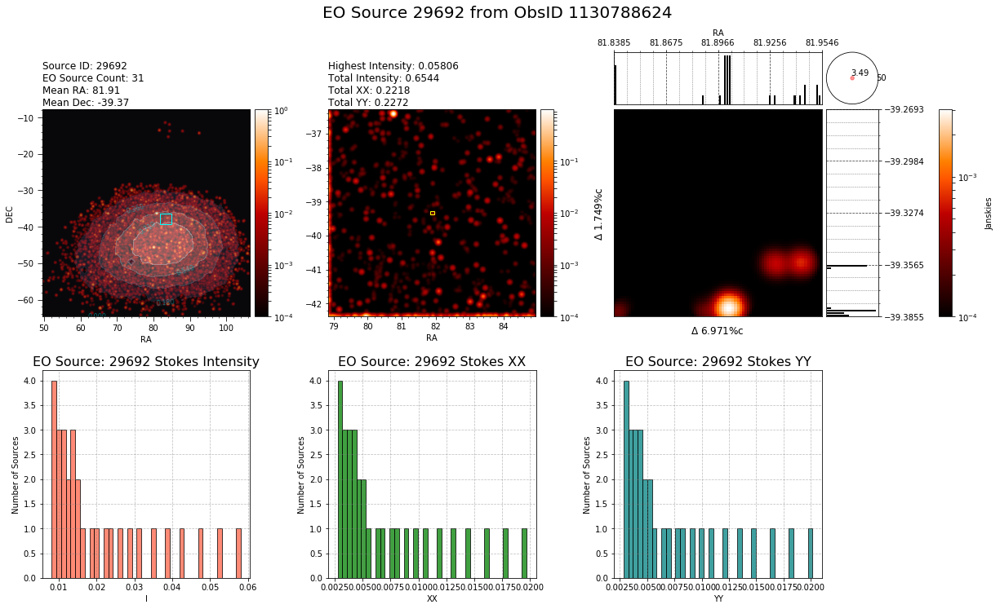

None
match 25
80


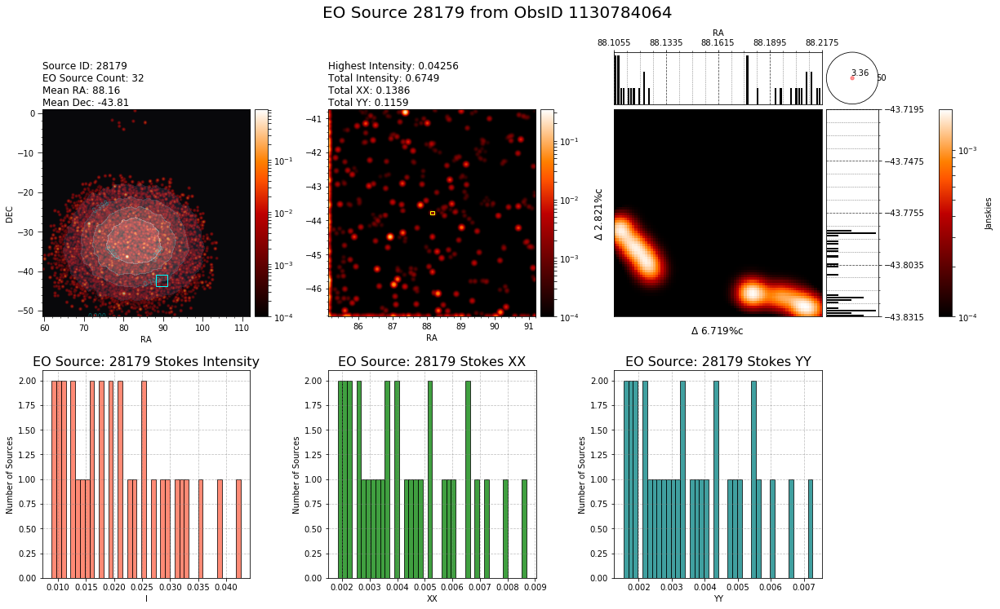

None
153


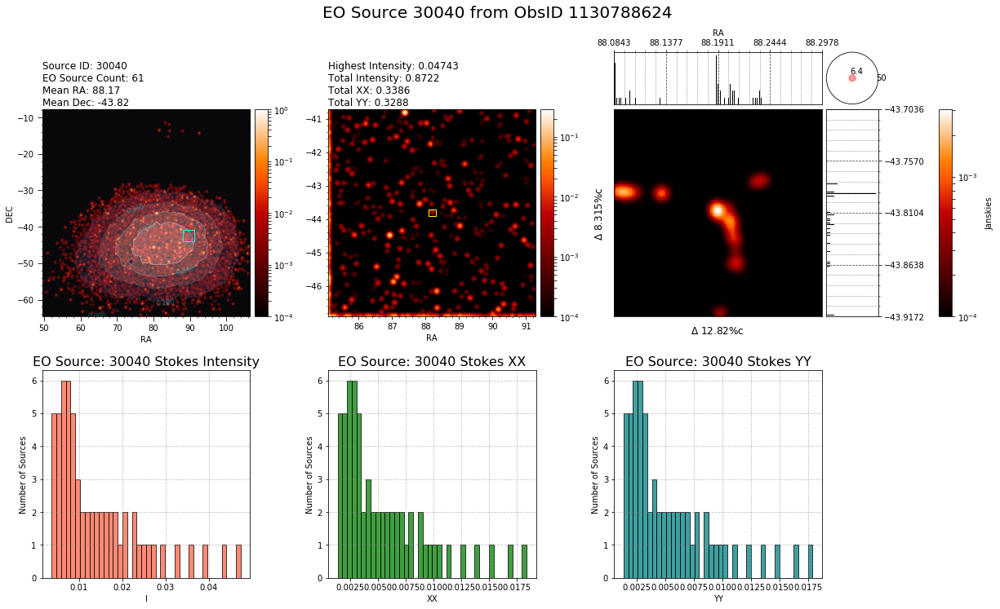

None
match 26
69


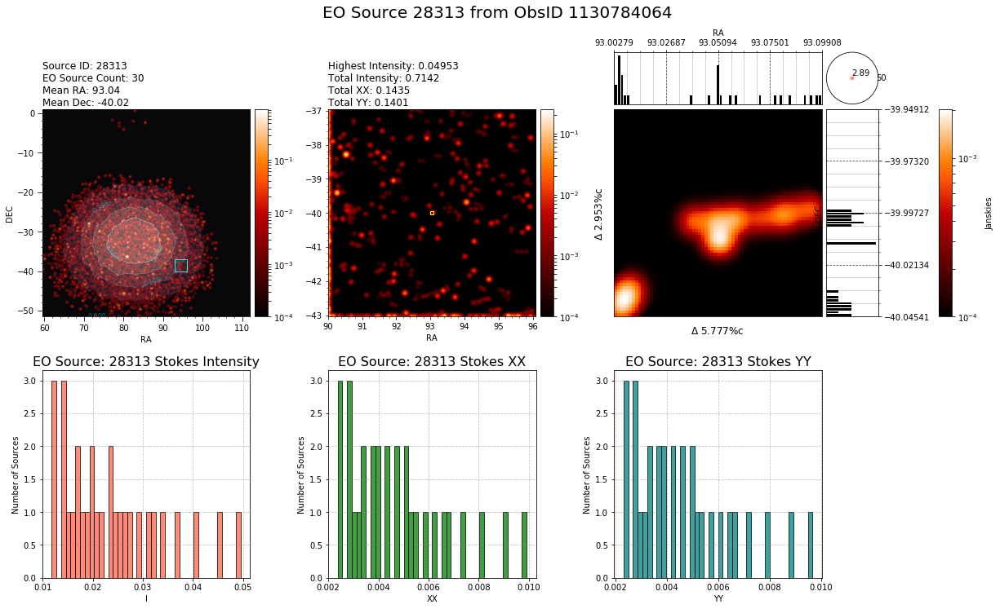

None
59


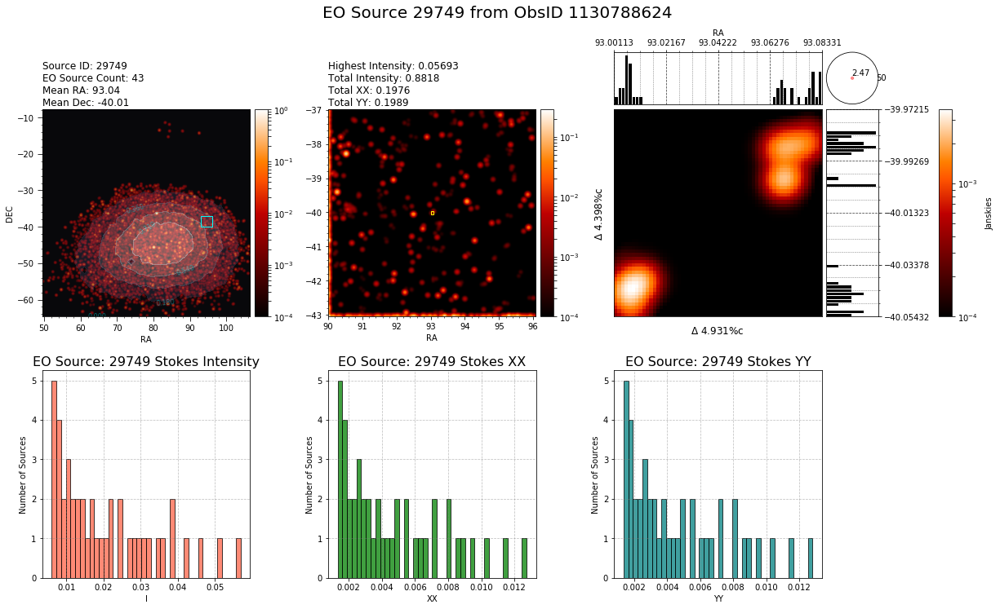

None
match 27
63


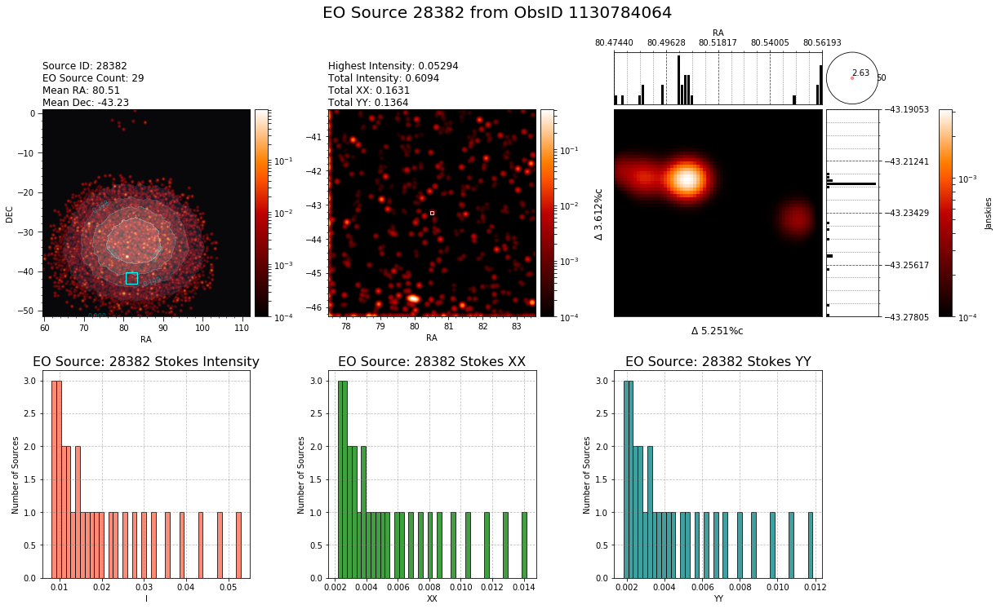

None
120


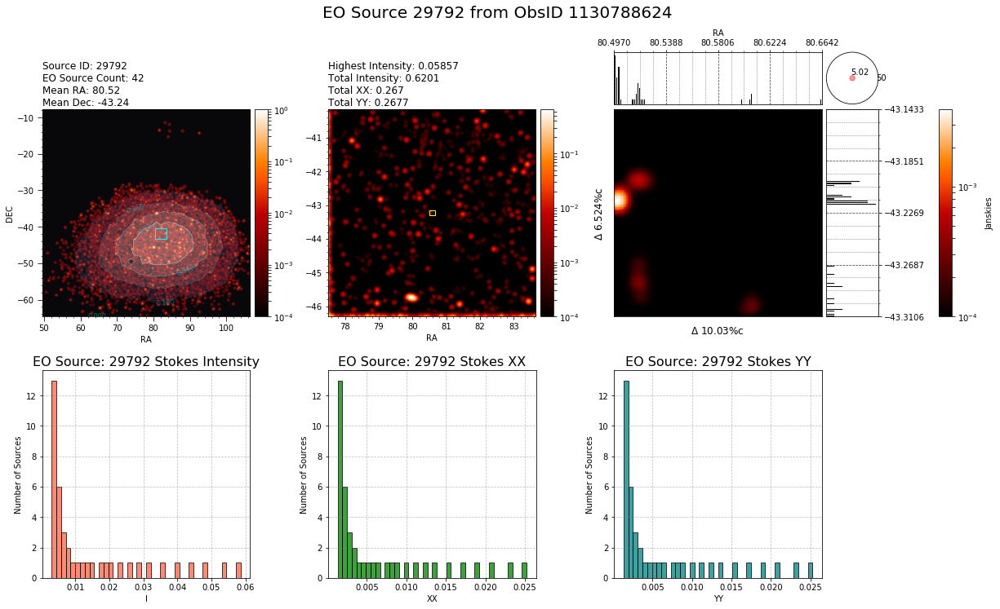

None
match 28
77


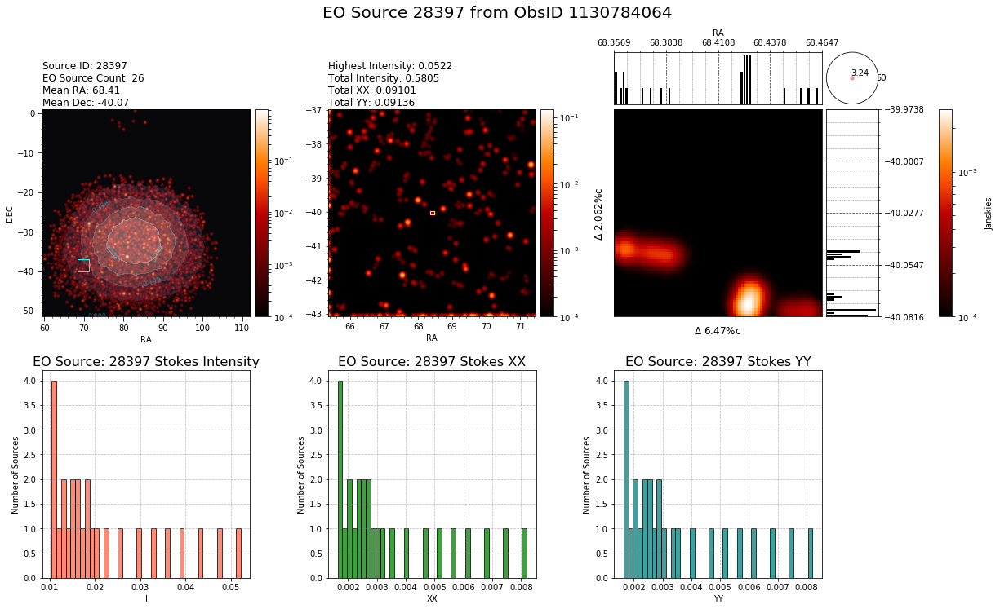

None
90


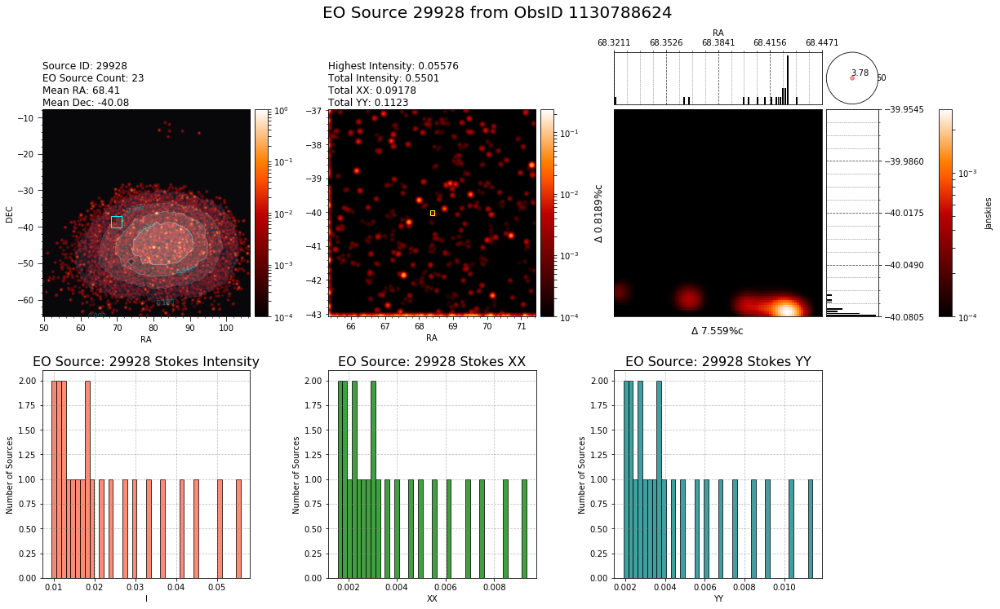

None
match 29
98


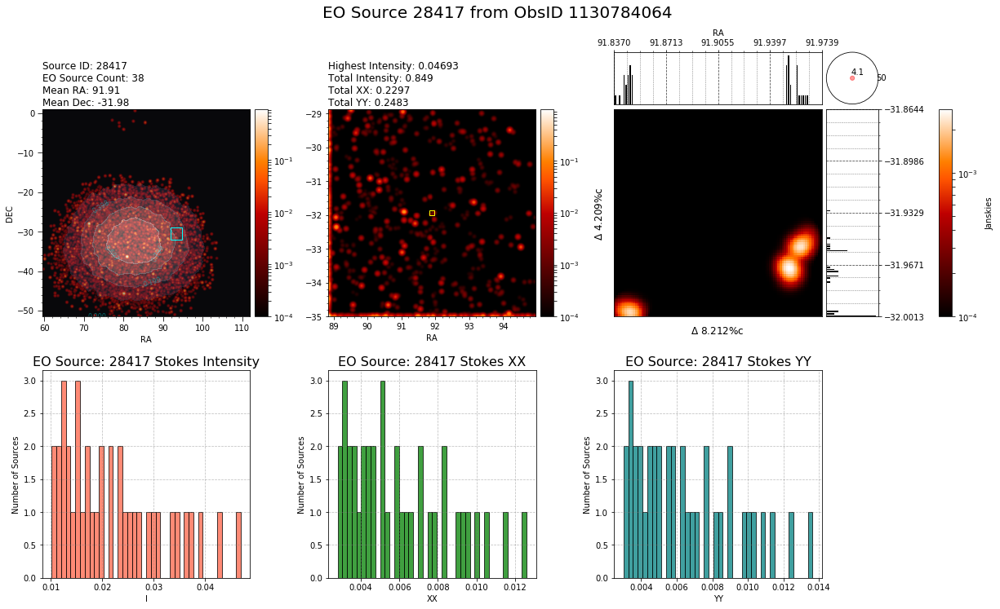

None
99


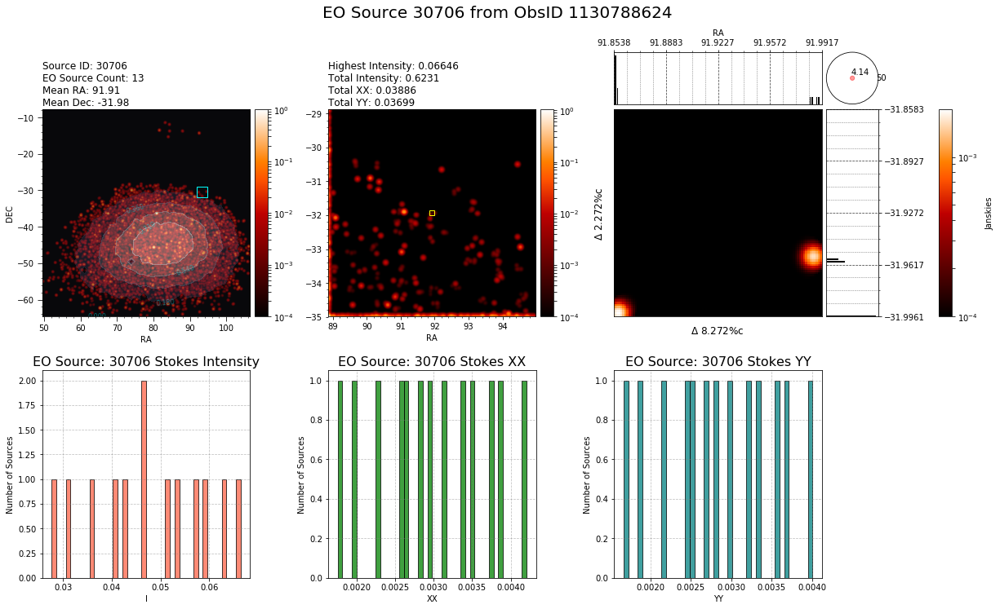

None
match 30
49


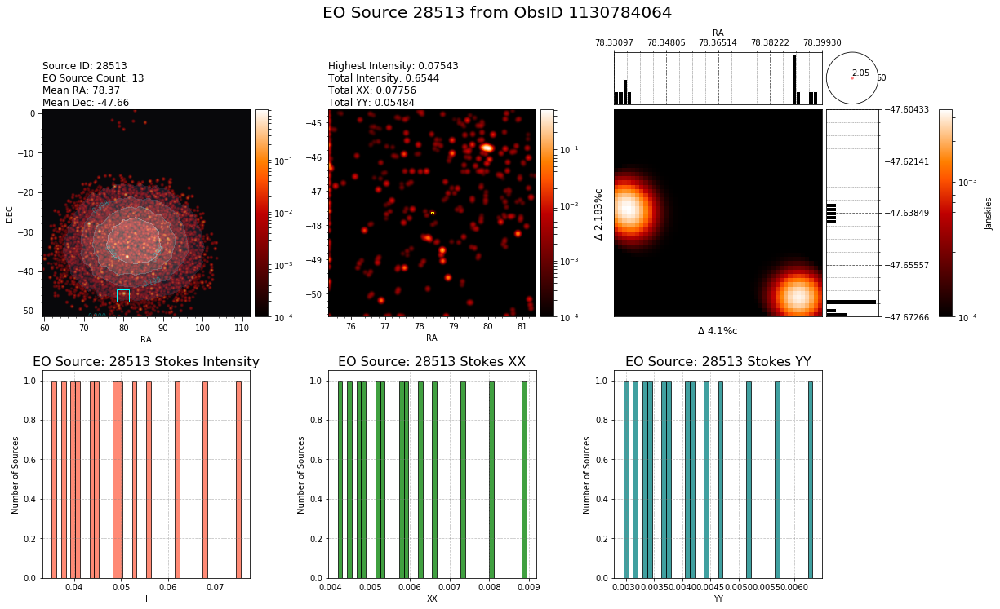

None
57


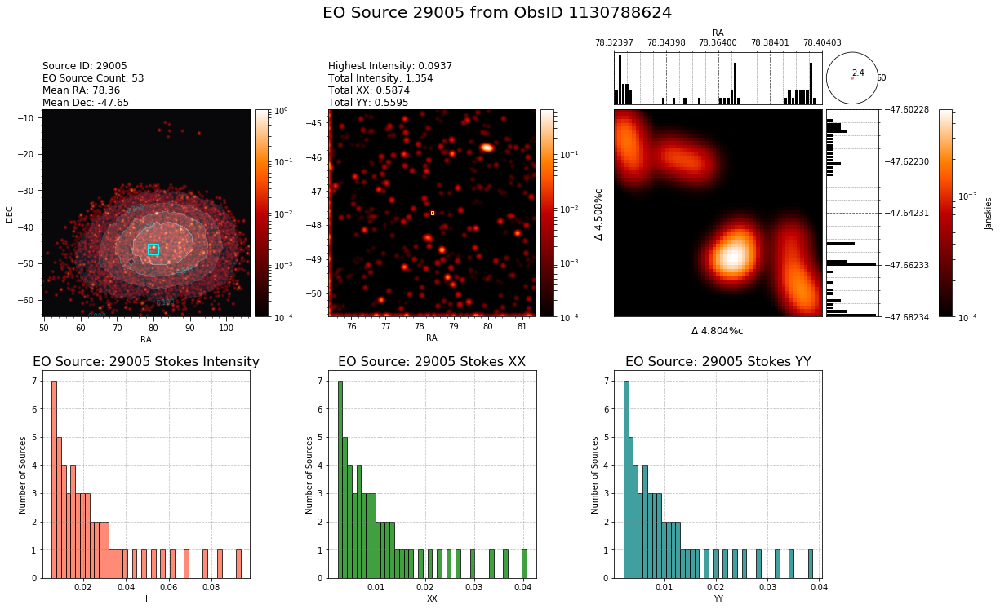

None
match 31
77


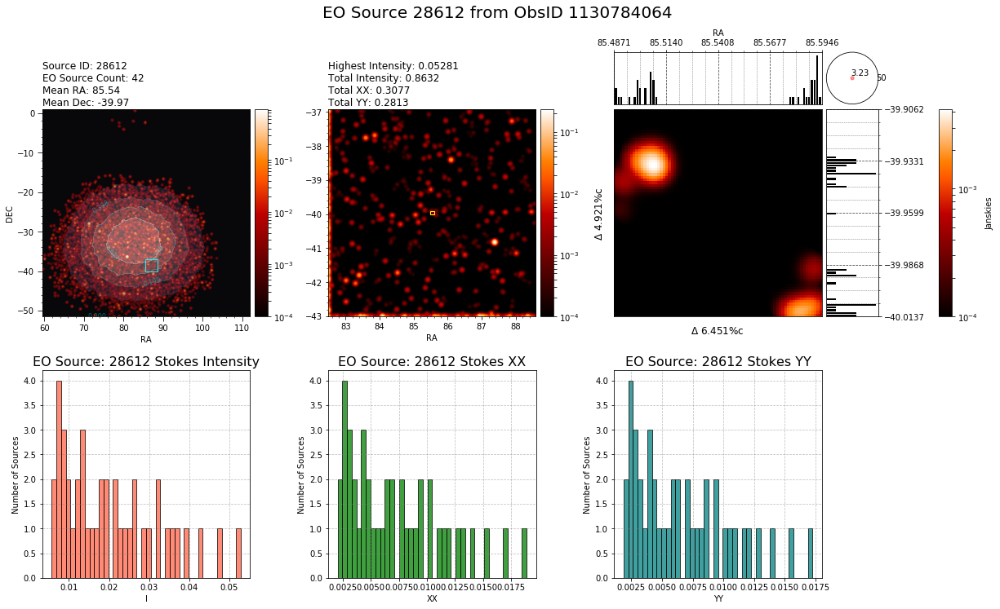

None
128


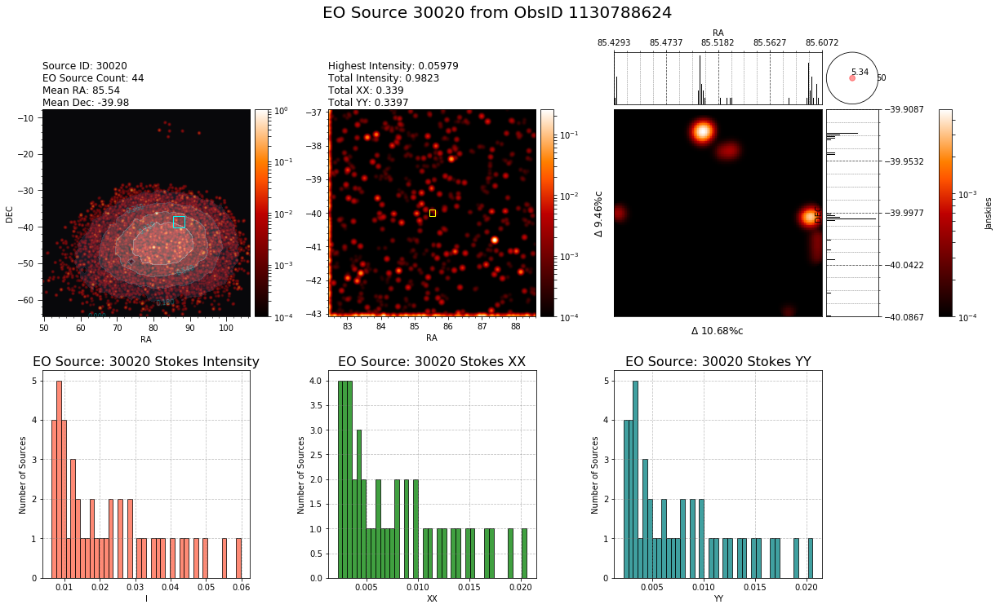

None
match 32
66


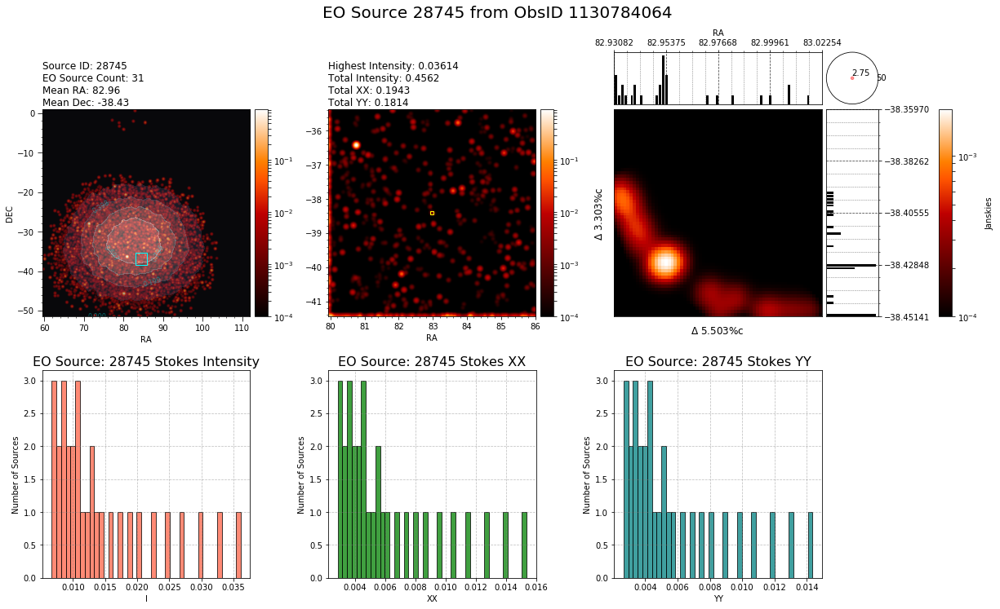

None
55


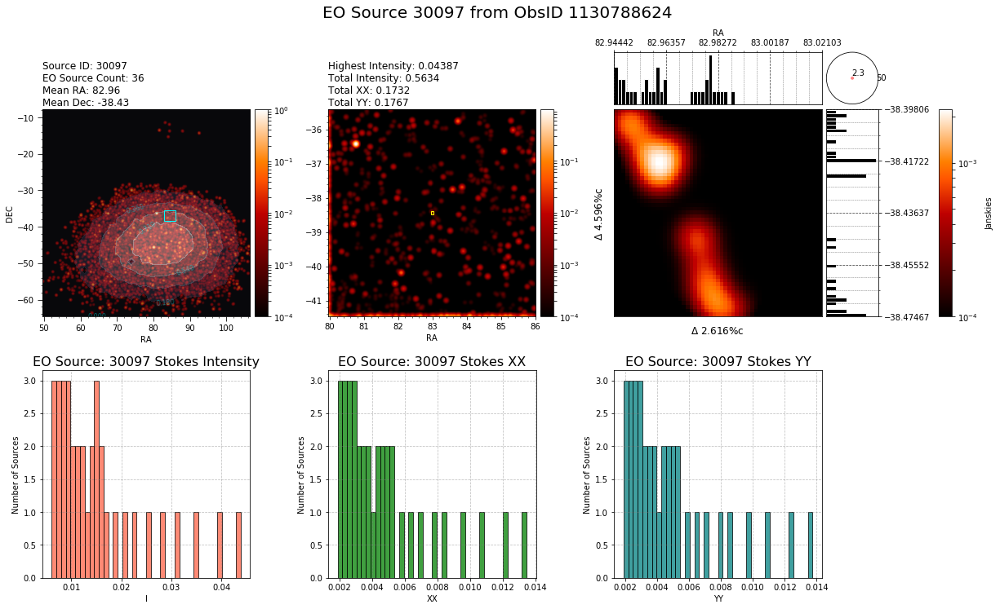

None
match 33
127


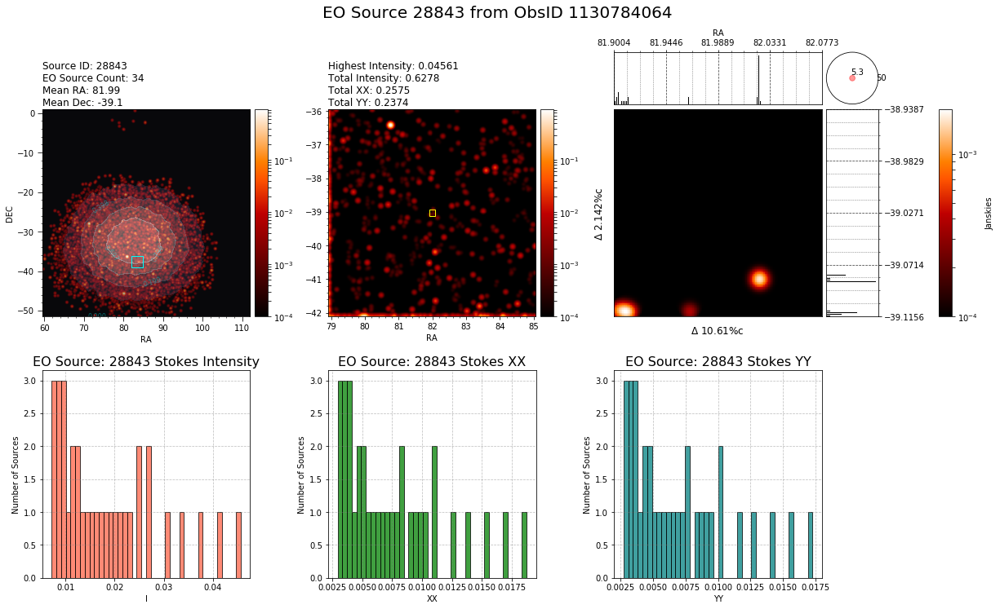

None
282


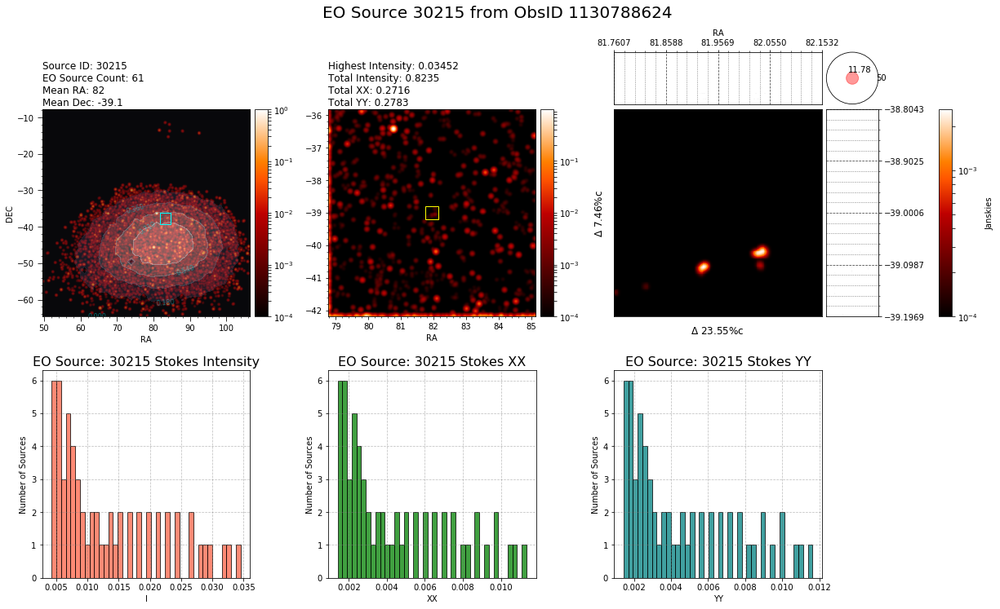

None
match 34
None
157


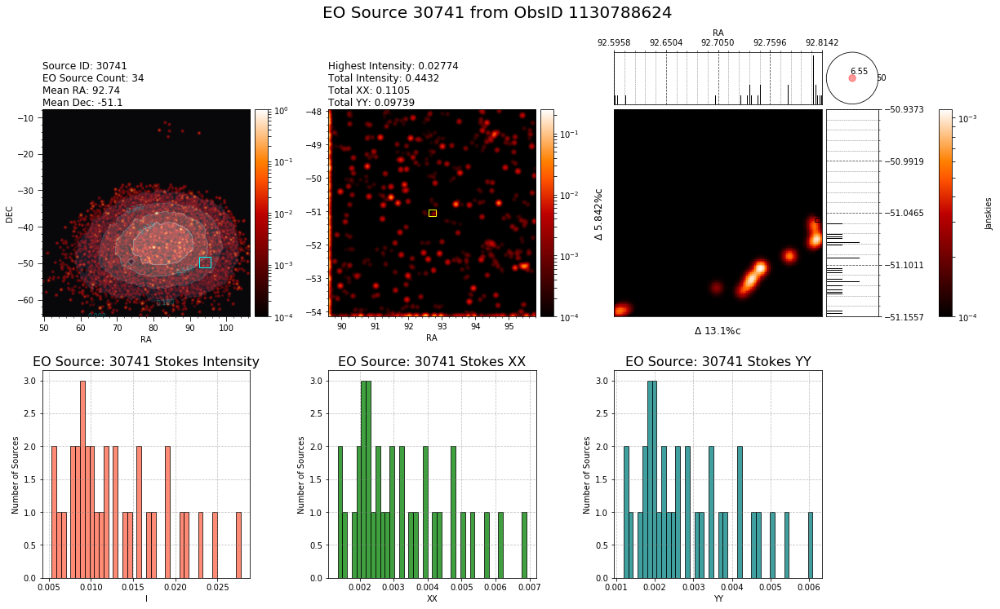

None
match 35
39


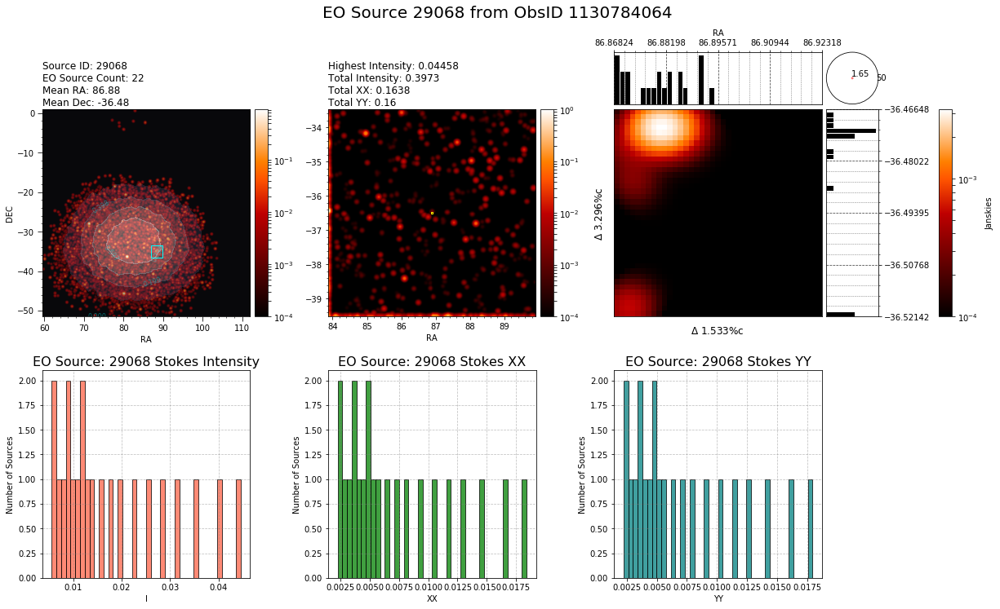

None
49


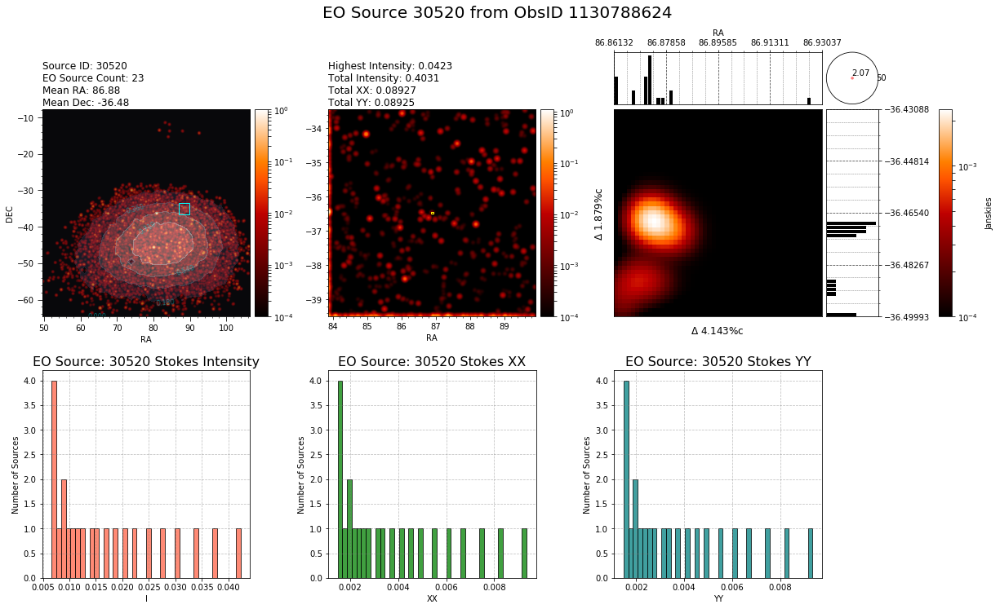

None
match 36
106


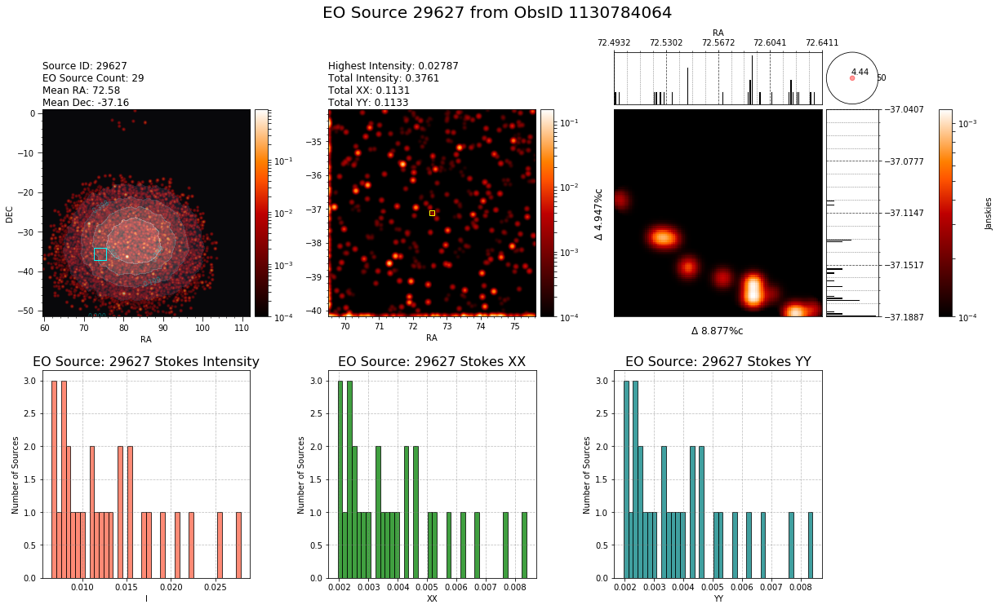

None
66


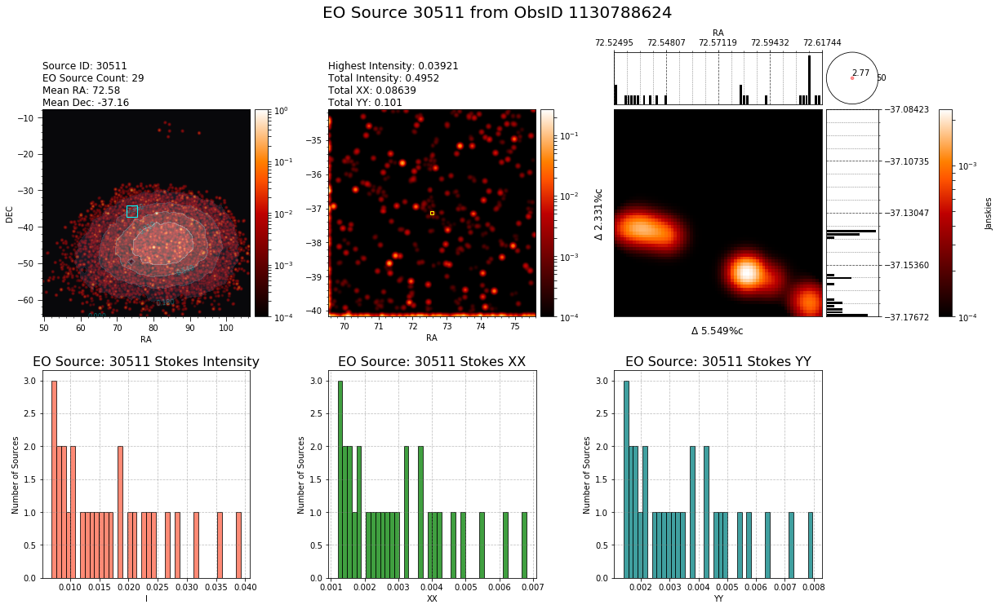

None
match 37
42


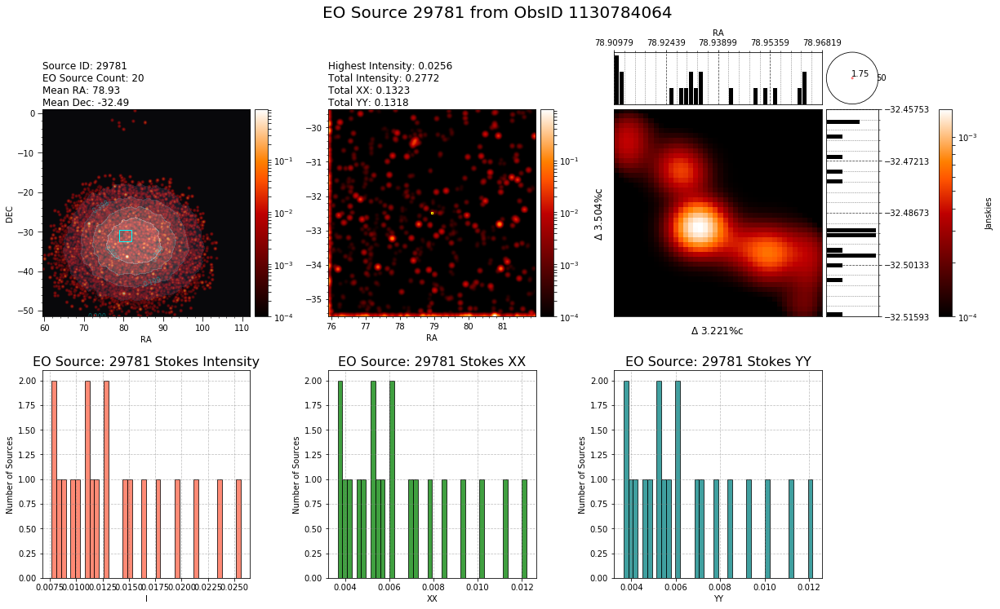

None
49


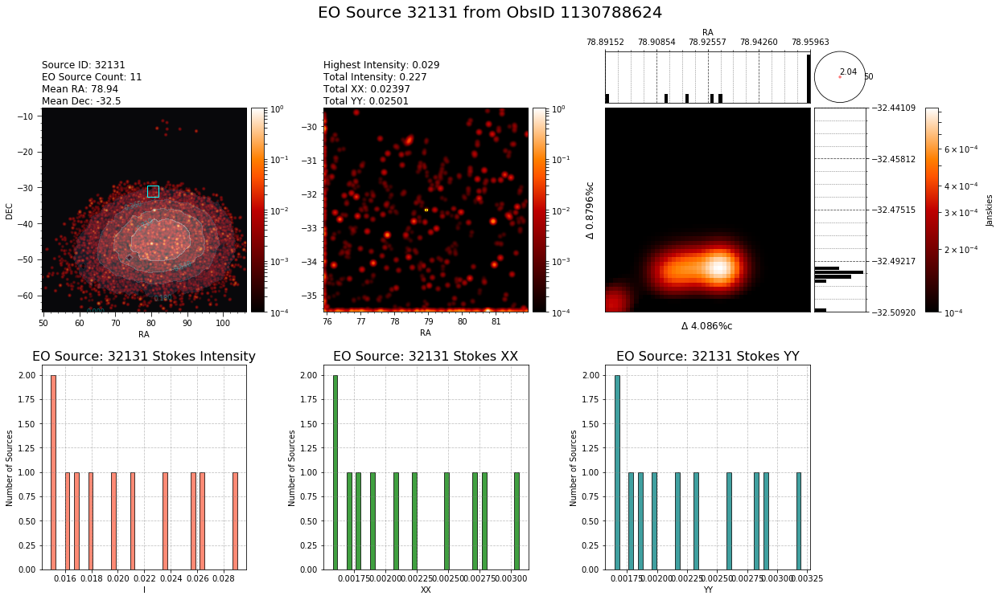

None
match 38
83


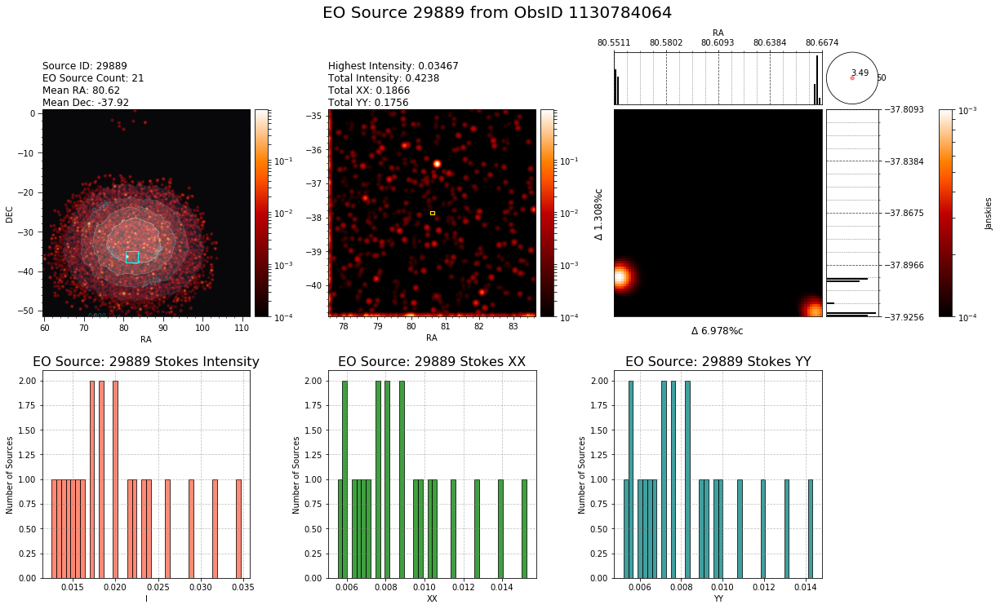

None
118


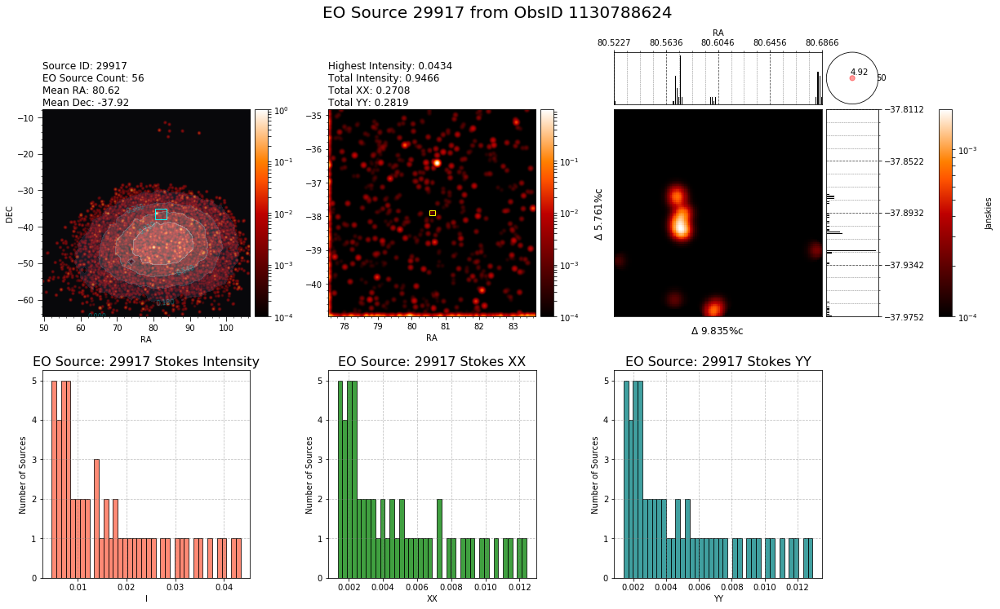

None
match 39
107


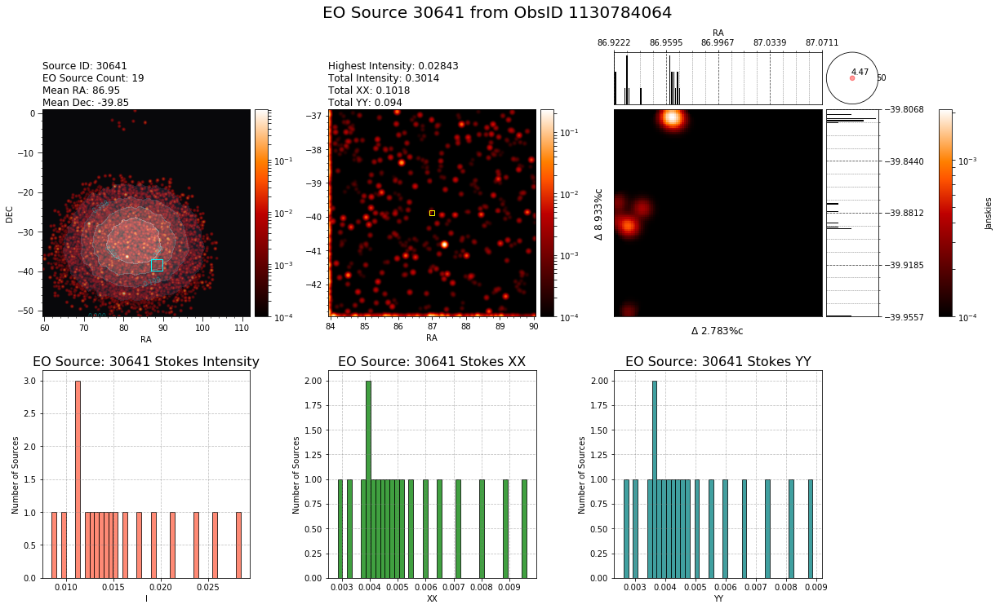

None
84


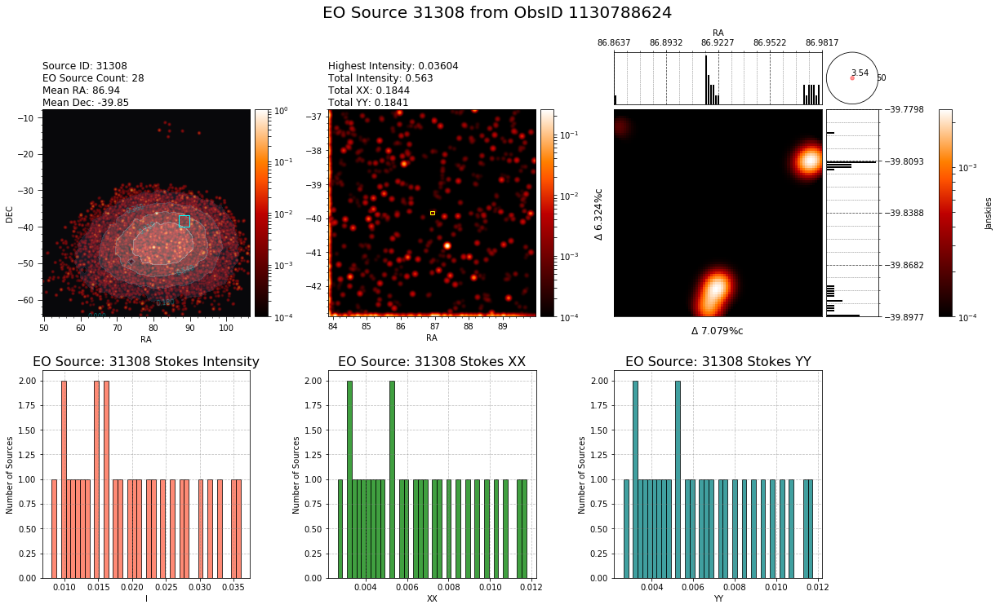

None
match 40
32


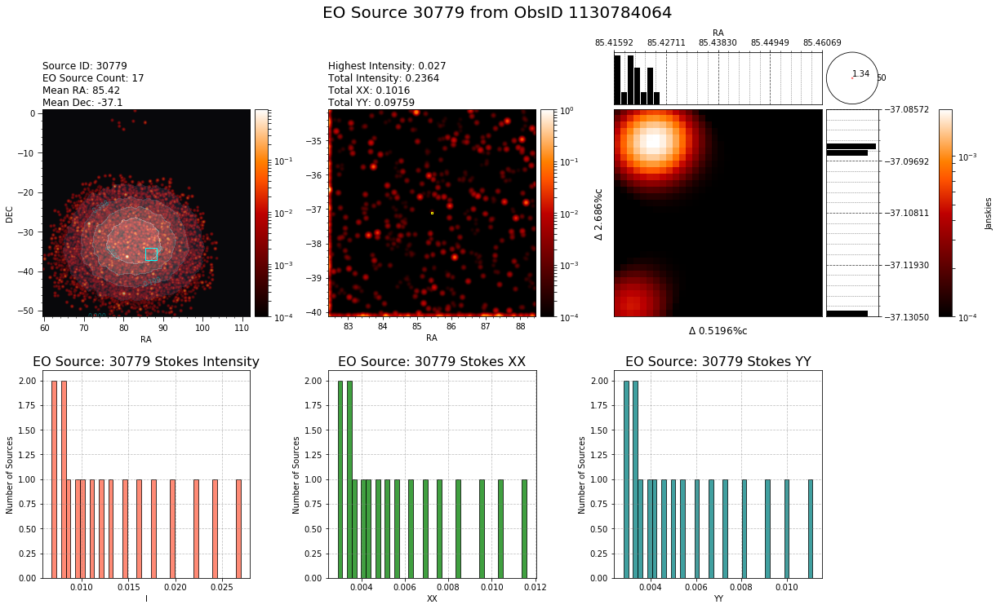

None
54


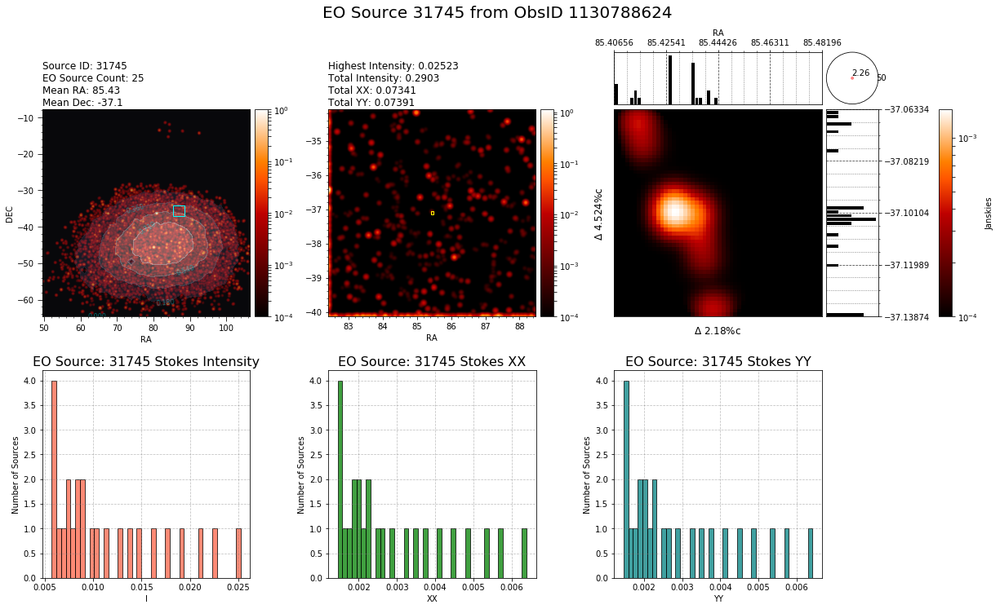

None
match 41
70


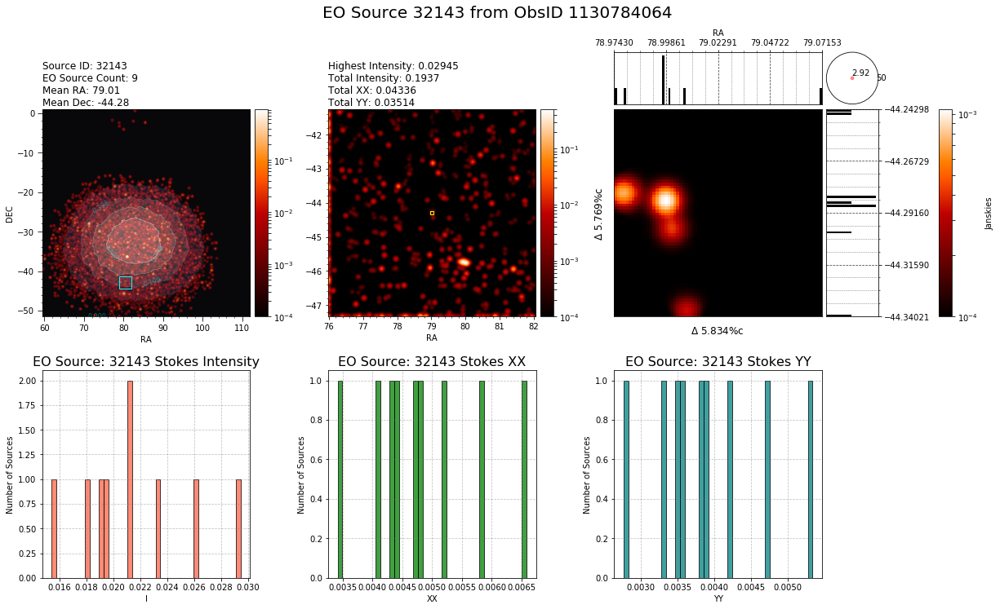

None
50


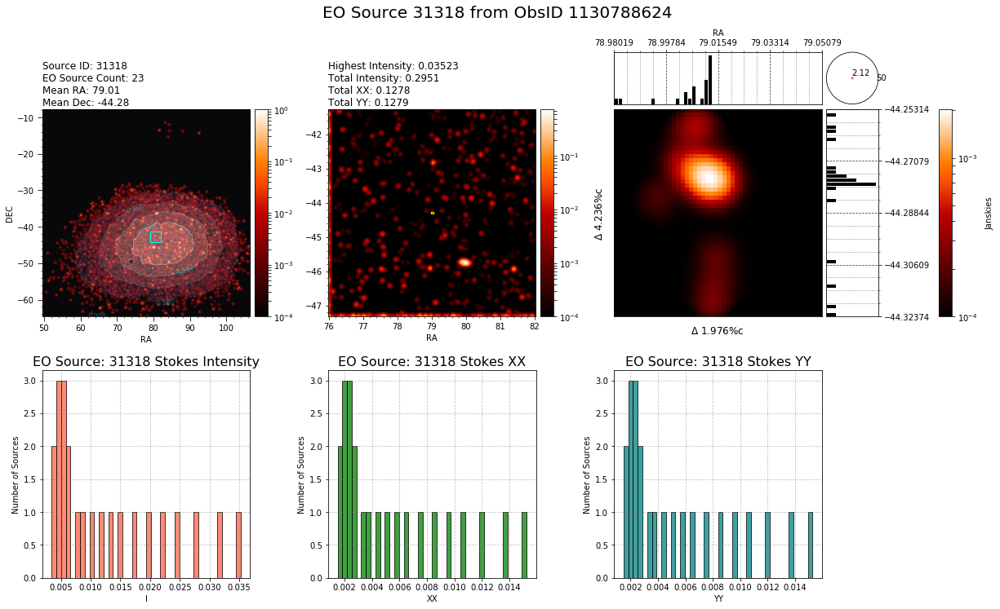

None
match 42
98


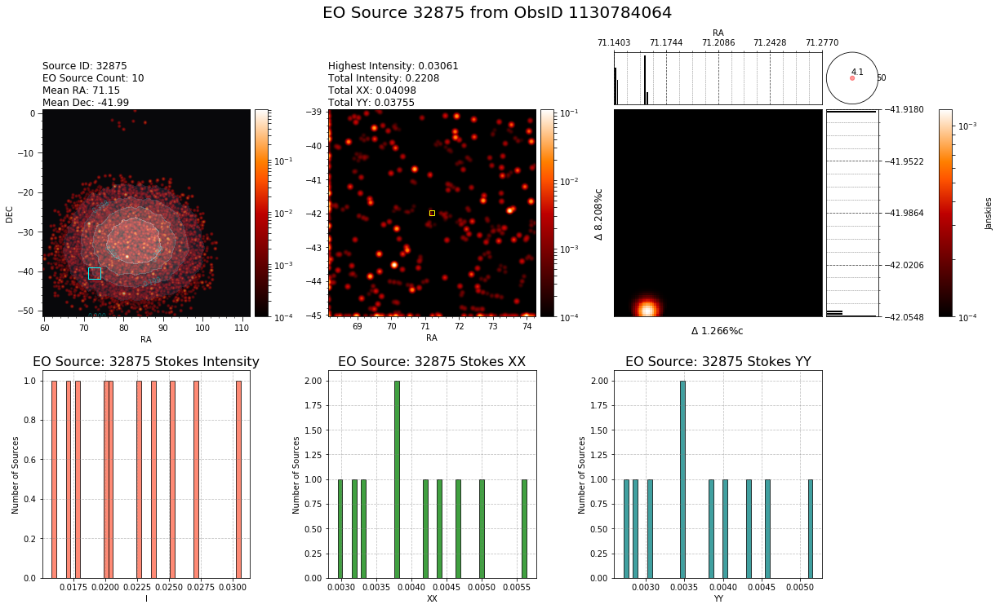

None
88


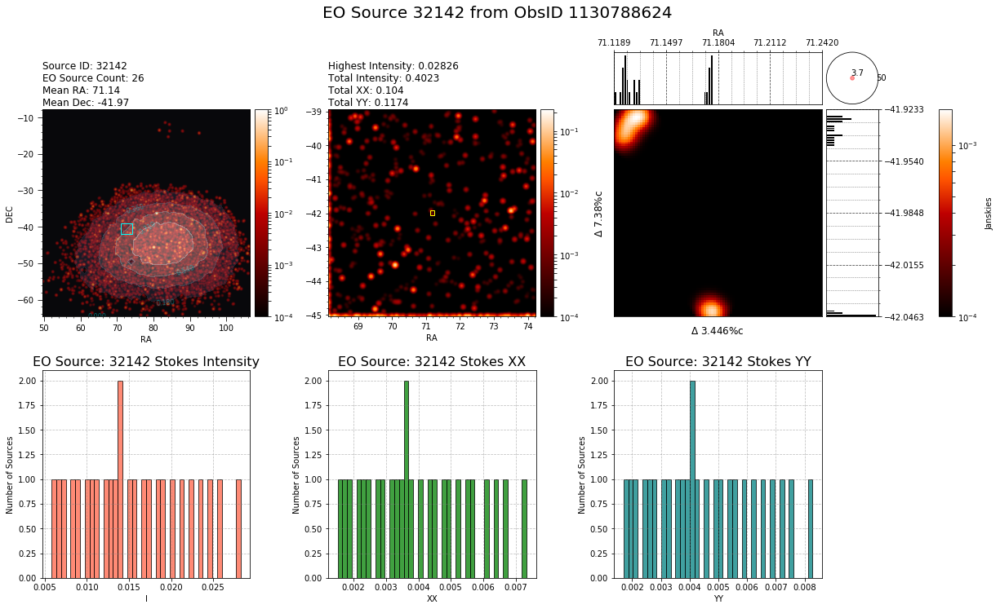

None
match 43
56


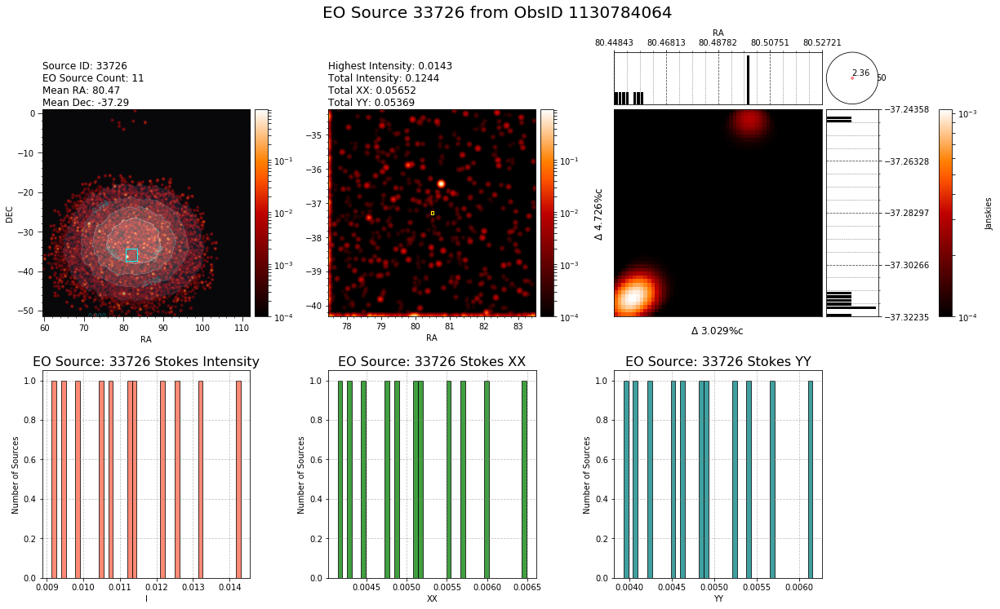

None
46


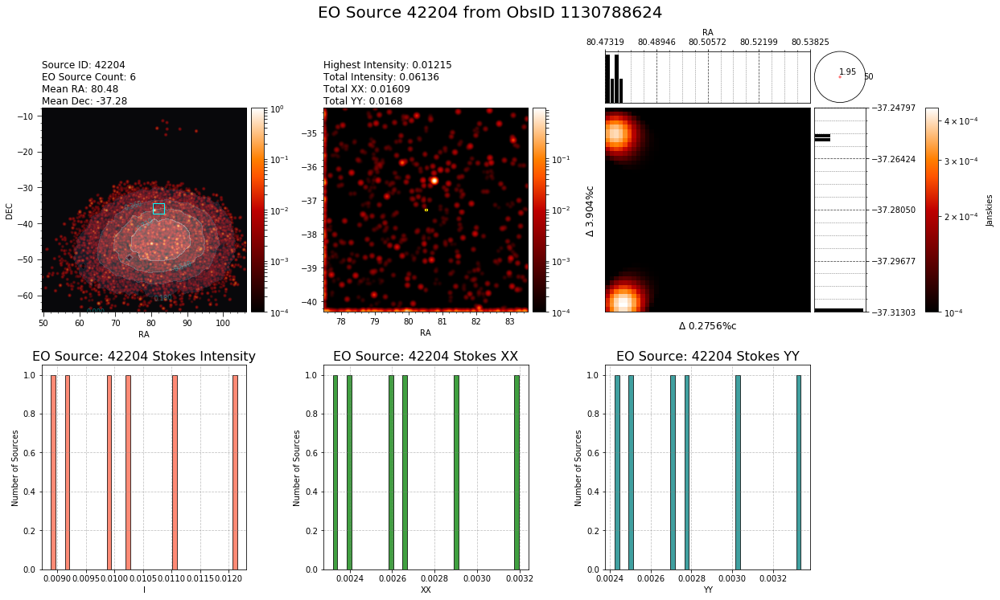

None
match 44
97


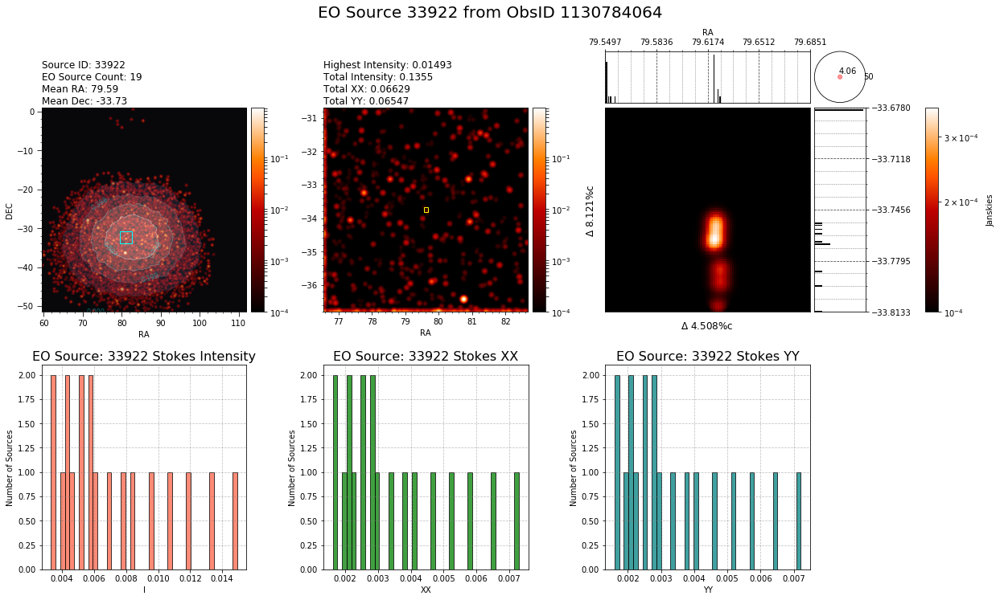

None
116


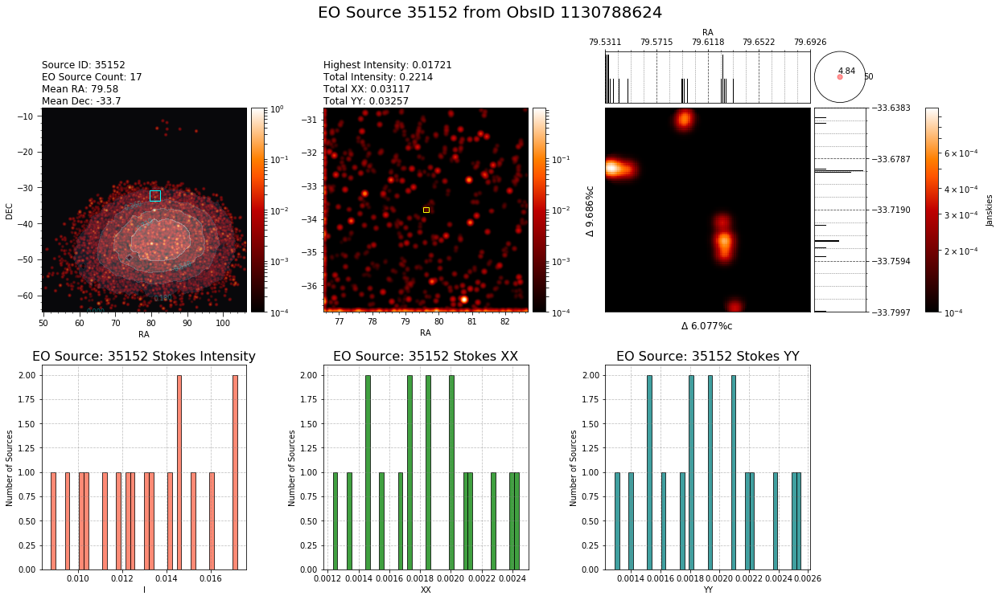

None
match 45
42


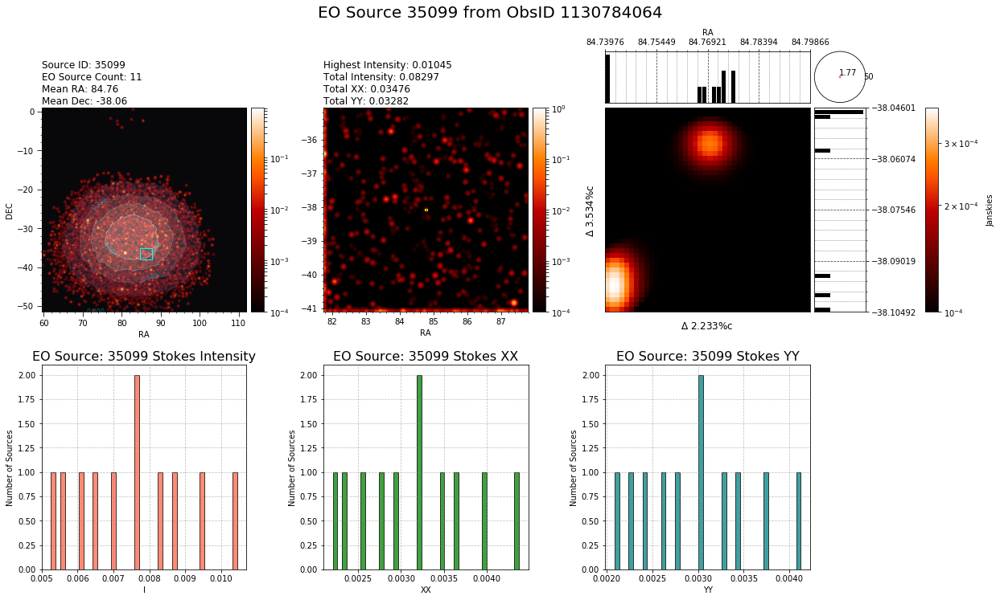

None
90


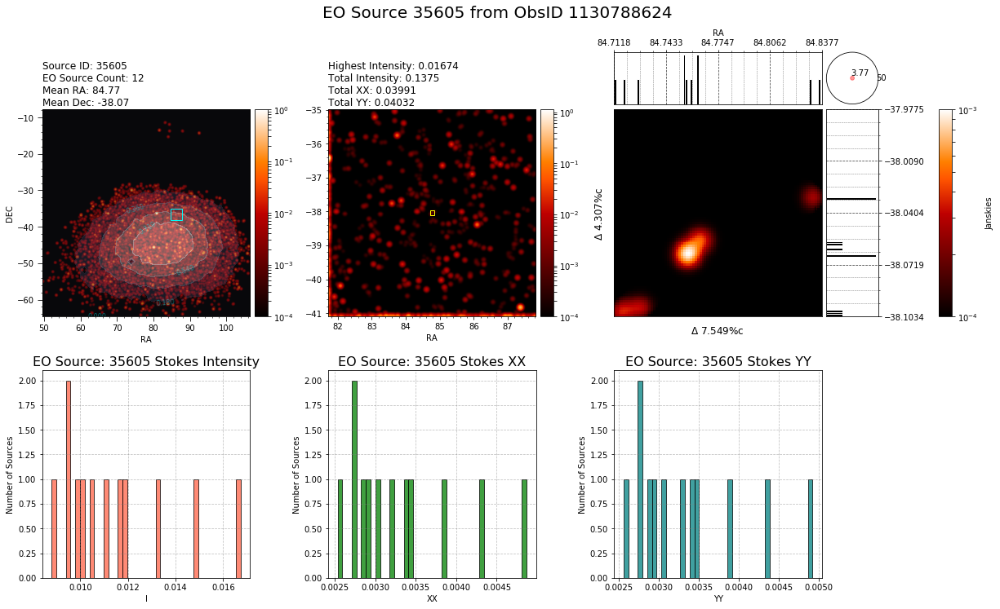

None
match 46
97


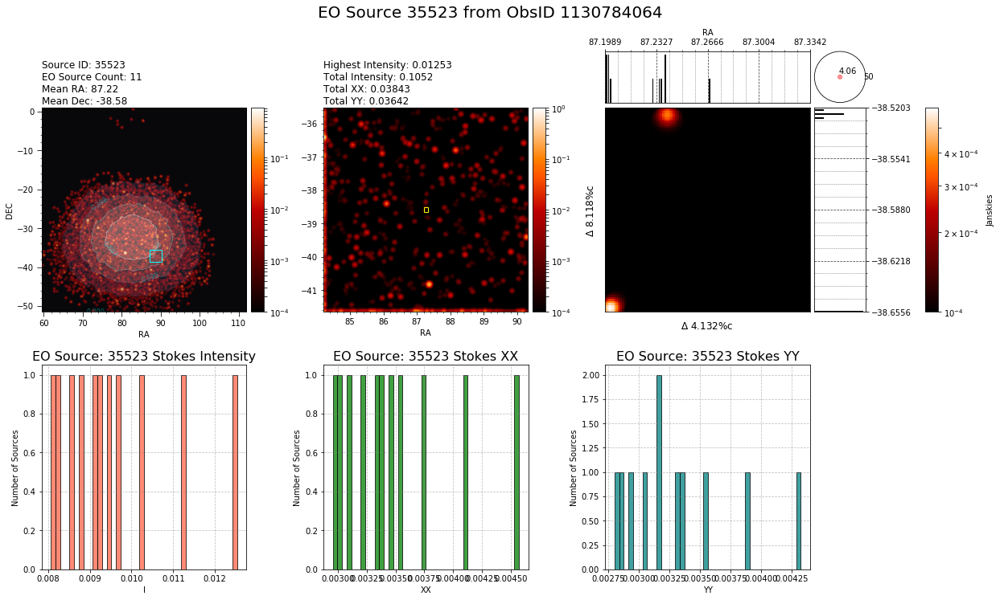

None
77


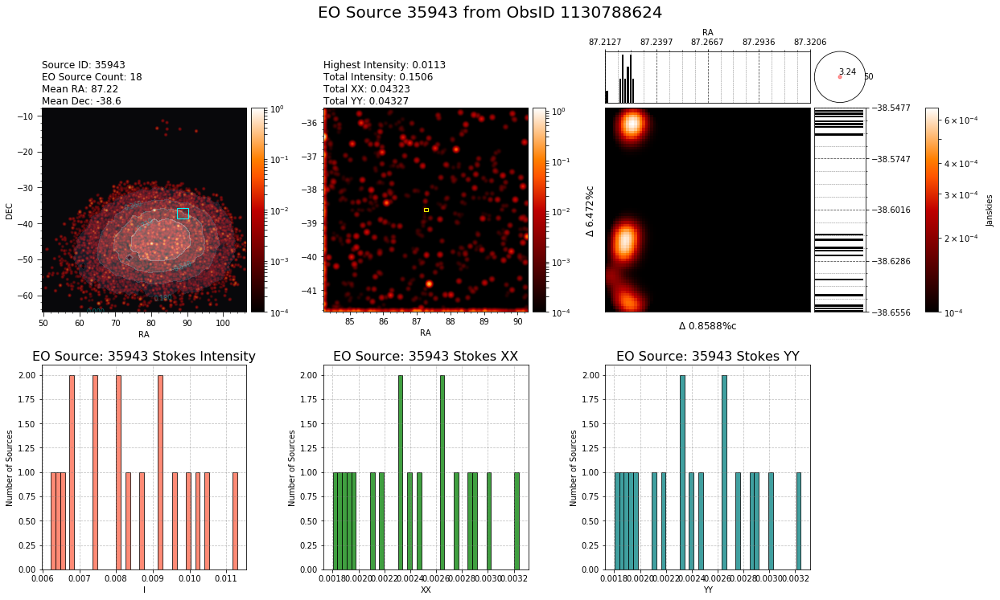

None


In [22]:
for i in range(len(match1)):
    print 'match {}'.format(i)
    print doot(data1,minI=0,sumI=0,EOid=match1[i]['id'])
    print doot(data2,minI=0,sumI=0,EOid=match2[i]['id'])

In [21]:
match2[3]['id']

28473

In [30]:

match1_RA = [[match1[i]['extend'][j]['ra'] \
        for j in range(len(match1[i]['extend']))] \
            for i in range(len(match1)) ]

In [29]:
match1[0]['extend'][0]['ra']

79.968658

In [ ]:
#this is not as relevant, but is still technically side by side! I am trying to recreate just the top right plot of 
#devins code using the old frankencode plootEO so I can compare these plots to the images from TGSS. Wish me luck!

In [63]:
def plootEO(data,sumI,n_bins):
    from matplotlib.colors import LogNorm
    from numpy import inf
    
    separated = separator(data)
    
    indexed_EO_sources_RA = [[[separated['extsources'][i][j]['EXTEND']['RA'][k] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['RA']))] \
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]

    indexed_EO_sources_DEC = [[[separated['extsources'][i][j]['EXTEND']['DEC'][k] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['DEC']))] \
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]

    indexed_EO_sources_I = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['I'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ]
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]
   
    indexed_EO_sources_XX = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['XX'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ]
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]
    
    indexed_EO_sources_YY = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['YY'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ]
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]
    
    #print indexed_EO_sources_RA
    
    for i in range(len(separated['extsources'])):
        for j in range(len(separated['extsources'][i])):
            if(sum(indexed_EO_sources_I[i][j]) > sumI):
                ra_zoom = [min(indexed_EO_sources_RA[i][j]),max(indexed_EO_sources_RA[i][j])]
                dec_zoom = [min(indexed_EO_sources_DEC[i][j]),max(indexed_EO_sources_DEC[i][j])]
                
                ra_total = np.array(indexed_EO_sources_RA[i][j])
                dec_total = np.array(indexed_EO_sources_DEC[i][j])
                flux_total = np.array(indexed_EO_sources_I[i][j])
                
                
                '''
                #
                if (ra_zoom[1]-ra_zoom[0]) > (dec_zoom[1]-dec_zoom[0]):
                    zoom = ra_zoom
                else:
                    zoom = dec_zoom
                
                #Find the size of the bins using the largest dimension and the num of bins
                n_bins = (zoom[1]-zoom[0])/binsize
                print n_bins
                
                #
                '''
                (pixels, ra_pixel_centers, dec_pixel_centers) = \
                pixelate(ra_zoom,dec_zoom,n_bins,ra_total,dec_total,flux_total)
                
                pixels[pixels == 0] = 1e-2
                logpixels = np.log10(pixels)                
                #cmap = matplotlib.cm.get_cmap('afmhot')
                cmap = matplotlib.cm.get_cmap('hot')
                
                #trying out some gaussian convolution
                kernel = Gaussian2DKernel(stddev=1)
                #scipy_conv = scipy_convolve(pixels, kernel, mode='same', method='direct')
                #astropy_conv = convolve(pixels, kernel)
                smoothed_data = convolve(pixels, kernel)
                #dont mind me
                
                plt.figure(figsize=(9,8))
                plt.imshow(np.transpose(smoothed_data),\
                    origin = "lower", \
                    interpolation = "none",\
                    #vmin=0.001,\
                    #vmax=2,\
                    norm = LogNorm(vmin=.01,vmax=max(flux_total)),\
                    cmap = cmap,\
                    extent = [ra_pixel_centers[0], ra_pixel_centers[len(ra_pixel_centers)-1], \
                    dec_pixel_centers[0], dec_pixel_centers[len(dec_pixel_centers)-1]])

                plt.title('ObsID: {} at Frequency {}'.format(separated['extsources'][i][j]['ID'], separated['extsources'][i][j]['FREQ']), fontsize = 20)
                plt.xlabel('RA', fontsize = 14)
                plt.ylabel('DEC', fontsize = 14)
                plt.tick_params(size = 8, labelsize = 12)
                plt.minorticks_on()
                plt.tick_params('both', length=12, width=1.8, which='major')
                plt.tick_params('both',length=5, width=1.4, which='minor')
                
                #lets gettttt...
                
                #fig = plt.gcf()
                #ax = fig.gca()
                #circ = plt.Circle((50.7,-36.9),radius=0.0833333, color='g',fill=False)
                #ax.add_artist(circ)
                '''
                legend = ax.legend(loc='upper right', shadow=True)
                frame = legend.get_frame()
                frame.set_facecolor('0.90')
                
                red_patch = mpatches.Patch(color='red', label='The red data')
                plt.legend(loc='best',handles=[red_patch])
                
                #a legend!!
                '''
                plt.annotate("ID: {}\nComponents: {}\nTotal Flux: {}\nMean RA: {}\nMean Dec: {}".format \
                    (separated['extsources'][i][j]['ID'], len(indexed_EO_sources_I[i][j]), np.sum(indexed_EO_sources_I[i][j]), \
                    np.mean(indexed_EO_sources_RA[i][j]), np.mean(indexed_EO_sources_DEC[i][j])),\
                    xy=(1.5, .5), xytext=(0, 0),\
                    xycoords=('axes fraction', 'figure fraction'),\
                    textcoords='offset points',\
                    size=14, ha='center', va='bottom')
                
                plt.colorbar(label='Janskies')
                # plt.savefig('pixelatedEO'+'{}'.format(separated['extsources'][i][j]['ID'])+'.png')
    return plt.show()

    # line 48 plt.imshow(np.transpose(pixels),\  #pixels used to be logpixels
    # line 50 interpolation = "nearest",\  #interpolate used to be 'gaussian'
    #     changed this to 'none'
    # vmax was vmax=max(flux_total))

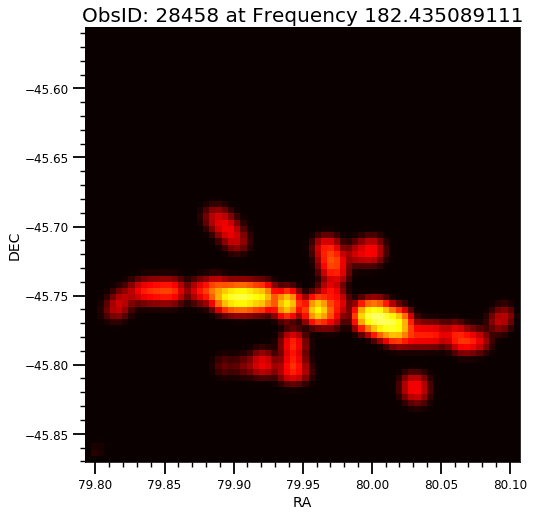

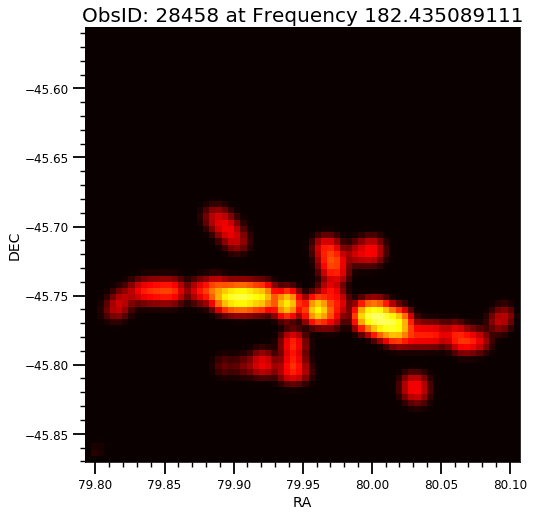

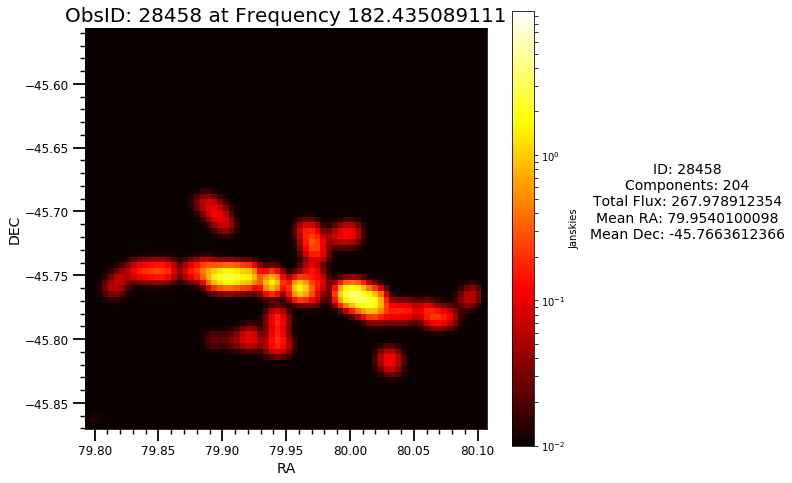

In [64]:
plootEO(data2,50,70)

In [ ]:
def pixelate(ra_zoom, dec_zoom, n_bins, ra_total, dec_total, flux_total):
    import numpy as np
    #Check to see which dimension is larger so that a square in ra,dec can 
    #be returned
    if (ra_zoom[1]-ra_zoom[0]) > (dec_zoom[1]-dec_zoom[0]):
        zoom = ra_zoom
    else:
        zoom = dec_zoom

    #Find the size of the bins using the largest dimension and the num of bins
    binsize = (zoom[1]-zoom[0])/n_bins

    #Create arrays for ra and dec that give the left side of each pixel
    ra_bin_array = (np.array(range(n_bins)) * binsize) + ra_zoom[0]
    dec_bin_array = (np.array(range(n_bins)) * binsize) + dec_zoom[0]
    #Create an empty array of pixels to be filled in the for loops
    pixels = np.zeros((len(ra_bin_array),len(dec_bin_array)))

    #Histogram components into ra bins
    ra_histogram = np.digitize(ra_total,ra_bin_array)
    ###print ra_histogram

    #Begin for loop over both dimensions of pixels, starting with ra
    for bin_i in range(len(ra_bin_array) - 2):
        ###print range(len(ra_bin_array) -2
        ###print "bin_i",bin_i
        #Find the indices that fall into the current ra bin slice
        ra_inds = np.where(ra_histogram == bin_i)
        ###print "rainds", ra_inds[0]
        ###print "lenrainds", len(ra_inds[0])

        #Go to next for cycle if no indices fall into current ra bin slice
        if len(ra_inds[0]) == 0:
            continue

        #Histogram components that fall into the current ra bin slice by dec
        #print "dectotindex", dec_total[ra_inds]
        #print "decbin", dec_bin_array
        dec_histogram = np.digitize(dec_total[ra_inds],dec_bin_array)
        #print "dechist",dec_histogram
        #Begin for loop by dec over ra bin slice
        for bin_j in range(len(dec_bin_array) -2):
            
            #Find the indicies that fall into the current dec bin
            dec_inds = np.where(dec_histogram == bin_j)

            #Go to next for cycle if no indices fall into current dec bin			
            if len(dec_inds[0]) == 0:
                continue
            #Sum the flux components that fall into current ra/dec bin
            ###print "bi",bin_i,bin_j
            ###print "inds",ra_inds, dec_inds
            pixels[bin_i,bin_j] = np.sum(flux_total[ra_inds[0][dec_inds][0]])

    #Find the pixel centers in ra/dec for plotting purposes
    ra_pixel_centers = (np.arange(n_bins) * binsize) + ra_zoom[0] + binsize/2.
    dec_pixel_centers = (np.arange(n_bins) * binsize) + dec_zoom[0] + binsize/2.

    return pixels, ra_pixel_centers, dec_pixel_centers

In [217]:
#WOOOOO I DID IT! I made Devin's code only show the image of the EO, so now I can compare it to the ds9 images

#ye be warned, this code was abandoned and picked up by mwa_tgss_boi

from astropy.wcs import WCS

def pixelater(ra_zoom, dec_zoom, n_bins, ra_total, dec_total, flux_total):
    import numpy as np
    #Check to see which dimension is larger so that a square in ra,dec can 
    #be returned
    if (ra_zoom[1]-ra_zoom[0]) > (dec_zoom[1]-dec_zoom[0]):
        zoom = ra_zoom
    else:
        zoom = dec_zoom

    #Find the size of the bins using the largest dimension and the num of bins
    binsize = (zoom[1]-zoom[0])/n_bins

    #Create arrays for ra and dec that give the left side of each pixel
    spacing_dec = ((ra_zoom[1]-ra_zoom[0]) - (dec_zoom[1]-dec_zoom[0]))/2.
    spacing_ra = ((dec_zoom[1]-dec_zoom[0])-(ra_zoom[1]-ra_zoom[0]))/2.
    
    ra_bin_array = (np.array(range(n_bins)) * binsize) + ra_zoom[0]
    dec_bin_array = (np.array(range(n_bins)) * binsize) + dec_zoom[0]
    
    
    #hashing this out restores this to the original pixelate function.
    '''
    if (ra_zoom[1]-ra_zoom[0]) > (dec_zoom[1]-dec_zoom[0]):
        dec_bin_array = (np.array(range(n_bins)) * binsize) + dec_zoom[0] - spacing_dec
    if (ra_zoom[1]-ra_zoom[0]) < (dec_zoom[1]-dec_zoom[0]):
        ra_bin_array = (np.array(range(n_bins)) * binsize) + ra_zoom[0] - spacing_ra
    '''
    
    #Create an empty array of pixels to be filled in the for loops
    pixels = np.zeros((len(ra_bin_array),len(dec_bin_array)))

    #Histogram components into ra bins
    ra_histogram = np.digitize(ra_total,ra_bin_array)
    ###print ra_histogram

    #Begin for loop over both dimensions of pixels, starting with ra
    for bin_i in range(len(ra_bin_array) - 2):
        ###print range(len(ra_bin_array) -2
        ###print "bin_i",bin_i
        #Find the indices that fall into the current ra bin slice
        ra_inds = np.where(ra_histogram == bin_i)
        ###print "rainds", ra_inds[0]
        ###print "lenrainds", len(ra_inds[0])

        #Go to next for cycle if no indices fall into current ra bin slice
        if len(ra_inds[0]) == 0:
            continue

        #Histogram components that fall into the current ra bin slice by dec
        #print "dectotindex", dec_total[ra_inds]
        #print "decbin", dec_bin_array
        dec_histogram = np.digitize(dec_total[ra_inds],dec_bin_array)
        #print "dechist",dec_histogram
        #Begin for loop by dec over ra bin slice
        for bin_j in range(len(dec_bin_array) -2):
            
            #Find the indicies that fall into the current dec bin
            dec_inds = np.where(dec_histogram == bin_j)

            #Go to next for cycle if no indices fall into current dec bin			
            if len(dec_inds[0]) == 0:
                continue
            #Sum the flux components that fall into current ra/dec bin
            ###print "bi",bin_i,bin_j
            ###print "inds",ra_inds, dec_inds
            pixels[bin_i,bin_j] = np.sum(flux_total[ra_inds[0][dec_inds][0]])

    #Find the pixel centers in ra/dec for plotting purposes
    ra_pixel_centers = (np.arange(n_bins) * binsize) + ra_zoom[0] + binsize/2.
    dec_pixel_centers = (np.arange(n_bins) * binsize) + dec_zoom[0] + binsize/2.

    return pixels, ra_pixel_centers, dec_pixel_centers, spacing_dec, spacing_ra

def framer(min_RA, max_RA, min_DEC, max_DEC):
    #min_RA, max_RA, min_DEC, max_DEC = min(RA), max(RA), min(DEC), max(DEC)
    x = abs(max_RA - min_RA)
    y = abs(max_DEC - min_DEC)
    z = 0.3 * max(x,y)
    
    print 'x, y',x,y
    
    if x > y:
        min_RA -= z
        max_RA += z
        min_DEC -= z
        max_DEC += z
    elif y > x:
        min_RA -= z
        max_RA += z
        min_DEC -= z
        max_DEC += z
        
    return min_RA, max_RA, min_DEC, max_DEC

def framez(min_RA, max_RA, min_DEC, max_DEC):
    #min_RA, max_RA, min_DEC, max_DEC = min(RA), max(RA), min(DEC), max(DEC)
    x = max_RA - min_RA
    y = max_DEC - min_DEC
    z = .5 * max(x,y)
    
    if x > y:
        RA_zoom_min = min_RA - z
        RA_zoom_max = max_RA + z
        DEC_zoom_min = min_DEC - .5*(x-y) - z
        DEC_zoom_max = max_DEC + .5*(x-y) + z
    elif y > x:
        RA_zoom_min = min_RA - .5*(x-y) - z
        RA_zoom_max = max_RA + .5*(x-y) + z
        DEC_zoom_min = min_DEC - z
        DEC_zoom_max = max_DEC + z
        
    return RA_zoom_min, RA_zoom_max, DEC_zoom_min, DEC_zoom_max

def sidebyside(data,fits_file,minI=0,sumI=0,binwidth=2,sigmawidth=8,EOid=None):
    from matplotlib.colors import LogNorm
    from matplotlib.colorbar import Colorbar
    import matplotlib.patches as patches
    from scipy.stats import iqr
    from scipy.stats.kde import gaussian_kde
    import matplotlib.gridspec as gridspec
    import re
    from astropy.convolution import convolve, convolve_fft
    from astropy.convolution import Gaussian2DKernel
    import matplotlib.pyplot as plt
    from scipy.stats import norm
    import matplotlib.mlab as mlab
    
    separated = separator(data)
    
    binwidth = binwidth * (1./3600.) #Converting binwidth in arcsec to degrees
    sigmawidth = sigmawidth * (1./3600.) #Converting binwidth in arcsec to degrees
    
    indexed_point_sources_RA = [[separated['psources'][i][j]['RA'] \
        for j in range(len(separated['psources'][i]))] \
            for i in range(len(separated['psources'])) ]

    indexed_point_sources_DEC = [[separated['psources'][i][j]['DEC'] \
        for j in range(len(separated['psources'][i]))] \
            for i in range(len(separated['psources'])) ]

    indexed_point_sources_I = [[separated['psources'][i][j]['FLUX']['I'][0] \
        for j in range(len(separated['psources'][i]))] \
            for i in range(len(separated['psources'])) ]
    
    indexed_point_sources_XX = [[separated['psources'][i][j]['FLUX']['XX'][0] \
        for j in range(len(separated['psources'][i]))] \
            for i in range(len(separated['psources'])) ]
    
    indexed_point_sources_YY = [[separated['psources'][i][j]['FLUX']['YY'][0] \
        for j in range(len(separated['psources'][i]))] \
            for i in range(len(separated['psources'])) ]

    indexed_EO_sources_RA = [[[separated['extsources'][i][j]['EXTEND']['RA'][k] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['RA']))] \
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]

    indexed_EO_sources_DEC = [[[separated['extsources'][i][j]['EXTEND']['DEC'][k] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['DEC']))] \
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]

    indexed_EO_sources_I = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['I'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ] \
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]
    
    indexed_EO_sources_XX = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['XX'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ] \
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]
    
    indexed_EO_sources_YY = [[[separated['extsources'][i][j]['EXTEND']['FLUX'][k]['YY'][0] \
        for k in range(len(separated['extsources'][i][j]['EXTEND']['FLUX'])) ] \
            for j in range(len(separated['extsources'][i]))] \
                for i in range(len(separated['extsources'])) ]
    
    for i in range(len(data['data'])):
        for j in range(len(indexed_EO_sources_RA[i])):
            for k in range(len(indexed_EO_sources_RA[i][j])):
                if indexed_EO_sources_RA[i][j][k] > 180:
                    indexed_EO_sources_RA[i][j][k] -= 360
        for j in range(len(indexed_point_sources_RA[i])):
            if indexed_point_sources_RA[i][j] > 180:
                indexed_point_sources_RA[i][j] -= 360    
    
    all_RA = [[indexed_point_sources_RA[i][j] \
        for j in range(len(indexed_point_sources_RA[i]))] \
        + [indexed_EO_sources_RA[i][j][k] \
        for j in range(len(indexed_EO_sources_RA[i])) \
        for k in range(len(indexed_EO_sources_RA[i][j]))] \
            for i in range(len(data['data'])) ]
    
    all_DEC = [[indexed_point_sources_DEC[i][j] \
        for j in range(len(indexed_point_sources_DEC[i]))] \
        + [indexed_EO_sources_DEC[i][j][k] \
        for j in range(len(indexed_EO_sources_DEC[i])) \
        for k in range(len(indexed_EO_sources_DEC[i][j]))] \
            for i in range(len(data['data'])) ]
    
    all_I = [[indexed_point_sources_I[i][j] \
        for j in range(len(indexed_point_sources_I[i]))] \
        + [indexed_EO_sources_I[i][j][k] \
        for j in range(len(indexed_EO_sources_I[i])) \
        for k in range(len(indexed_EO_sources_I[i][j]))] \
            for i in range(len(data['data'])) ]
    
    all_XX = [[indexed_point_sources_XX[i][j] \
        for j in range(len(indexed_point_sources_XX[i]))] \
        + [indexed_EO_sources_XX[i][j][k] \
        for j in range(len(indexed_EO_sources_XX[i])) \
        for k in range(len(indexed_EO_sources_XX[i][j]))] \
            for i in range(len(data['data'])) ]
    
    all_YY = [[indexed_point_sources_YY[i][j] \
        for j in range(len(indexed_point_sources_YY[i]))] \
        + [indexed_EO_sources_YY[i][j][k] \
        for j in range(len(indexed_EO_sources_YY[i])) \
        for k in range(len(indexed_EO_sources_YY[i][j]))] \
            for i in range(len(data['data'])) ]
    
    all_beam = [np.asarray(np.asarray(all_XX[i]) + np.asarray(all_YY[i])) / np.asarray(all_I[i]) for i in range(len(data['data']))]
    #print all_beam[0]
    #print all_beam[1]
    
    kernel = Gaussian2DKernel(stddev=(sigmawidth/binwidth))
    semi_zoom = 3
    pixelreplacement = 1e-5
    cmap = matplotlib.cm.get_cmap('gist_heat')

    for i in range(len(data['data'])):
        
        #---------- Pixelating and convolving All Plot
        all_ra_zoom = [min(all_RA[i]),max(all_RA[i])]
        all_dec_zoom = [min(all_DEC[i]),max(all_DEC[i])]
        all_n_bins = min(int(max(max(all_RA[i]) - min(all_RA[i]),max(all_DEC[i]) - min(all_DEC[i])) / binwidth),1024)
        all_ra_total = np.array(all_RA[i])
        all_dec_total = np.array(all_DEC[i])
        all_I_total = np.array(all_I[i])
        all_XX_total = np.array(all_XX[i])
        all_YY_total = np.array(all_YY[i])
        
        all_beam_total = np.array(all_beam[i])
        
        (all_pixels, all_ra_pixel_centers, all_dec_pixel_centers, spacing_dec, spacing_ra) = \
                pixelater(all_ra_zoom,all_dec_zoom,all_n_bins,all_ra_total,all_dec_total,all_I_total)
            
        (all_pixels_contour, all_ra_pixel_centers_contour, all_dec_pixel_centers_contour, spacing_dec, spacing_ra) = \
                    pixelater(all_ra_zoom,all_dec_zoom,50,all_ra_total,all_dec_total,all_beam_total)
        
        all_pixels[all_pixels == 0] = pixelreplacement
        all_convolved = convolve_fft(all_pixels, kernel)
        if EOid != None:
            minI, sumI = 0, 0
            
        
        for j in range(len(separated['extsources'][i])):
            if (EOid is not None) and (separated['extsources'][i][j]['ID'] != EOid):
                continue
                
            elif ((max(indexed_EO_sources_I[i][j]) > minI) or (sum(indexed_EO_sources_I[i][j]) > sumI))\
            and ((max(indexed_EO_sources_XX[i][j]) != 0) and (max(indexed_EO_sources_YY[i][j]) != 0)):
                #---------- Pixelating and convolving EO Plot
                EO_ra_zoom = [min(indexed_EO_sources_RA[i][j]),max(indexed_EO_sources_RA[i][j])]
                EO_dec_zoom = [min(indexed_EO_sources_DEC[i][j]),max(indexed_EO_sources_DEC[i][j])]                
                EO_ra_total = np.array(indexed_EO_sources_RA[i][j])
                EO_dec_total = np.array(indexed_EO_sources_DEC[i][j])
                EO_I_total = np.array(indexed_EO_sources_I[i][j])
                
                print 'EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1]',EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1]
                
                #EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1] = \
                #framez(EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1])
                
                frame = 0.02
                
                EO_ra_zoom[0] -= frame
                EO_dec_zoom[0] -= frame
                EO_ra_zoom[1] += frame
                EO_dec_zoom[1] += frame
                
                print 'EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1]',EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1]
                
                EO_n_bins = int(max(max(EO_ra_total) - min(EO_ra_total),max(EO_dec_total) - min(EO_dec_total)) / binwidth)
                #print EO_n_bins
                #print separated['extsources'][i][j]['ID']
                (EO_pixels, EO_ra_pixel_centers, EO_dec_pixel_centers, spacing_dec, spacing_ra) = \
                pixelater(EO_ra_zoom,EO_dec_zoom,EO_n_bins,EO_ra_total,EO_dec_total,EO_I_total)
                
                EO_pixels[EO_pixels == 0] = pixelreplacement
                EO_convolved = convolve_fft(EO_pixels, kernel)
                #---------- Pixelating and convolving Semi Plot
                semi_ra_zoom = [min(indexed_EO_sources_RA[i][j])-semi_zoom,max(indexed_EO_sources_RA[i][j])+semi_zoom]
                semi_dec_zoom = [min(indexed_EO_sources_DEC[i][j])-semi_zoom,max(indexed_EO_sources_DEC[i][j])+semi_zoom]
                semi_n_bins = min(int(max([semi_ra_zoom[1]-semi_ra_zoom[0],semi_dec_zoom[1]-semi_dec_zoom[0]])/binwidth),512)
                semi_ra_total = np.array(all_RA[i])
                semi_dec_total = np.array(all_DEC[i])
                semi_flux_total = np.array(all_I[i])

                (semi_pixels, semi_ra_pixel_centers, semi_dec_pixel_centers, spacing_dec, spacing_ra) = \
                        pixelater(semi_ra_zoom,semi_dec_zoom,semi_n_bins,semi_ra_total,semi_dec_total,semi_flux_total)

                semi_pixels[semi_pixels == 0] = pixelreplacement
                semi_convolved = convolve_fft(semi_pixels, kernel)
                
                ############################################################################
                
                
                
                
                
                fig = plt.figure(figsize=(25,15))
                fig.suptitle('EO Source {} from ObsID {}'.format\
                    (separated['extsources'][i][j]['ID'],\
                    [int(s) for s in re.findall('\d+',data['filenames'][i])][0],\
                    separated['extsources'][i][j]['FREQ']), fontsize = 20)
                
                #gs = gridspec.GridSpec(1, 2, height_ratios=[1], width_ratios=[1,1])
                #gs.update(left=0.05, right=0.95, bottom=0, top=0.9, wspace=0.05, hspace=0.05)
                
                
                #ax1 = fig.add_subplot(gs[0,0])
                ax1 = fig.add_axes([0.0,0.1,0.7,0.7])
                
                EO_plot = ax1.imshow(np.transpose(EO_convolved), \
                    norm = LogNorm(vmin=pixelreplacement),\
                    origin = "lower", interpolation = "none", cmap = cmap,\
                    extent = [EO_ra_pixel_centers[0], EO_ra_pixel_centers[-1], \
                    EO_dec_pixel_centers[0], EO_dec_pixel_centers[-1]] )
                
                contour_plot_1 = ax1.contour(np.transpose(EO_convolved), colors=('green'), vmin=0, alpha=.8, extent=[EO_ra_pixel_centers[0], EO_ra_pixel_centers[-1], \
                    EO_dec_pixel_centers[0], EO_dec_pixel_centers[-1]],norm=LogNorm())
                
                ax1.patch.set_alpha(0.0)
                ax1.set_xlabel('RA')
                ax1.set_ylabel('DEC')
                ax1.minorticks_on()
                ax1.set_title('Plot of EO from MWA data')
                
                #ax1.annotate('ra range: ({},{})'.format(EO_ra_pixel_centers[0], EO_ra_pixel_centers[-1]),xy=(65.1,32.2))#/n
                #'dec range: ({},{})'.format(EO_dec_pixel_centers[0], EO_dec_pixel_centers[-1]))
                
                #X, Y = np.meshgrid(indexed_EO_sources_RA[i][j], indexed_EO_sources_DEC[i][j])
                
                #plt.contour(EO_convolved)
                
                #ax1.xaxis.set_ticks_position('none')
                #ax1.yaxis.set_ticks_position('none')
                '''
                ax1.set_xlabel(r' ')
                ax1.set_ylabel(r' ')
                ax1.set_xticklabels([])
                ax1.set_yticklabels([])
                ax1.set_xlabel(r'$\Delta$ {:.4G} arcmin'.format((max(EO_ra_total) - min(EO_ra_total))*60.), fontsize = 12)
                ax1.set_ylabel(r'$\Delta$ {:.4G} arcmin'.format((max(EO_dec_total) - min(EO_dec_total))*60.), fontsize = 12)
                '''
                ax1.set_xlim(ax1.get_xlim()[::-1])
                ax1.set_xlim(EO_ra_pixel_centers[-1], EO_ra_pixel_centers[0])
                ax1.set_ylim(EO_dec_pixel_centers[0], EO_dec_pixel_centers[-1])
                
                #use this to set your own values in if you need to:
                    #ax1.set_xlim(81.6, 81.2)
                    #ax1.set_ylim(-32.8, -32.4)
                
                #ax2 = fig.add_subplot(gs[0,1])
                #thing1 = ax2.imshow(img1)
                
                ra_center = (EO_ra_pixel_centers[-1] + EO_ra_pixel_centers[0]) / 2
                dec_center = (EO_dec_pixel_centers[-1] + EO_dec_pixel_centers[0]) / 2
                ra_radius = abs(EO_ra_pixel_centers[-1] - ra_center)
                dec_radius = abs(EO_dec_pixel_centers[-1] - dec_center)
                
                print dec_center, ra_radius
                
                f = aplpy.FITSFigure(fits_file,figure=fig,subplot=[0.5,0.1,0.7,0.7])
                f.show_colorscale(cmap='hot',vmin=0)
                f.show_contour(fits_file,layer='tgss',colors='blue',norm=LogNorm())
                
                f.add_grid()
                f.add_colorbar()
                f.set_nan_color('black')
                f.recenter(ra_center,dec_center,ra_radius,dec_radius)
                
                f.set_title('Plot of EO from TGSS')
                f.set_xaxis_coord_type('scalar')
                f.set_yaxis_coord_type('scalar')
                f.tick_labels.set_xformat('%11.3f')
                f.tick_labels.set_yformat('%11.3f')
                
                
                #third plot is TGSS file with MWA contour
                
                ax2 = fig.add_axes([0.6,0.1,0.3,0.3])
                f = aplpy.FITSFigure(fits_file,figure=fig,subplot=[0.3,0.1,0.6,0.6])
                f.show_colorscale(cmap='hot',vmin=0)
                
                f.add_grid()
                f.add_colorbar()
                f.set_nan_color('black')
                f.recenter(ra_center,dec_center,ra_radius,dec_radius)
                
                f.set_title('Plot of EO from TGSS')
                f.set_xaxis_coord_type('scalar')
                f.set_yaxis_coord_type('scalar')
                f.tick_labels.set_xformat('%11.3f')
                f.tick_labels.set_yformat('%11.3f')
                
                contour_plot = ax2.contour(np.transpose(EO_convolved), colors=('green'), vmin=0, alpha=.8, extent=[EO_ra_pixel_centers[-1], EO_ra_pixel_centers[0], \
                    EO_dec_pixel_centers[0], EO_dec_pixel_centers[-1]] )
                
                ax2.patch.set_alpha(0.0)
                
                
                ax2.minorticks_off()
                ax2.axes.get_xaxis().set_visible(False)
                ax2.axes.get_yaxis().set_visible(False)
                ax2.set_title('EO in TGSS (Same RA/DEC Range)')
                '''
            
                ax3 = fig.add_subplot(gs[1,0])
                thing2 = ax3.imshow(img3)
                ax3.minorticks_off()
                ax3.axes.get_xaxis().set_visible(False)
                ax3.axes.get_yaxis().set_visible(False)
                ax3.set_title('EO in TGSS (0.5 square degrees, centered)')
                
                ax4 = fig.add_subplot(gs[1,1])
                thing3 = ax4.imshow(img2)
                ax4.minorticks_off()
                ax4.axes.get_xaxis().set_visible(False)
                ax4.axes.get_yaxis().set_visible(False)
                ax4.set_title('EO in TGSS (Same RA/DEC Range, Contours)')
                '''
                
                
                
                #print 'ra range: ({},{})'.format(EO_ra_pixel_centers[0], EO_ra_pixel_centers[-1])
                #print 'dec range: ({},{})'.format(EO_dec_pixel_centers[0], EO_dec_pixel_centers[-1])
                #print EO_convolved
                
                
                #plt.savefig('/tgss_mwa/624/EO'+'{}'.format(separated['extsources'][i][j]['ID'])+'.png', bbox_inches='tight')
    return plt.show()
    

In [216]:
print sidebyside(data2,'624_TGSSfits/624_28819.FITS',EOid=28819)


EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1] 85.5303 85.6104 -50.6078 -50.5963
EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1] 85.5103268433 85.6303820801 -50.6278262329 -50.57633255
-50.5677986145 0.059610759947
INFO: Setting slices=[0, 0] [aplpy.core]
INFO: Auto-setting vmax to  1.486e-01 [aplpy.core]
INFO: Setting slices=[0, 0] [aplpy.core]


IOError: [Errno 2] No such file or directory: '/tgss_mwa/624/EO28819.png'

In [ ]:
print sidebyside(data2,'624_TGSSfits/624_28721.FITS',EOid=28721)

In [204]:
#plug in an EOid, this spits out its weighted mean ra & dec

objid = 28764

for i in range(len(data2['data'][0]['source_array'])):
    if data2['data'][0]['source_array'][i]['id'] == objid:
        print data2['data'][0]['source_array'][i]['ra'], data2['data'][0]['source_array'][i]['dec']

79.3708 -43.871


EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1] 81.3019 81.4062 -32.7411 -32.5499
x, y 0.104317 0.191151
EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1] 81.3019 81.4062 -32.7411 -32.5499
INFO: Setting slices=[0, 0] [aplpy.core]
INFO: Auto-setting vmax to  3.285e-01 [aplpy.core]
INFO: Setting slices=[0, 0] [aplpy.core]


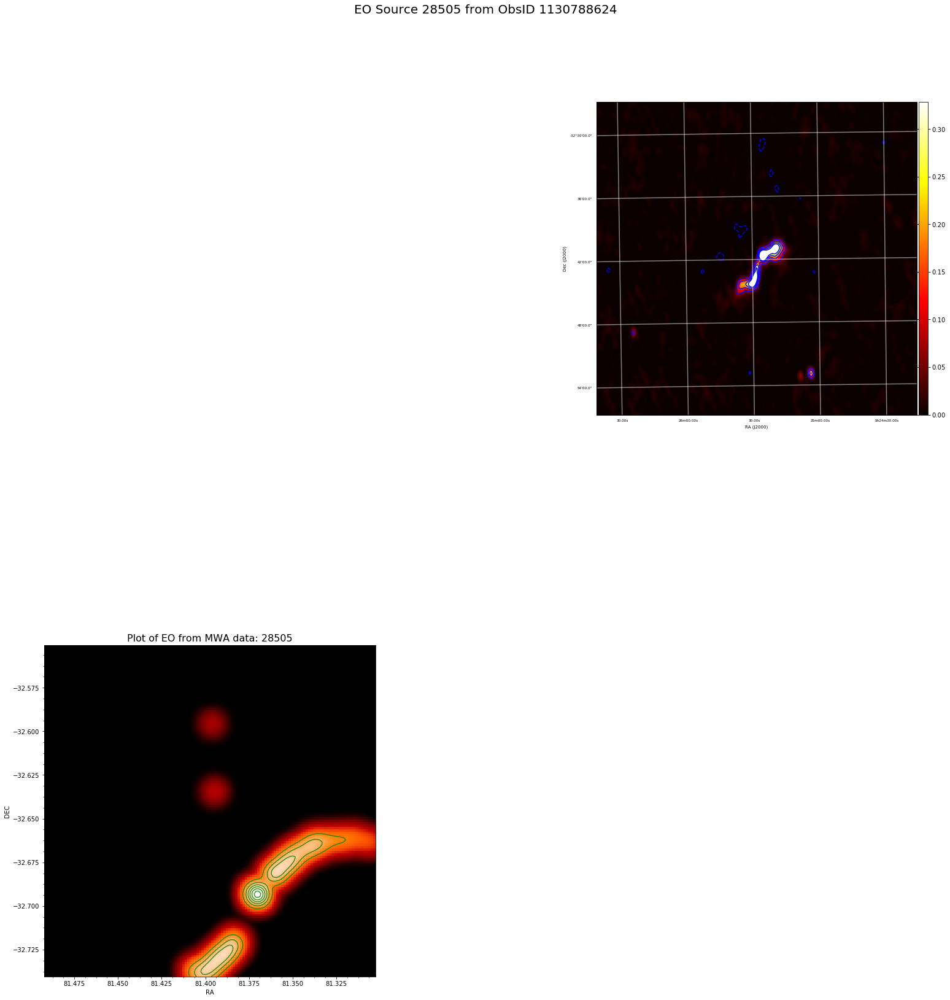

None


In [55]:
print devin(data2,'plotsfromfv/624_28721/624_28721_objfull.ps','plotsfromfv/624_28721/624_28721_rangecontours.ps',EOid=28505)

EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1] 81.3019 81.4062 -32.7411 -32.5499
x, y 0.104317 0.191151
EO_ra_zoom[0], EO_ra_zoom[1], EO_dec_zoom[0], EO_dec_zoom[1] 81.3019 81.4062 -32.7411 -32.5499
[[  3.20895256e-06   3.92154791e-06   4.52474686e-06 ...,   4.52474686e-06
    3.92154791e-06   3.20895256e-06]
 [  3.92154791e-06   4.79238560e-06   5.52953379e-06 ...,   5.52953379e-06
    4.79238560e-06   3.92154791e-06]
 [  4.52474686e-06   5.52953379e-06   6.38006757e-06 ...,   6.38006757e-06
    5.52953379e-06   4.52474686e-06]
 ..., 
 [  4.52474686e-06   5.52953379e-06   6.38006757e-06 ...,   6.38006757e-06
    5.52953379e-06   4.52474686e-06]
 [  3.92154791e-06   4.79238560e-06   5.52953379e-06 ...,   5.52953379e-06
    4.79238560e-06   3.92154791e-06]
 [  3.20895256e-06   3.92154791e-06   4.52474686e-06 ...,   4.52474686e-06
    3.92154791e-06   3.20895256e-06]]


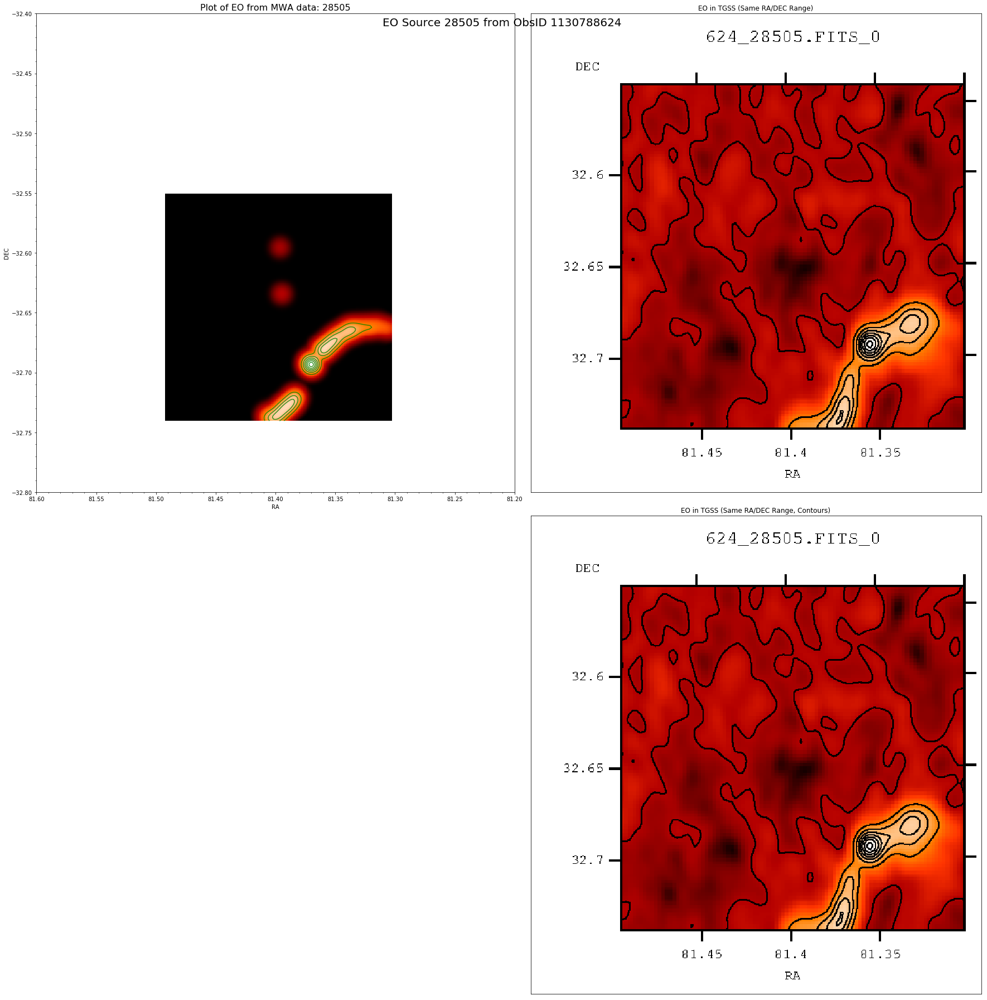

In [620]:
devin(data2,'plotsfromfv/624_28505/624_28505_objrangecont.ps','624_28721/624_28721_rangecontours.ps',EOid=28505)

ra range: (65.0919444826,65.1166774962)
dec range: (-32.2165920469,-32.1918590334)
-0.0112590789795 0.0112590789795


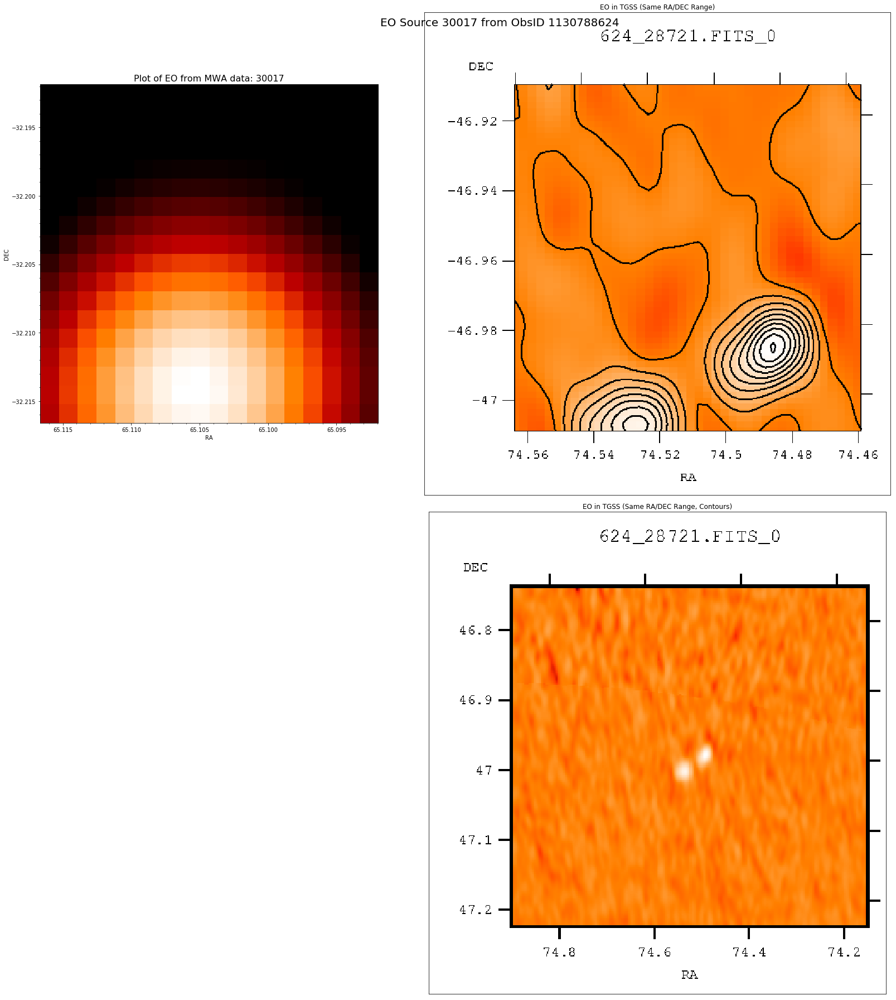

In [419]:
devin(data2,EOid=30017)

In [302]:
separ = separator(data2)
separ.keys()

['psources', 'extsources']

In [341]:
extlist = []

for i in range(len(separ['extsources'][0])):
    extlist.append('EOid {}'.format(separ['extsources'][0][i][0]))
    extlist.append('has {} components'.format(len(separ['extsources'][0][i]['extend'])))

In [342]:
extlist


['EOid 28458',
 'has 204 components',
 'EOid 28460',
 'has 65 components',
 'EOid 28463',
 'has 119 components',
 'EOid 28465',
 'has 159 components',
 'EOid 28466',
 'has 42 components',
 'EOid 28467',
 'has 62 components',
 'EOid 28470',
 'has 83 components',
 'EOid 28472',
 'has 43 components',
 'EOid 28473',
 'has 51 components',
 'EOid 28474',
 'has 65 components',
 'EOid 28475',
 'has 45 components',
 'EOid 28488',
 'has 43 components',
 'EOid 28491',
 'has 79 components',
 'EOid 28505',
 'has 69 components',
 'EOid 28525',
 'has 42 components',
 'EOid 28526',
 'has 41 components',
 'EOid 28541',
 'has 2 components',
 'EOid 28564',
 'has 56 components',
 'EOid 28566',
 'has 109 components',
 'EOid 28569',
 'has 190 components',
 'EOid 28577',
 'has 30 components',
 'EOid 28581',
 'has 34 components',
 'EOid 28582',
 'has 206 components',
 'EOid 28589',
 'has 71 components',
 'EOid 28590',
 'has 55 components',
 'EOid 28610',
 'has 69 components',
 'EOid 28627',
 'has 38 component

In [534]:
for i in range(len(separ['extsources'][0])):
    if separ['extsources'][0][i][0] == 30017:
        for j in range(len(separ['extsources'][0][i]['extend'])):
            print 'ra: {}, dec: {}'.format(separ['extsources'][0][i]['extend'][j]['ra'],separ['extsources'][0][i]['extend'][j]['dec'])
            #print separ['extsources'][0][i]['extend'][j]['dec']

ra: 65.0918502808, dec: -32.2155303955
ra: 65.0925369263, dec: -32.2160682678
ra: 65.0940246582, dec: -32.2170219421
ra: 65.0929794312, dec: -32.2173194885
ra: 65.0948867798, dec: -32.1912078857
ra: 65.091217041, dec: -32.1911315918
